## read data from files

In [3]:
import os
import wget
if os.path.isfile("utilsLaris.py")==True:
    os. remove("utilsLaris.py")
wget.download("https://raw.githubusercontent.com/Ah-essabar/LARIS01/master/utilsLaris.py")

'utilsLaris.py'

In [1]:
import janitor
import os
import glob
#import mitosheet
import ipywidgets as widgets
%matplotlib inline
# %matplotlib widget
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import utilsLaris

from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
from pandas.plotting import register_matplotlib_converters

from sklearn.model_selection import cross_val_score


# %config InlineBackend.figure_format='retina'

register_matplotlib_converters()
# sns.set(style='whitegrid', palette='muted', font_scale=1.5)

rcParams['figure.figsize'] = 22, 10

RANDOM_SEED = 42

In [2]:
import pandas as pd

#X=pd.read_csv("X_selected.csv", parse_dates=["date"], index_col="date")
y=pd.read_csv("y_selected.csv", parse_dates=["date"], index_col="date")
# y =y.rolling(window=6).mean().fillna(300)


In [3]:
#Timedelta('76 days 23:55:00')
def ts_train_test_split(X,y,test_size=0.35,random_state=42, shuffle=True, filtre = True, limite = 0):
    Xtemp, ytemp = X.copy(), y.copy()
    a= X.index - X.index[0]
    a= a.days
    Xtemp['id']=a
    ytemp['id']=a
    from sklearn.model_selection import train_test_split
    indices_train, indices_test=train_test_split(a.unique(), test_size=test_size,random_state=random_state, shuffle=shuffle)
    X_train = Xtemp[Xtemp['id'].isin(indices_train.values)]
    X_test = Xtemp[Xtemp['id'].isin(indices_test.values)]
    y_train = ytemp[ytemp['id'].isin(indices_train.values)]
    y_test = ytemp[ytemp['id'].isin(indices_test.values)]
    ####
    if filtre:
        c=y_test.groupby('id').max()>limite
        X_test = X_test.loc[y_test['id'].isin(c.index[c["elecWithoutEclairage"]])]
        y_test = y_test.loc[y_test['id'].isin(c.index[c["elecWithoutEclairage"]])]


    X_train = X_train.drop(["id"], axis=1)
    X_test = X_test.drop(["id"], axis=1)
    y_train = y_train.drop(["id"], axis=1)
    y_test = y_test.drop(["id"], axis=1)
    # print(y_test)
    
    
    return X_train, X_test, y_train, y_test

## Performance final task Random forest regressor
Target varible Electric power

In [15]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
X=pd.read_csv("./ImputedData/A_dataComplet.csv", parse_dates=["date"], index_col="date")        
X_train, X_test, y_train, y_test = ts_train_test_split(X,y,test_size=0.15,random_state=0, shuffle=True)
rfr = RandomForestRegressor(n_estimators=100, max_depth=7,max_features=0.7)
#y_train=y_train.values.ravel()
rfr.fit(X_train, y_train.values.ravel())
score = rfr.score(X_train, y_train.values.ravel())
# print("R-squared:", score) 
y_predTest = rfr.predict(X_test)
y_predTrain = rfr.predict(X_train)
rmseTest = mean_squared_error(y_test, y_predTest,squared=False)
rmseTrain = mean_squared_error(y_train, y_predTrain,squared=False)
print(rmseTrain,";",rmseTest)

53.967941190553205 ; 56.98877585171665


## deal with overfeting

In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn import svm
from sklearn.svm import SVR
import random
import time

start = time.time()

import os
directory = "ImputedData"
print("BDD",";mean_std;","score",";","rmseTrain",";"," rmseTest",";","rmseTrainFE",";","rmseTestFE")
# seed = 30
test_size = 0.20

for filename in os.listdir(directory):   
    f = os.path.join(directory, filename)
    # checking if it is a file
    if os.path.isfile(f):
        x = filename
        x = '.'.join(x.split('.')[:-1])
        X=pd.read_csv(f, parse_dates=["date"], index_col="date")        
        # X=pd.read_csv("./ImputedData/A_dataComplet.csv", parse_dates=["date"], index_col="date")
        score_,rmseTrain_,rmseTest_,rmseTrainFE_,rmseTestFE_ = [],[],[],[],[]
        for i in range(10):
            random.seed(i) 
            seed = random.randint(0, 100)
            # print("seed", seed)
            # print(seed)
            X_train, X_test, y_train, y_test = ts_train_test_split(X,y,test_size=test_size,random_state=seed, shuffle=True)
            rfr = RandomForestRegressor(n_estimators = 100,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=50)
            # rfr = make_pipeline(StandardScaler(), SVR(C=1.0, epsilon=0.2))
            #y_train=y_train.values.ravel()
            rfr.fit(X_train, y_train.values.ravel())
            
            score = rfr.score(X_train, y_train.values.ravel())
            # print("R-squared:", score) 
            y_predTest = rfr.predict(X_test)
            y_predTrain = rfr.predict(X_train)
            rmseTest = mean_squared_error(y_test, y_predTest,squared=False)
            rmseTrain = mean_squared_error(y_train, y_predTrain,squared=False)


            X_selectedFeatured, y_selectedFeatured =utilsLaris.FeatureExtraction(X,y, period = '30T')
            X_train, X_test, y_train, y_test = ts_train_test_split(X_selectedFeatured,y_selectedFeatured,test_size=test_size, random_state=seed,shuffle=True)
            rfr = RandomForestRegressor(n_estimators = 100,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=100)  
            # rfr = make_pipeline(StandardScaler(), SVR(C=1.0, epsilon=0.2))
            #y_train=y_train.values.ravel()
            rfr.fit(X_train, y_train.values.ravel())
            scoreFE = rfr.score(X_train, y_train.values.ravel())
            # print("R-squared:", score) 
            y_predTest= rfr.predict(X_test)
            y_predTrain= rfr.predict(X_train)
            rmseTestFE = mean_squared_error(y_test, y_predTest,squared=False)
            rmseTrainFE = mean_squared_error(y_train, y_predTrain,squared=False)
            score_.append(score)
            rmseTrain_.append(rmseTrain)
            rmseTest_.append(rmseTest)
            rmseTrainFE_.append(rmseTrainFE)
            rmseTestFE_.append(rmseTestFE)


        print(x,";mean;",np.mean(score_),";",np.mean(rmseTrain_),";", np.mean(rmseTest_),";",np.mean(rmseTrainFE_),";",np.mean(rmseTestFE_))
        print(x,";std;",np.std(score_),";",np.std(rmseTrain_),";", np.std(rmseTest_),";",np.std(rmseTrainFE_),";",np.std(rmseTestFE_))

end = time.time()
print(end - start)

## Aperçu des variables

In [28]:
# Plot
y=pd.read_csv("y_selected.csv", parse_dates=["date"], index_col="date")
X=pd.read_csv("X_selected.csv", parse_dates=["date"], index_col="date")
df =pd.concat([X,y], axis=1)
colors=["blue","orange","blue","orange","blue","orange","blue","purple","blue","blue","purple","purple","orange","purple","purple","purple","green"]
fig, axes = plt.subplots(nrows=9, ncols=2, dpi=300, figsize=(30,30))
mylist = [r'$CO_2$ 100 [ppm]',
             r'Température 100 [°C]',
             r'$CO_2$ 101 [ppm]',
             r'Température 101 [°C]',
             r'$CO_2$ 102 [ppm]',
             r'Température 105 [°C]',
             r'$CO_2$ 106 [ppm]',r'Luminosité 106 [∝ lux]',
             r'$CO_2$ 107 [ppm]',
             r'$CO_2$ 108 [ppm]',
             r'Bruit 108 [∝dB]',
            r'Humidité 110 [%]',
             r'Température extérieure [°C]',
             r'Humidité extérieure [%]',
            r'Pression extérieure [hPa]',
           r'Windows [nombre de fenêtres ouvertes]',
          r'Puissance électrique [w]',
          
             '']


for i, ax in enumerate(axes.flatten()):
    if i<17: 
        data = df[df.columns[i]]
        ax.plot(data, color=colors[i], linewidth=2)
        #ax.yticks()
        #plt.ylabel("coucou")
        # Decorations
        ax.set_title(mylist[i])
        # ax.xaxis.set_ticks_position('both')
        # ax.yaxis.set_ticks_position('both')       
        # # ax.spines["top"].set_alpha(1)
        # # ax.tick_params(labelsize=0.2)

# plt.tight_layout()

In [15]:
df.columns

Index(['co2_100', 'temperature_100', 'co2_101', 'temperature_101', 'co2_102',
       'temperature_105', 'co2_106', 'light_106', 'co2_107', 'co2_108',
       'sound_108', 'humidity_110', 'weather_out', 'weather_hum',
       'weather_bar_', 'windows', 'elecWithoutEclairage'],
      dtype='object')

In [ ]:
['co2_100', 'temperature_100', 'co2_101', 'temperature_101', 'co2_102',
       'temperature_105', 'co2_106', 'light_106', 'co2_107', 'co2_108',
       'sound_108', 'humidity_110', 'weather_out', 'weather_hum',
       'weather_bar_', 'windows', 'elecWithoutEclairage']

In [13]:
colors=["blue","orange","blue","orange","blue","orange","blue","purple","blue","blue","purple","purple","blue","purple","purple","purple","green"]

Index(['co2_100', 'temperature_100', 'co2_101', 'temperature_101', 'co2_102',
       'temperature_105', 'co2_106', 'light_106', 'co2_107', 'co2_108',
       'sound_108', 'humidity_110', 'weather_out', 'weather_hum',
       'weather_bar_', 'windows', 'elecWithoutEclairage'],
      dtype='object')

<AxesSubplot:xlabel='date'>

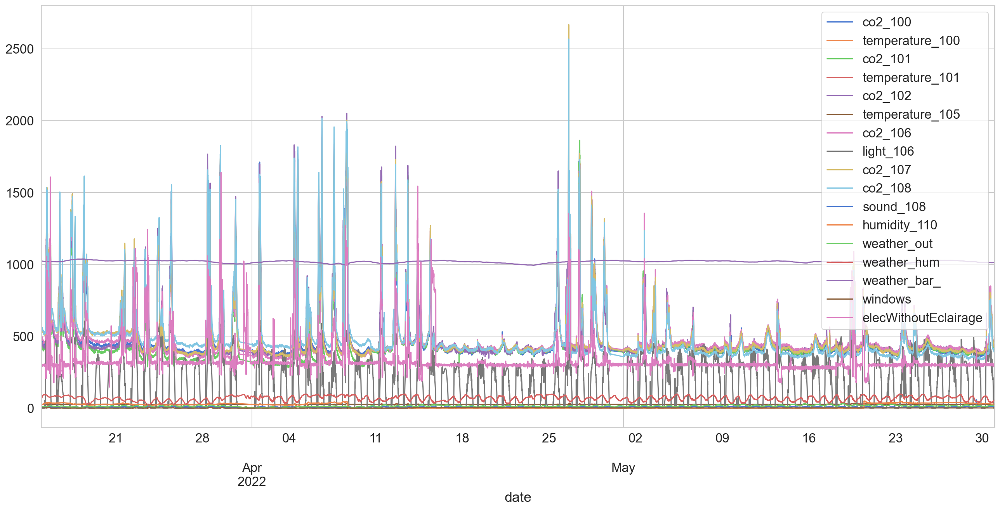

In [31]:
df.plot()

In [24]:
axes.flatten()

array([<AxesSubplot:title={'center':'co2_100'}>,
       <AxesSubplot:title={'center':'temperature_100'}>,
       <AxesSubplot:title={'center':'co2_101'}>,
       <AxesSubplot:title={'center':'temperature_101'}>,
       <AxesSubplot:title={'center':'co2_102'}>,
       <AxesSubplot:title={'center':'temperature_105'}>,
       <AxesSubplot:title={'center':'co2_106'}>,
       <AxesSubplot:title={'center':'light_106'}>,
       <AxesSubplot:title={'center':'co2_107'}>,
       <AxesSubplot:title={'center':'co2_108'}>,
       <AxesSubplot:title={'center':'sound_108'}>,
       <AxesSubplot:title={'center':'humidity_110'}>,
       <AxesSubplot:title={'center':'weather_out'}>,
       <AxesSubplot:title={'center':'weather_hum'}>,
       <AxesSubplot:title={'center':'weather_bar_'}>,
       <AxesSubplot:title={'center':'windows'}>,
       <AxesSubplot:title={'center':'elecWithoutEclairage'}>,
       <AxesSubplot:>], dtype=object)

In [42]:
# Importing libraries

import statsmodels.api as sm

from statsmodels.tsa.api import VAR

import numpy as np

import pandas

# Importing macrodata dataset from statsmodel library in the form of pandas dataframe
# data = sm.datasets.macrodata.load_pandas()
# # Storing data
# X = data.data
# # Filtering columns
# X = X[['realgdp','realcons','realinv']]
# Taking log
# X = np.log(X).diff().dropna()
# Creating a VAR model
model = VAR(X)
# Fitting the model
model_summary = model.fit()
# Summary
model_summary.summary()

C:\Users\ahmed\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:471: ValueWarning: No frequency information was provided, so inferred frequency 5T will be used.
  self._init_dates(dates, freq)


  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Thu, 23, Jun, 2022
Time:                     12:14:29
--------------------------------------------------------------------
No. of Equations:         17.0000    BIC:                    18.3054
Nobs:                     22175.0    HQIC:                   18.2309
Log likelihood:          -736335.    FPE:                7.97936e+07
AIC:                      18.1950    Det(Omega_mle):     7.87005e+07
--------------------------------------------------------------------
Results for equation co2_100
                             coefficient       std. error           t-stat            prob
------------------------------------------------------------------------------------------
const                          75.780692        23.694002            3.198           0.001
L1.co2_100                      0.660008         0.007929           83.238           0.000
L1.temperature_100

In [94]:
y.mean()

elecWithoutEclairage    341.622915
dtype: float64

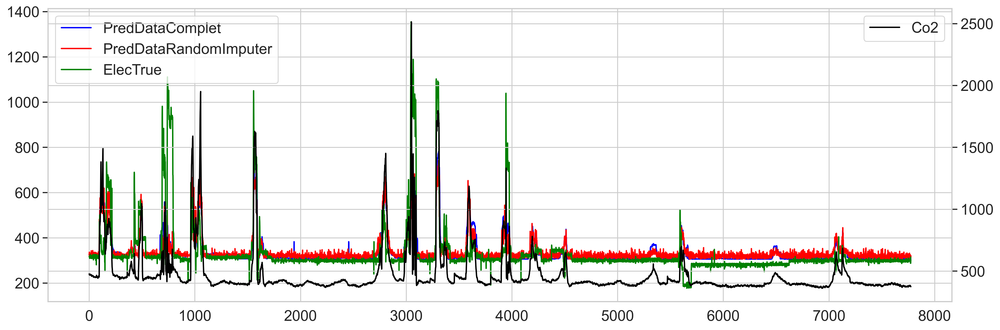

In [17]:
%matplotlib widget
%matplotlib inline
from matplotlib.pyplot import figure

from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
#X=pd.read_csv("X_selected.csv", parse_dates=["date"], index_col="date")
y=pd.read_csv("y_selected.csv", parse_dates=["date"], index_col="date")
# y =y.rolling(window=10).mean().fillna(300)
XC=pd.read_csv("./ImputedData/A_DataComplet.csv", parse_dates=["date"], index_col="date")
XR=pd.read_csv("./ImputedData/RandomImputer_MAR60.csv", parse_dates=["date"], index_col="date") 
# XC,_ =lagged(XC,lag=3)
# XR,_ =lagged(XR,lag=3)
# y,_ =lagged(y,lag=3)
# y= y.drop(['elecWithoutEclairage_t-1', 'elecWithoutEclairage_t-2',"elecWithoutEclairage_t-3"], axis=1)

test_size = 0.35
random_state=0
X_trainC, X_testC, y_trainC, y_testC = ts_train_test_split(XC,y,test_size=test_size,random_state=random_state, shuffle=True)
rfrC = RandomForestRegressor(n_estimators = 100,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=100)
X_co2 = X_testC['co2_100']

X_trainR, X_testR, y_trainR, y_testR = ts_train_test_split(XR,y,test_size=test_size,random_state=random_state, shuffle=True)
rfrR = RandomForestRegressor(n_estimators = 100,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=100) 
# rfr = make_pipeline(StandardScaler(), SVR(C=1.0, epsilon=0.2))
#y_train=y_train.values.ravel()
rfrC.fit(X_trainC, y_trainC.values.ravel())
rfrR.fit(X_trainR, y_trainR.values.ravel())
y_predTestC = rfrC.predict(X_testC)
y_predTestR = rfrR.predict(X_testR)
# figure(figsize=(25, 10), dpi=300)

fig, ax1 = plt.subplots(figsize=(18, 6), dpi=180)
plt.plot(y_predTestC, c='blue', label='PredDataComplet')
plt.plot(y_predTestR, c='red', label='PredDataRandomImputer')
plt.plot(y_testC.values, c='green', label='ElecTrue')
ax1.legend(loc='upper left')
ax2 = ax1.twinx()
plt.plot(X_co2.values, c='black', label='Co2')
ax2.legend(loc='best')


In [5]:
def lagged(df,lag=3):
    # df=df.set_index('date')    
    Df=[]
    a=[]
    for i in range(lag):
        a.append(i)
        df1=df.shift(i+1).copy()
        df1=df1.add_suffix('_t-'+str(i+1))
        Df.append(df1)
    for base in Df:
        df=pd.concat([df,base], axis=1)
    
    df=df.drop(df.index[a])
    return df, a 

# Création de jour de semaine (d.isoweekday()) et l'heure de la journée (d.hour+d.minute/60) à partire de timestamp
# import datetime
# Jsemaine =[]
# heure=[]
# for t in data.index:
#     d=datetime.datetime.fromtimestamp(t)
#     Jsemaine.append(d.isoweekday())
#     heure.append(d.hour+d.minute/60)

In [68]:
df,_ =lagged(X,lag=3)

In [70]:
df.columns

Index(['co2_100', 'temperature_100', 'co2_101', 'temperature_101', 'co2_102',
       'temperature_105', 'co2_106', 'light_106', 'co2_107', 'co2_108',
       'sound_108', 'humidity_110', 'weather_out', 'weather_hum',
       'weather_bar_', 'windows', 'co2_100_t-1', 'temperature_100_t-1',
       'co2_101_t-1', 'temperature_101_t-1', 'co2_102_t-1',
       'temperature_105_t-1', 'co2_106_t-1', 'light_106_t-1', 'co2_107_t-1',
       'co2_108_t-1', 'sound_108_t-1', 'humidity_110_t-1', 'weather_out_t-1',
       'weather_hum_t-1', 'weather_bar__t-1', 'windows_t-1', 'co2_100_t-2',
       'temperature_100_t-2', 'co2_101_t-2', 'temperature_101_t-2',
       'co2_102_t-2', 'temperature_105_t-2', 'co2_106_t-2', 'light_106_t-2',
       'co2_107_t-2', 'co2_108_t-2', 'sound_108_t-2', 'humidity_110_t-2',
       'weather_out_t-2', 'weather_hum_t-2', 'weather_bar__t-2', 'windows_t-2',
       'co2_100_t-3', 'temperature_100_t-3', 'co2_101_t-3',
       'temperature_101_t-3', 'co2_102_t-3', 'temperature_105_

In [52]:
y =y.rolling(window=6).mean().fillna(300)

In [53]:
y

,elecWithoutEclairage
date,
2022-03-15 00:15:00,300.000000
2022-03-15 00:20:00,300.000000
2022-03-15 00:25:00,300.000000
2022-03-15 00:30:00,300.000000
2022-03-15 00:35:00,300.000000
...,...
2022-05-30 23:35:00,299.896000
2022-05-30 23:40:00,299.838000
2022-05-30 23:45:00,299.600667


In [ ]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn import svm
from sklearn.svm import SVR
import random
import time
import pandas as pd

#Timedelta('76 days 23:55:00')
def ts_train_test_split(X,y,test_size=0.35,random_state=42, shuffle=True, filtre = False, limite = 0):
    Xtemp, ytemp = X.copy(), y.copy()
    a= X.index - X.index[0]
    a= a.days
    Xtemp['id']=a
    ytemp['id']=a
    from sklearn.model_selection import train_test_split
    indices_train, indices_test=train_test_split(a.unique(), test_size=test_size,random_state=random_state, shuffle=shuffle)
    X_train = Xtemp[Xtemp['id'].isin(indices_train.values)]
    X_test = Xtemp[Xtemp['id'].isin(indices_test.values)]
    y_train = ytemp[ytemp['id'].isin(indices_train.values)]
    y_test = ytemp[ytemp['id'].isin(indices_test.values)]
    ####
    if filtre:
        c=y_test.groupby('id').max()>limite
        X_test = X_test.loc[y_test['id'].isin(c.index[c["elecWithoutEclairage"]])]
        y_test = y_test.loc[y_test['id'].isin(c.index[c["elecWithoutEclairage"]])]


    X_train = X_train.drop(["id"], axis=1)
    X_test = X_test.drop(["id"], axis=1)
    y_train = y_train.drop(["id"], axis=1)
    y_test = y_test.drop(["id"], axis=1)
    # print(y_test)
    
    
    return X_train, X_test, y_train, y_test
#################################################################### Rolling #################################################################################################

windows = 5
#X=pd.read_csv("X_selected.csv", parse_dates=["date"], index_col="date")
y=pd.read_csv("y_selected.csv", parse_dates=["date"], index_col="date")
y =y.rolling(window=windows).mean().dropna()
start = time.time()

import os
directory = "ImputedData"
print("BDD",";mean_std;","score",";","rmseTrain",";"," rmseTest",";","rmseTrainFE",";","rmseTestFE")
seeds = []
test_size = 0.25
for i in range(10):
    seeds.append(random.randint(0, 50))
print(seeds)    
    

for filename in os.listdir(directory):   
    f = os.path.join(directory, filename)
    # checking if it is a file
    if os.path.isfile(f):
        x = filename
        x = '.'.join(x.split('.')[:-1])
        X=pd.read_csv(f, parse_dates=["date"], index_col="date")
        X=X.rolling(window=windows).mean().dropna()
        # X=pd.read_csv("./ImputedData/A_dataComplet.csv", parse_dates=["date"], index_col="date")
        score_,rmseTrain_,rmseTest_,rmseTrainFE_,rmseTestFE_ = [],[],[],[],[]
        
        for seed in seeds:
             
            # seed = random.randint(0, 1000)
            # print(seed)
            X_train, X_test, y_train, y_test = ts_train_test_split(X,y,test_size=test_size,random_state=seed, shuffle=True)
            rfr = RandomForestRegressor(n_estimators = 1000,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=100)      

            # rfr = make_pipeline(StandardScaler(), SVR(C=1.0, epsilon=0.2))

            #y_train=y_train.values.ravel()
            rfr.fit(X_train, y_train.values.ravel())
            score = rfr.score(X_train, y_train.values.ravel())
            # print("R-squared:", score) 
            y_predTest = rfr.predict(X_test)
            y_predTrain = rfr.predict(X_train)
            rmseTest = mean_squared_error(y_test, y_predTest,squared=False)
            rmseTrain = mean_squared_error(y_train, y_predTrain,squared=False)


            X_selectedFeatured, y_selectedFeatured =utilsLaris.FeatureExtraction(X,y, period = '30T')
            X_train, X_test, y_train, y_test = ts_train_test_split(X_selectedFeatured,y_selectedFeatured,test_size=test_size,random_state=seed, shuffle=True)
            rfr = RandomForestRegressor(n_estimators = 1000,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=100)  
            # rfr = make_pipeline(StandardScaler(), SVR(C=1.0, epsilon=0.2))
            #y_train=y_train.values.ravel()
            rfr.fit(X_train, y_train.values.ravel())
            scoreFE = rfr.score(X_train, y_train.values.ravel())
            # print("R-squared:", score) 
            y_predTest= rfr.predict(X_test)
            y_predTrain= rfr.predict(X_train)
            rmseTestFE = mean_squared_error(y_test, y_predTest,squared=False)
            rmseTrainFE = mean_squared_error(y_train, y_predTrain,squared=False)
            score_.append(score)
            rmseTrain_.append(rmseTrain)
            rmseTest_.append(rmseTest)
            rmseTrainFE_.append(rmseTrainFE)
            rmseTestFE_.append(rmseTestFE)


        print(x,";mean;",np.mean(score_),";",np.mean(rmseTrain_),";", np.mean(rmseTest_),";",np.mean(rmseTrainFE_),";",np.mean(rmseTestFE_))
        print(x,";std;",np.std(score_),";",np.std(rmseTrain_),";", np.std(rmseTest_),";",np.std(rmseTrainFE_),";",np.std(rmseTestFE_))

end = time.time()
print(end - start)

## VF

BDD ;mean_std; score ; rmseTrain ;  rmseTest ; rmseTrainFE ; rmseTestFE


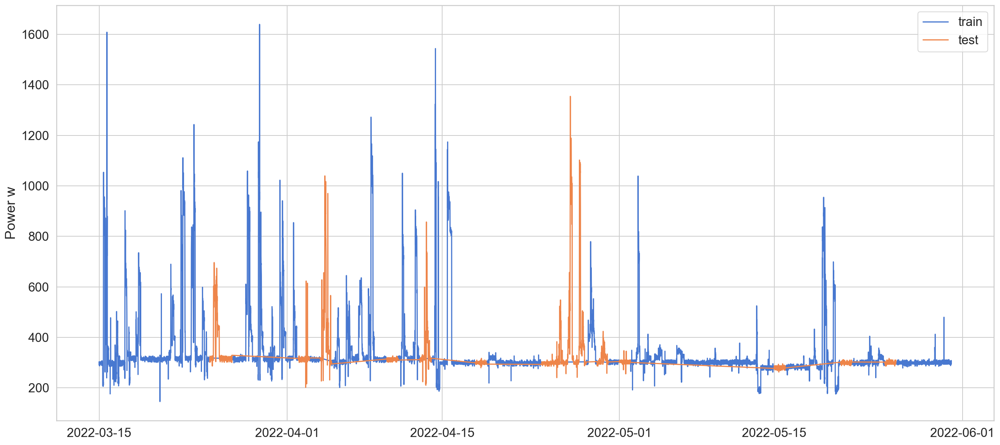

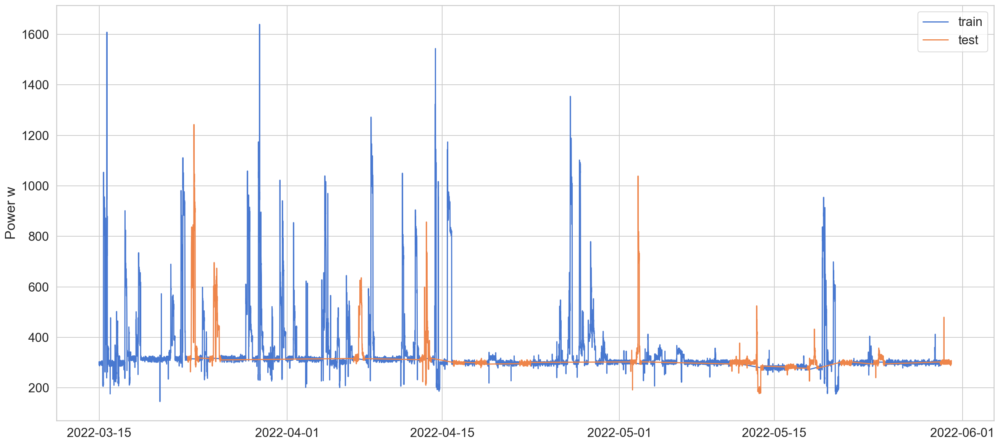

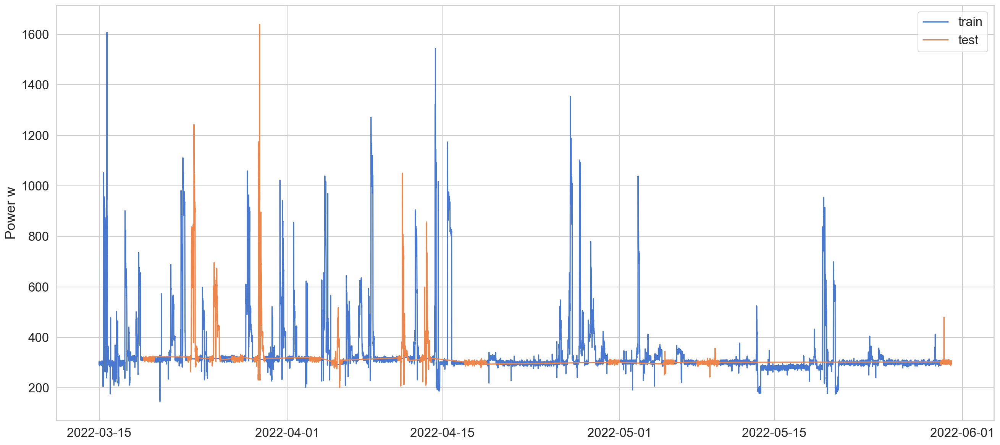

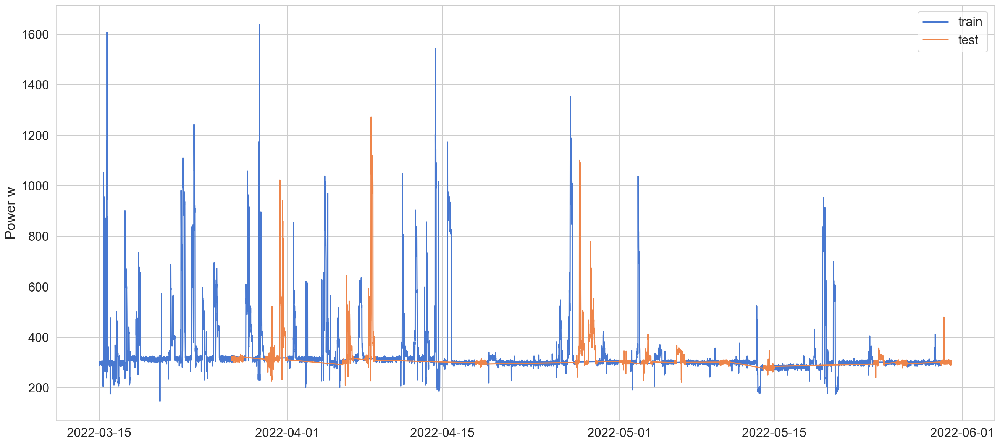

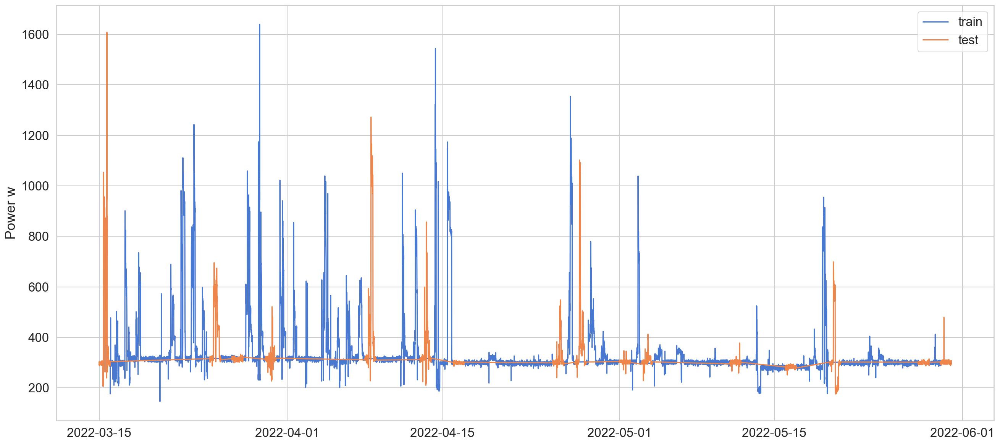

...

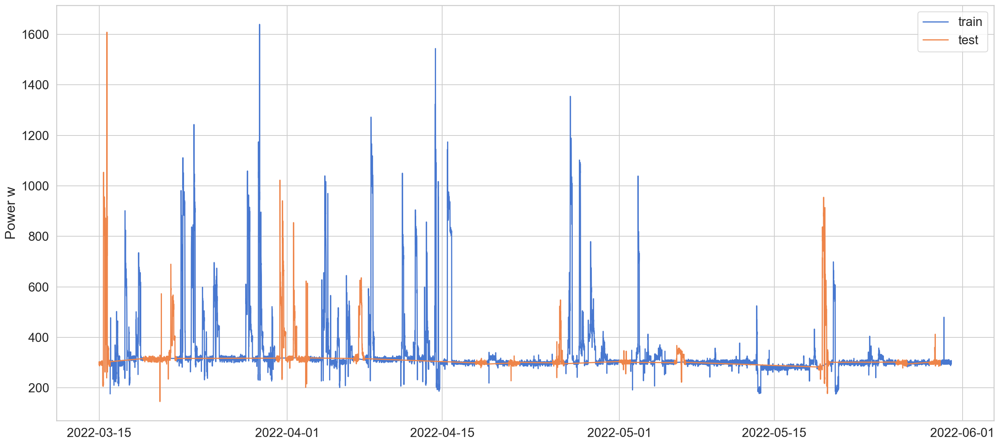

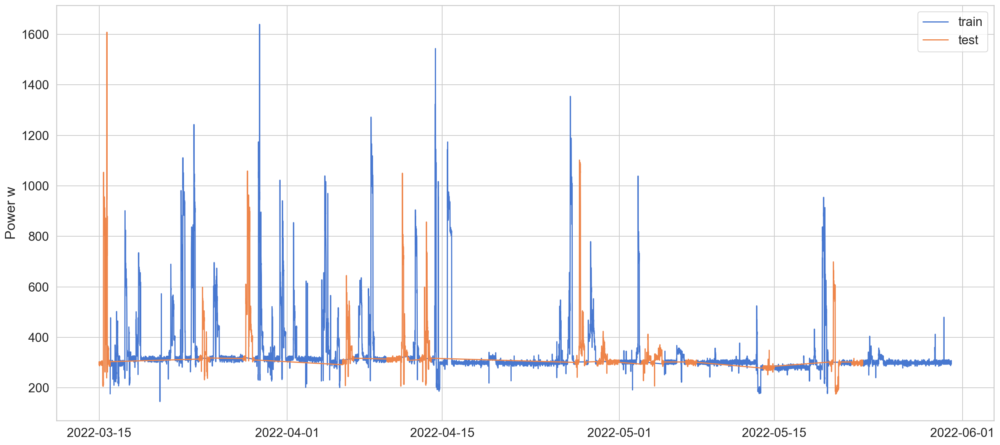

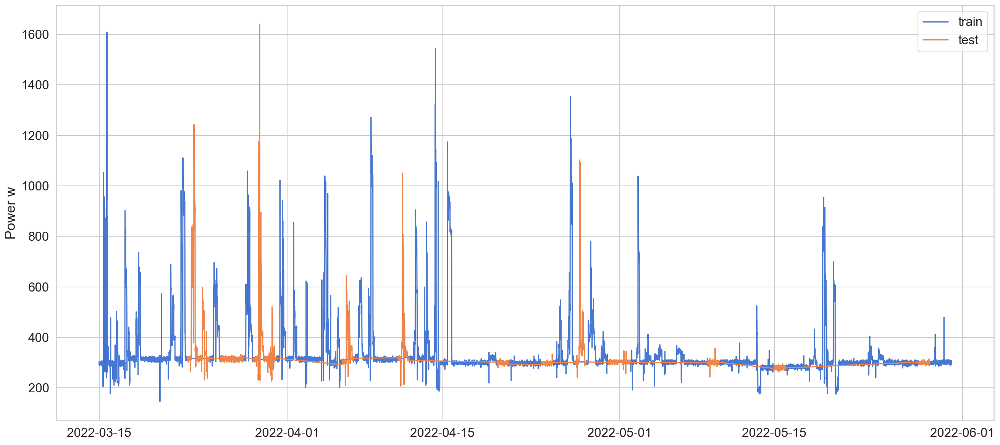

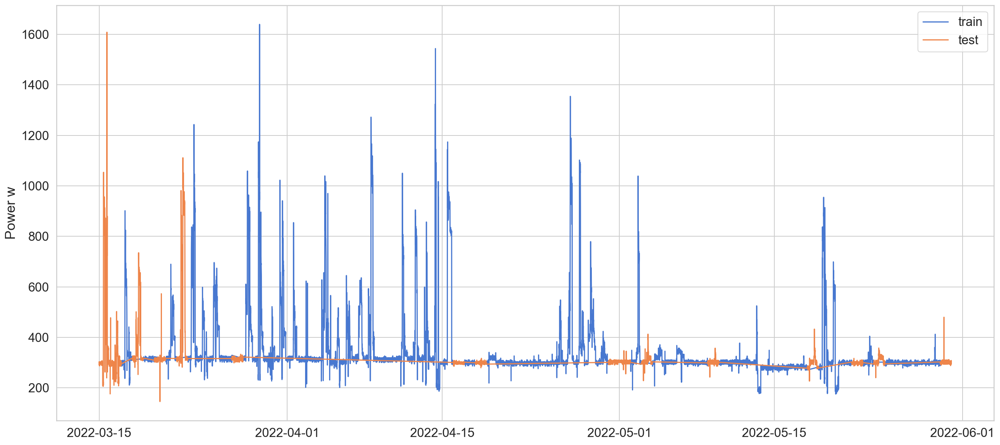

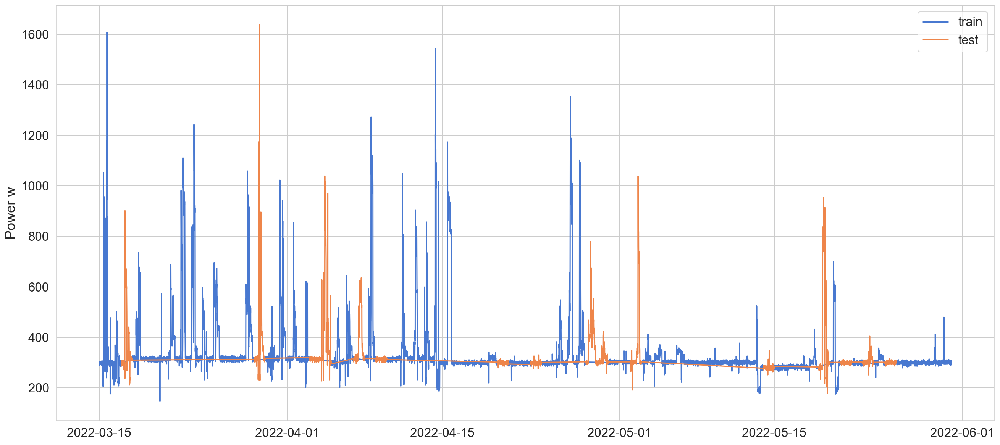

A_DataComplet ;mean; 0.6254822348886571 ; 78.94042136338217 ; 84.39141273477516 ; 71.41755144129318 ; 76.28726286967581
A_DataComplet ;std; 0.01348164312452268 ; 1.1426187001499049 ; 4.09206183617392 ; 1.2092731127500533 ; 5.855116647674841


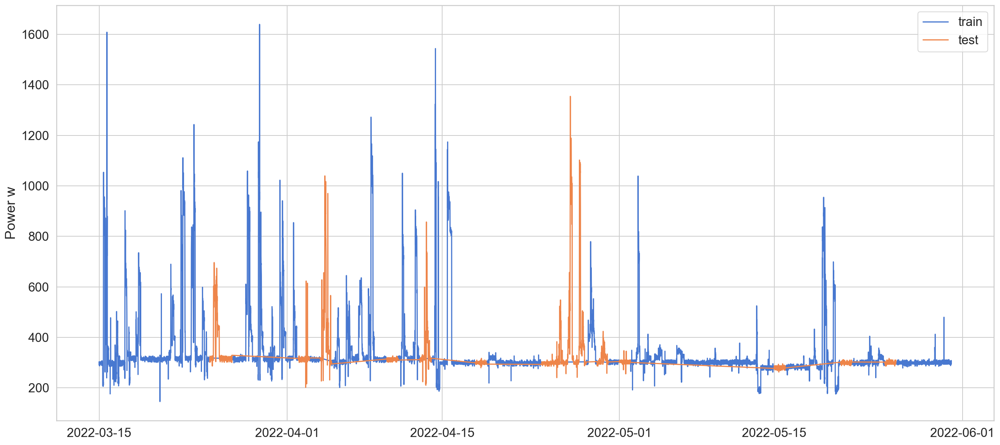

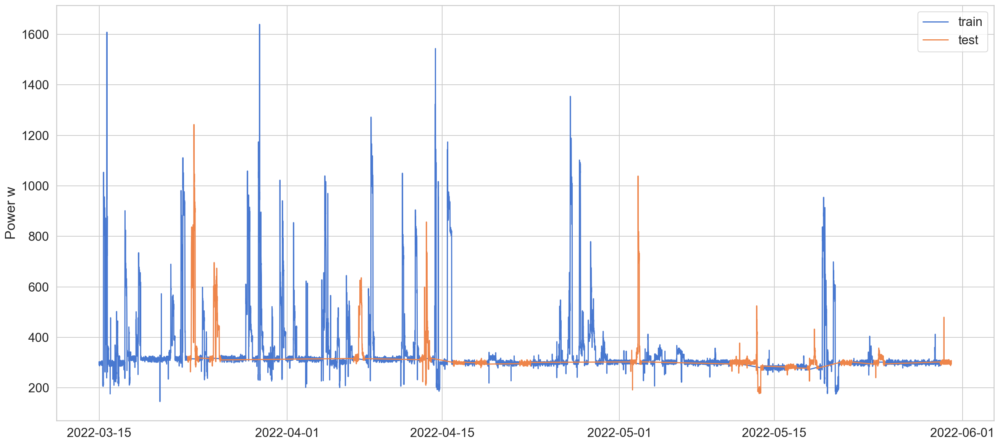

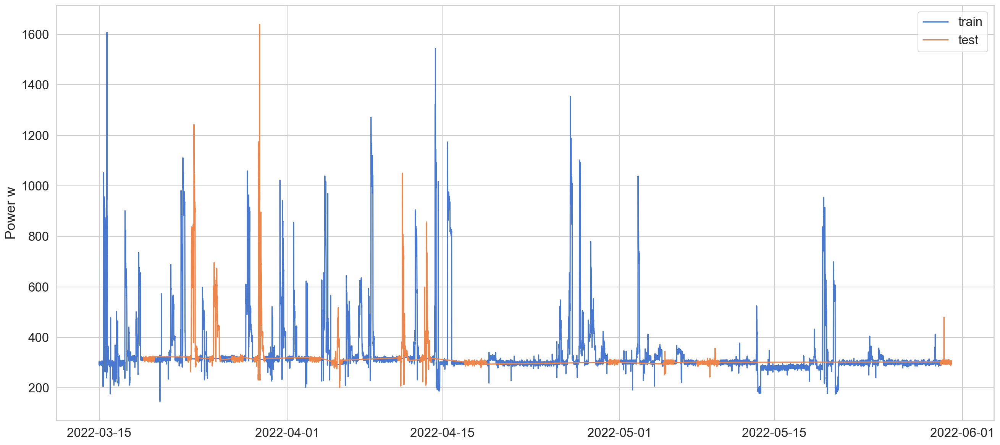

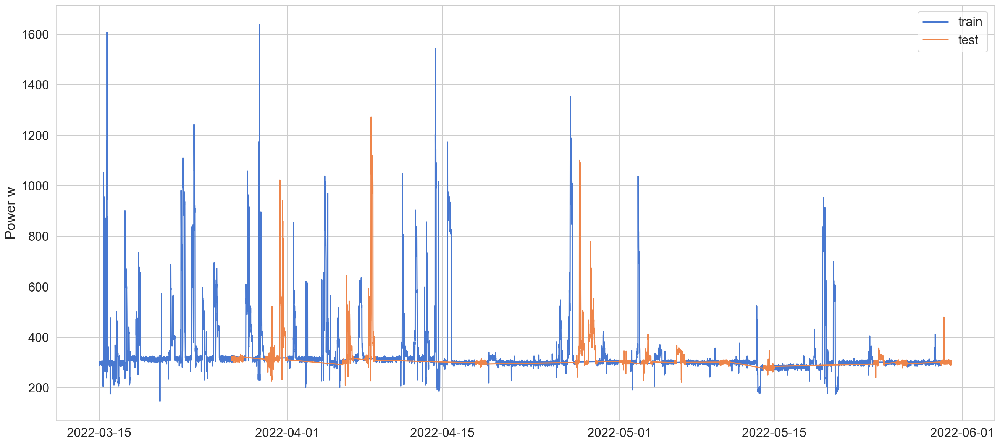

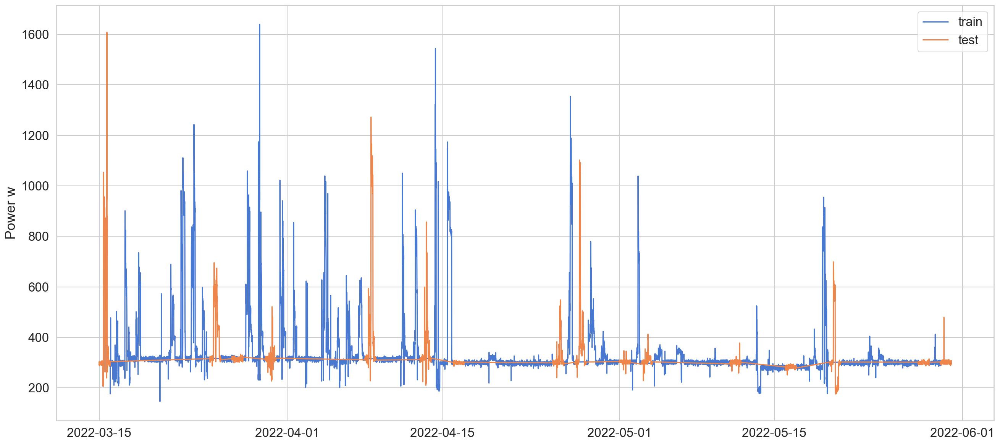

...

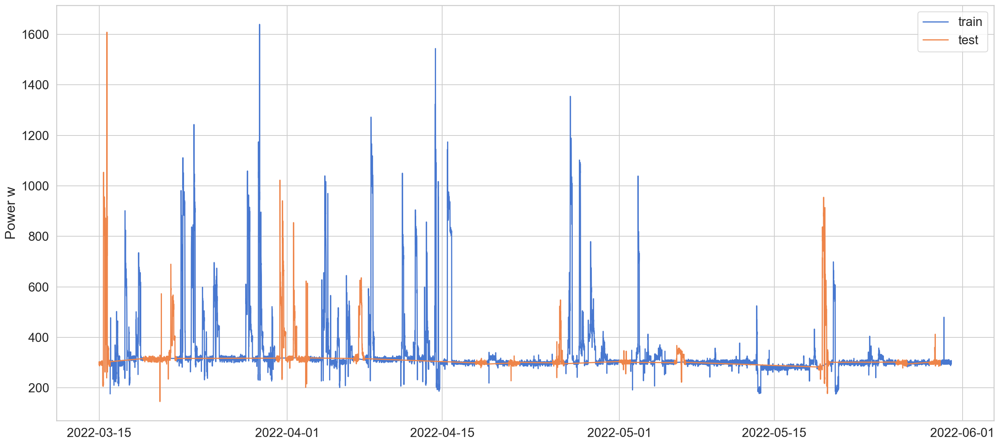

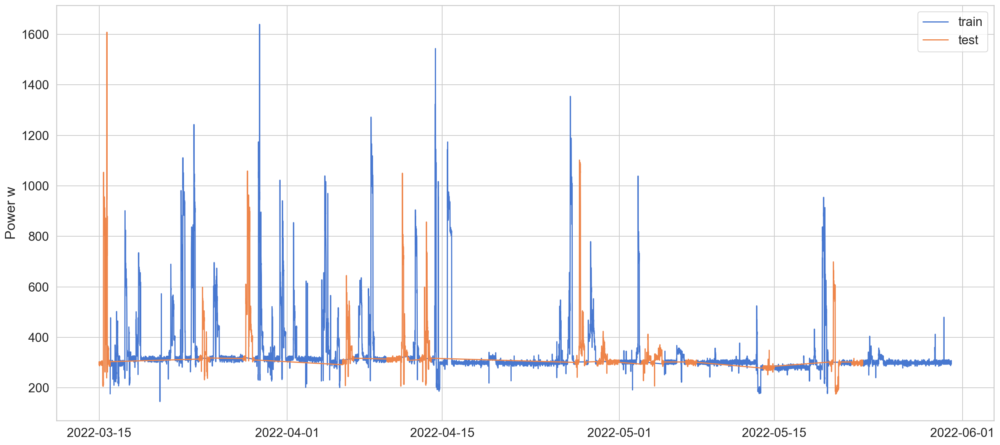

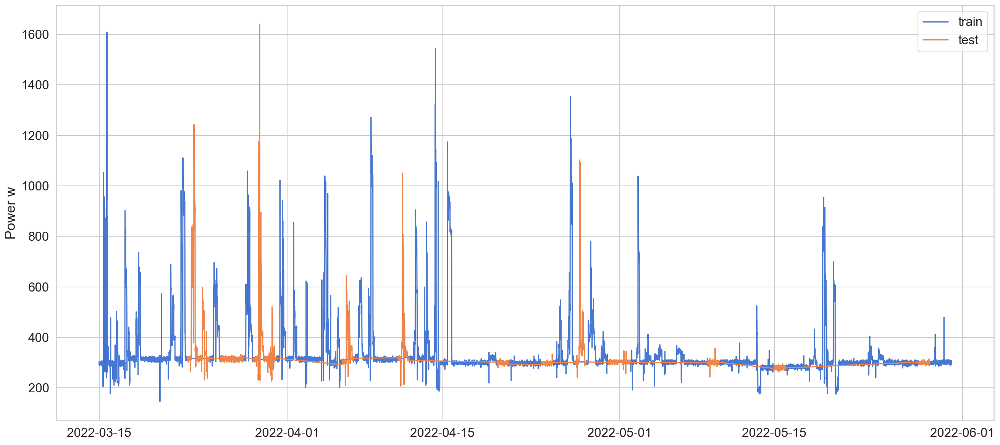

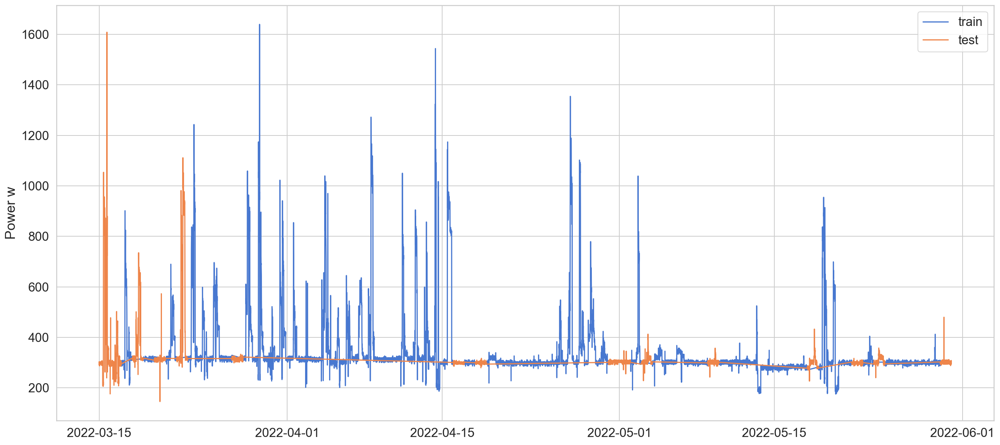

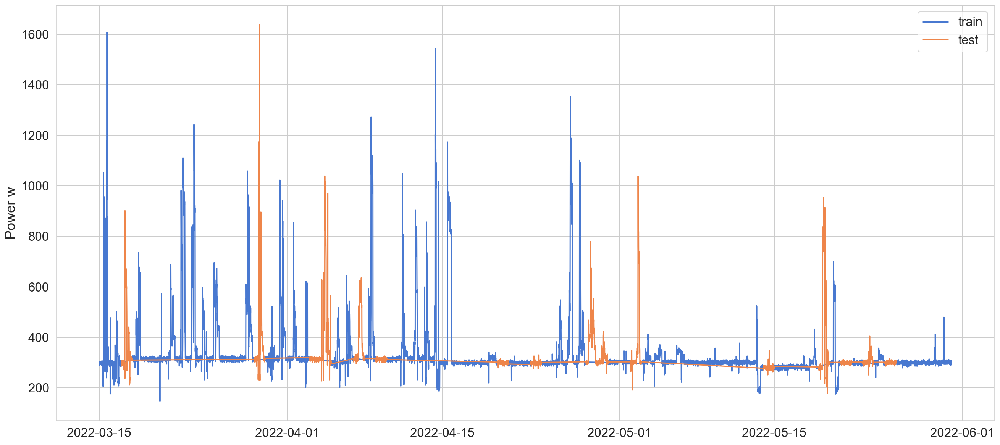

Back_fillMAR05 ;mean; 0.6405370695200951 ; 77.33167227945192 ; 82.92872910148795 ; 71.00826793610331 ; 74.888468269536
Back_fillMAR05 ;std; 0.014372294841382196 ; 1.1045975900658809 ; 4.013120599992228 ; 1.1118019730902173 ; 6.04135192574242


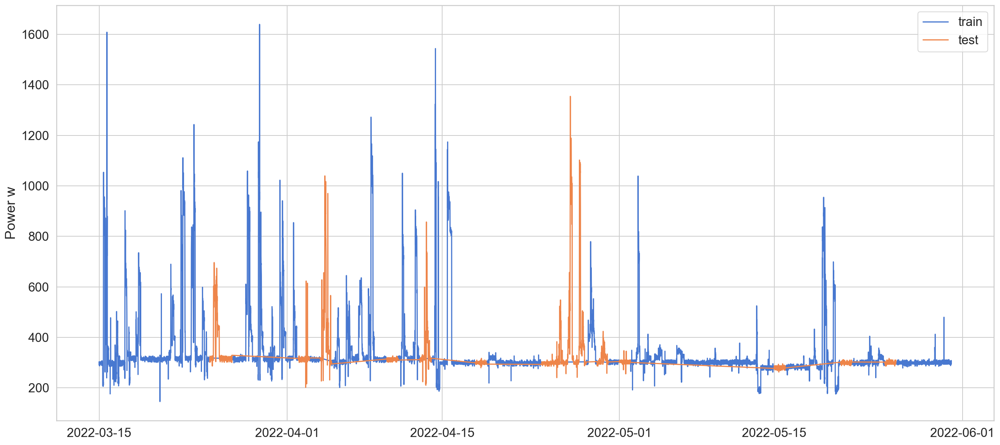

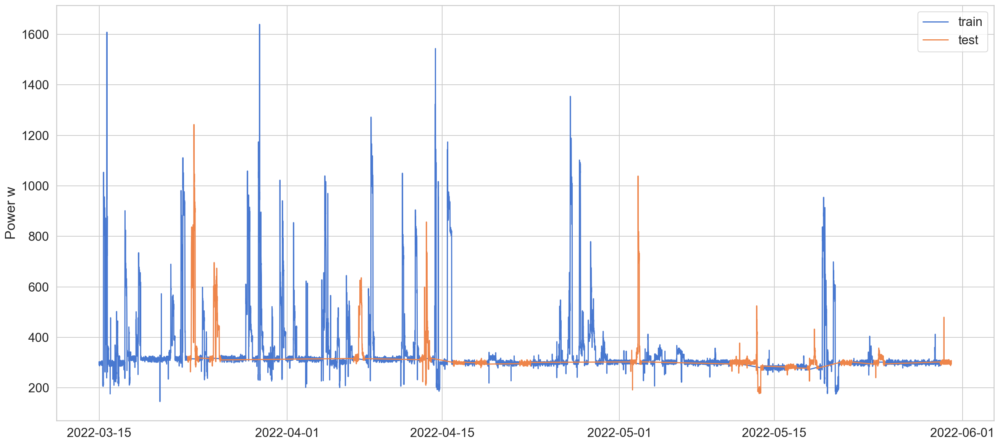

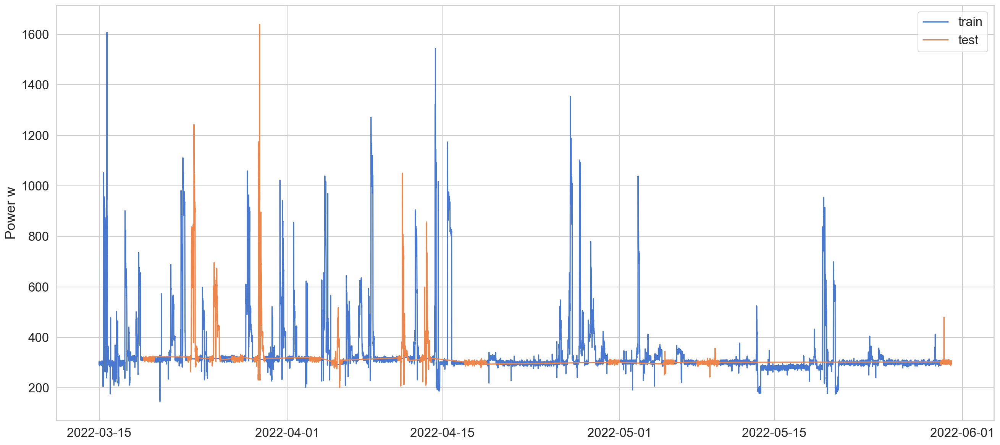

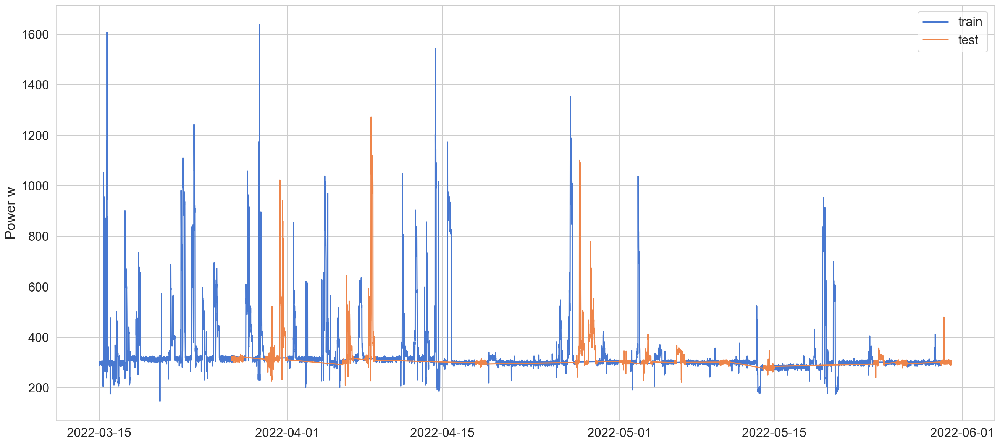

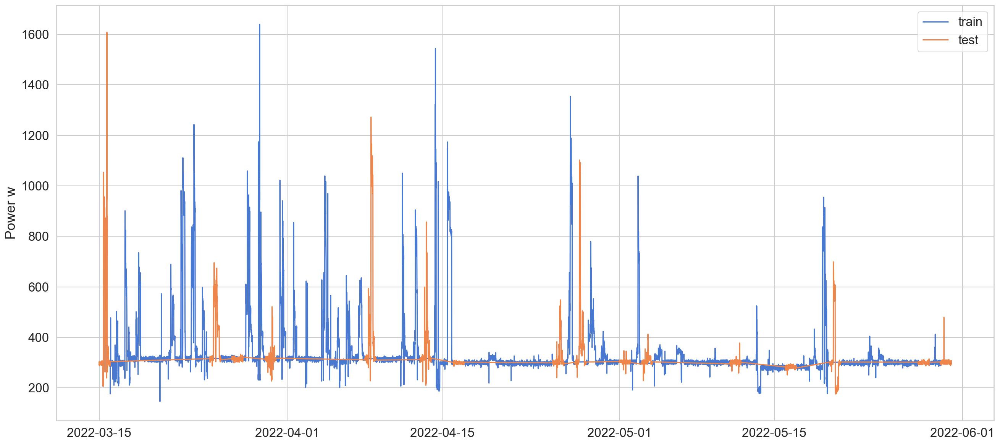

...

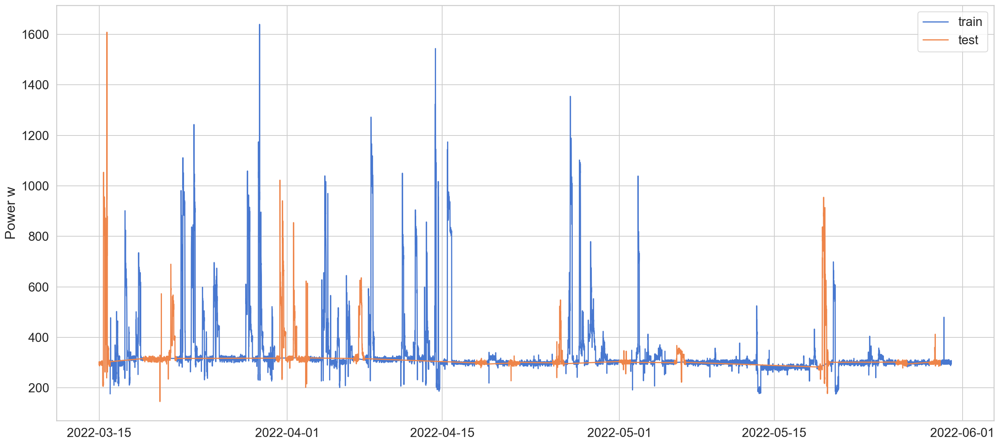

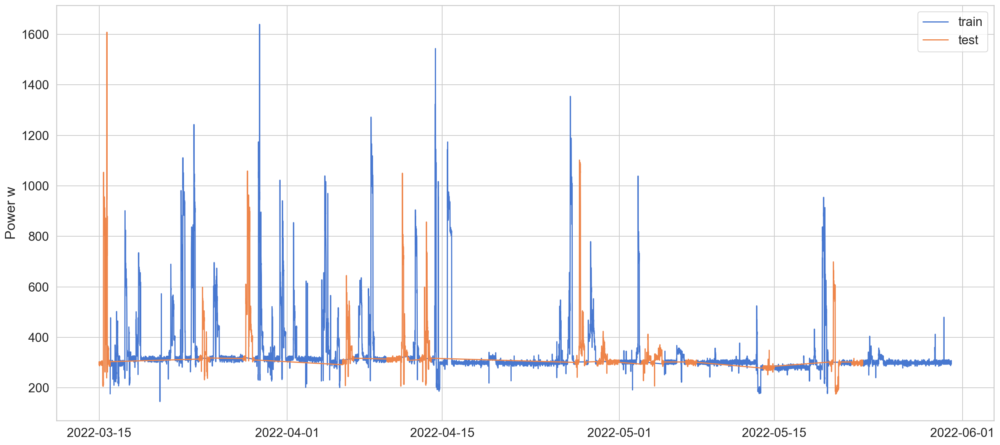

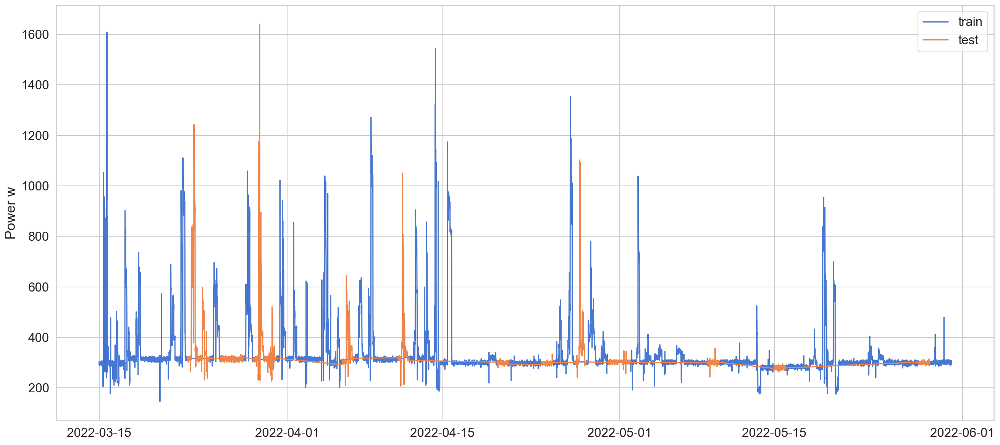

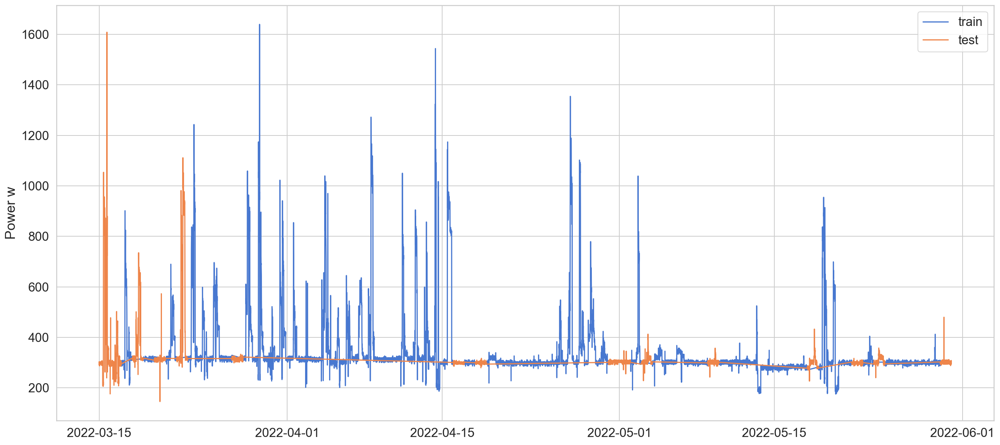

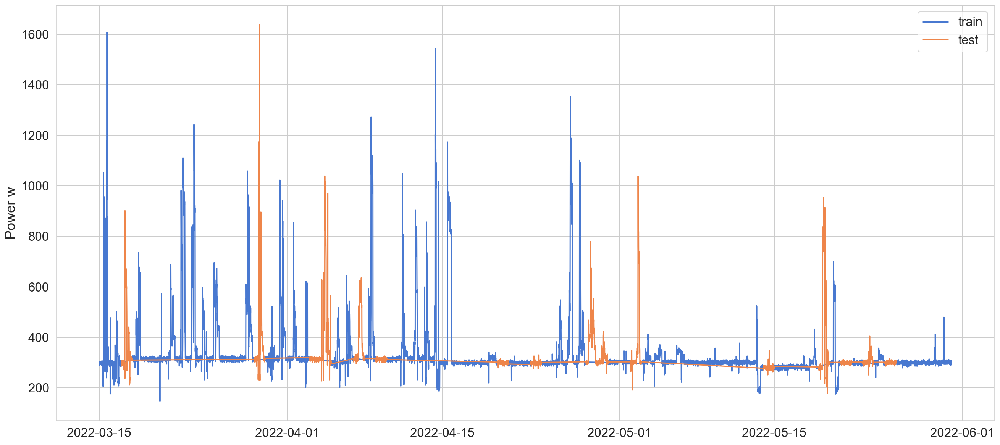

Back_fillMAR10 ;mean; 0.629770660109813 ; 78.49684851113464 ; 84.1321726202495 ; 71.54389409247862 ; 75.88745186955627
Back_fillMAR10 ;std; 0.010457507475382592 ; 1.134794243866277 ; 3.637012403466686 ; 1.2719809996044469 ; 5.9026936969784565


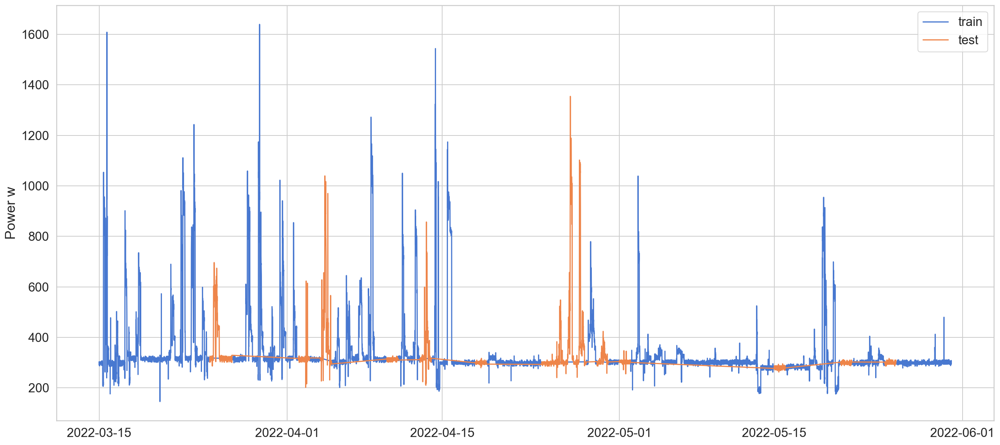

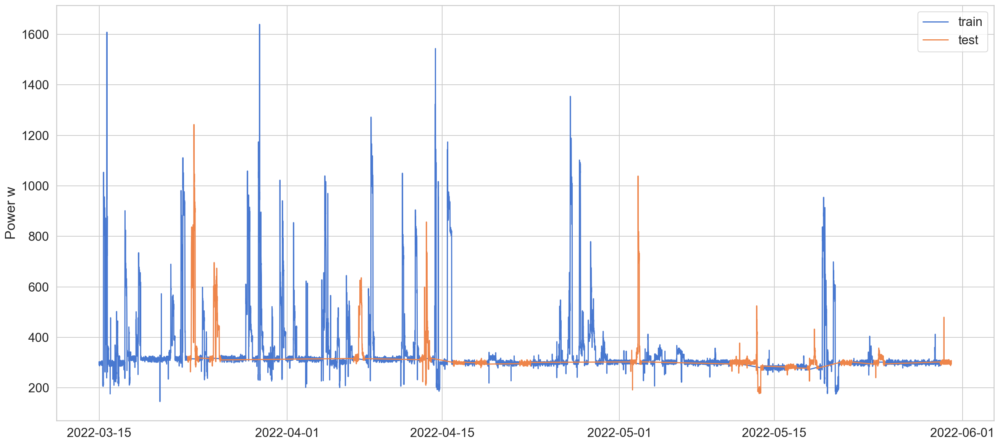

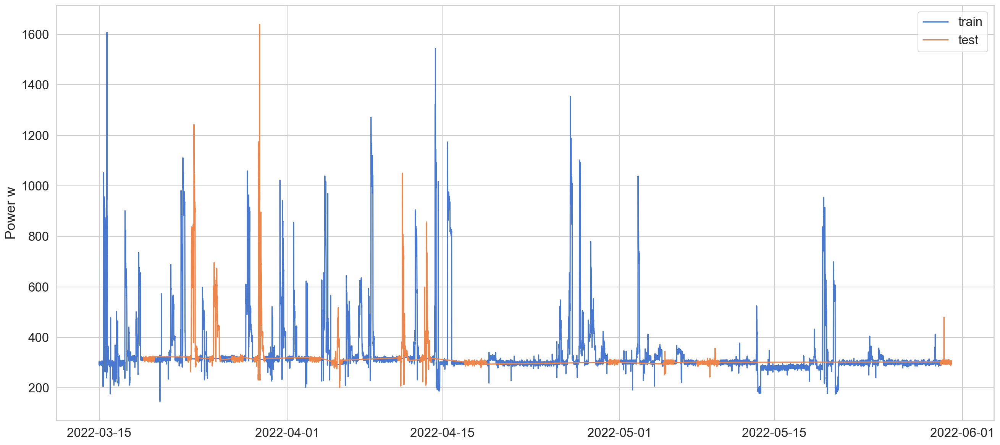

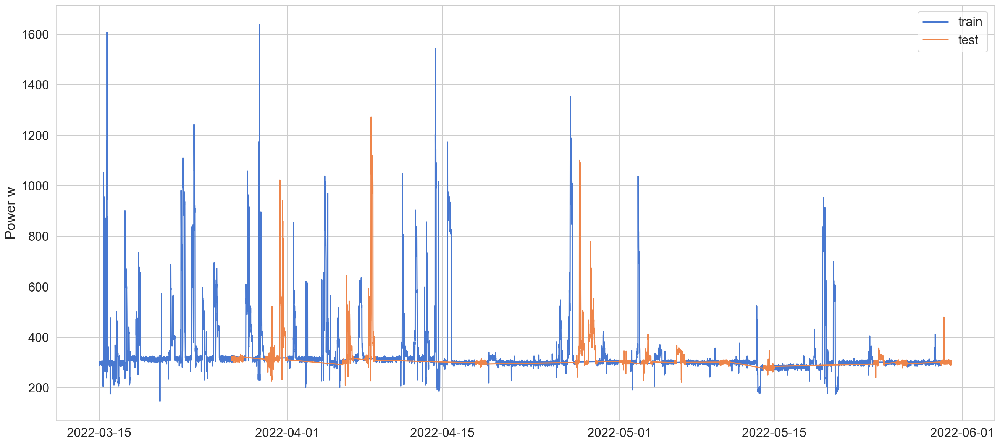

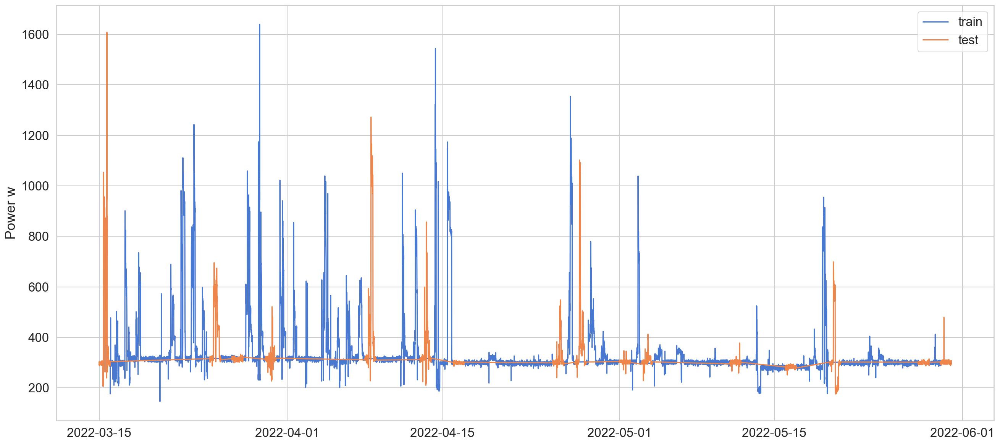

...

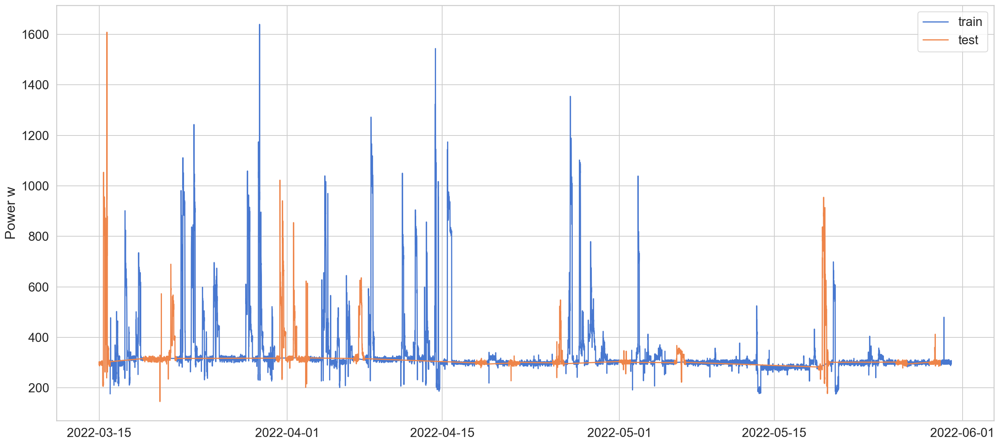

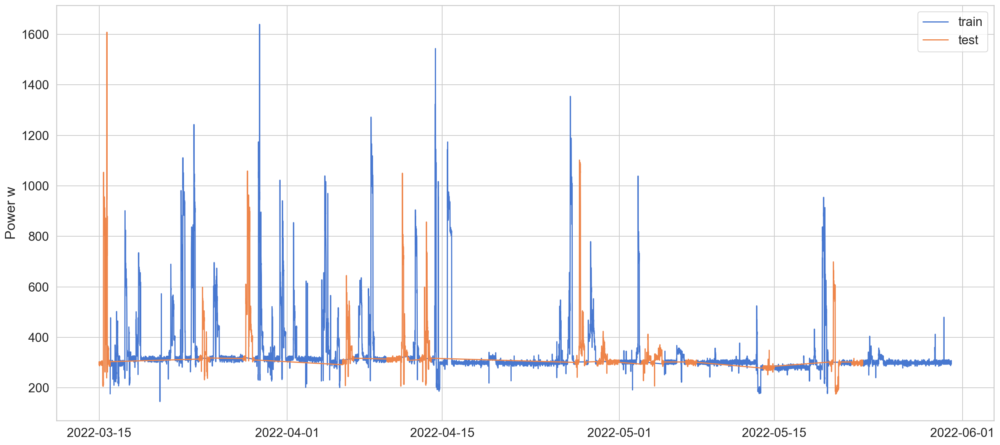

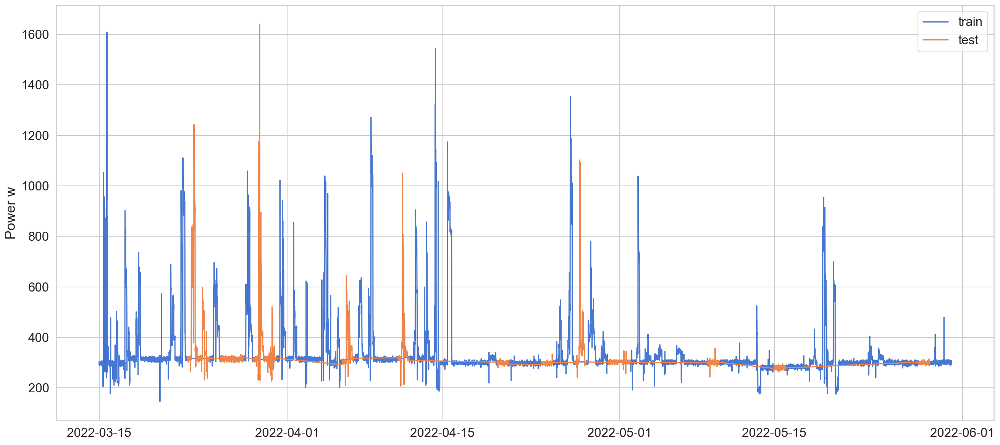

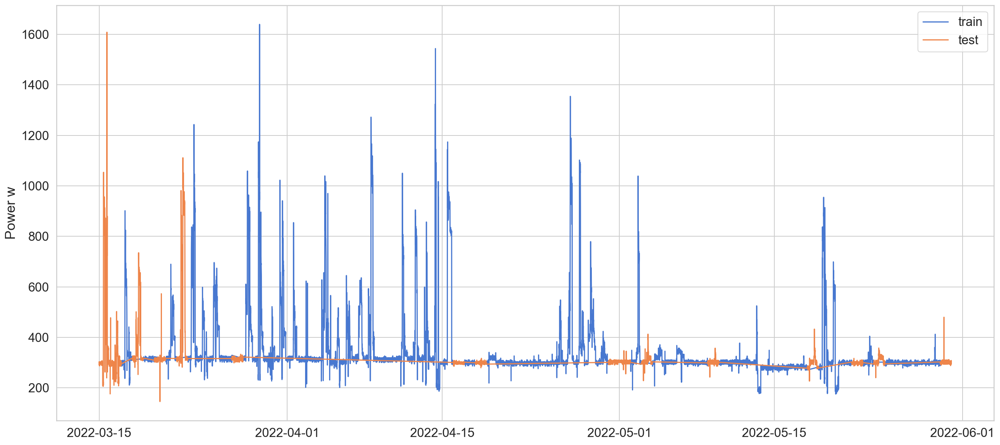

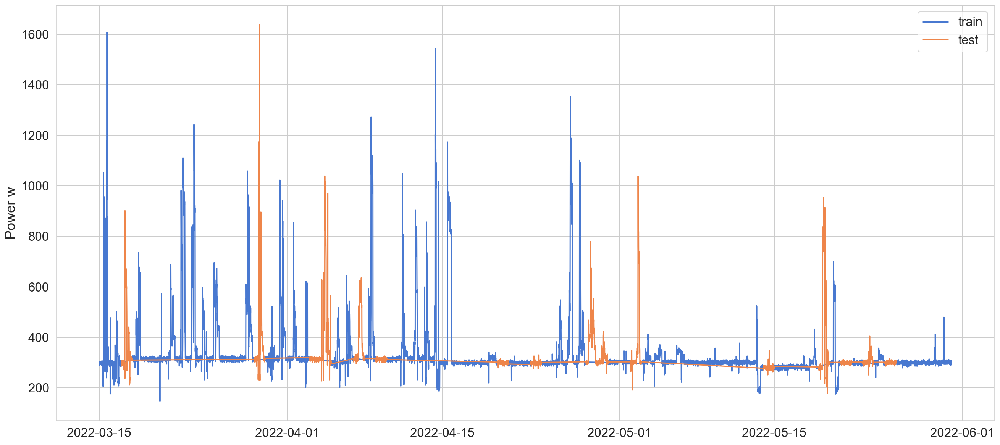

Back_fillMAR25 ;mean; 0.638836080824565 ; 77.52864533490501 ; 84.00643497260481 ; 71.30495208150315 ; 75.54207796059417
Back_fillMAR25 ;std; 0.01128051449000445 ; 1.2538432425983261 ; 3.4512904106931606 ; 1.1102735097309901 ; 5.597210489743256


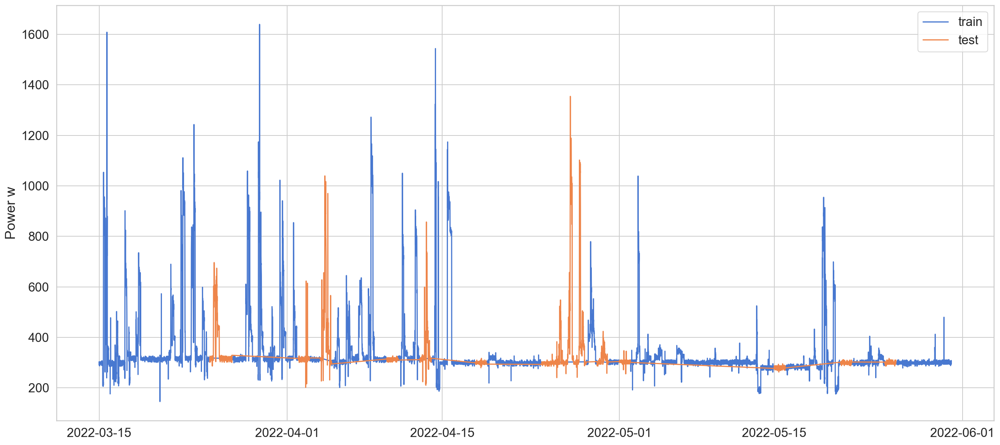

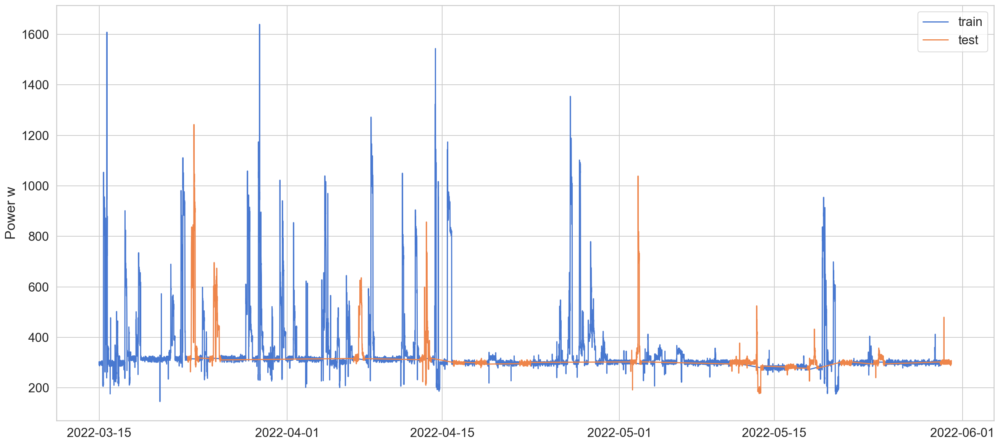

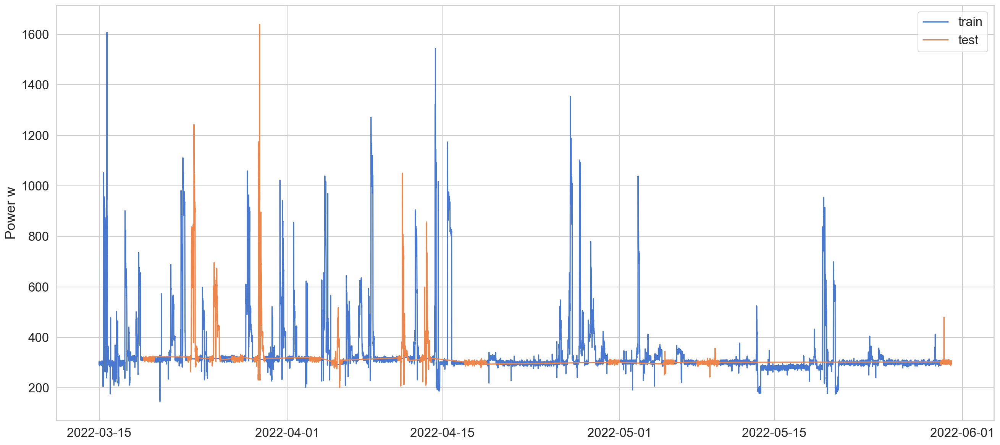

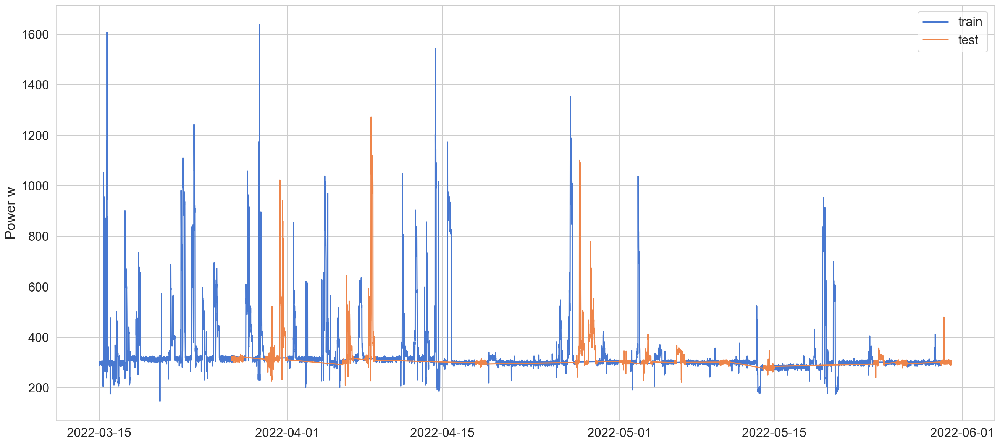

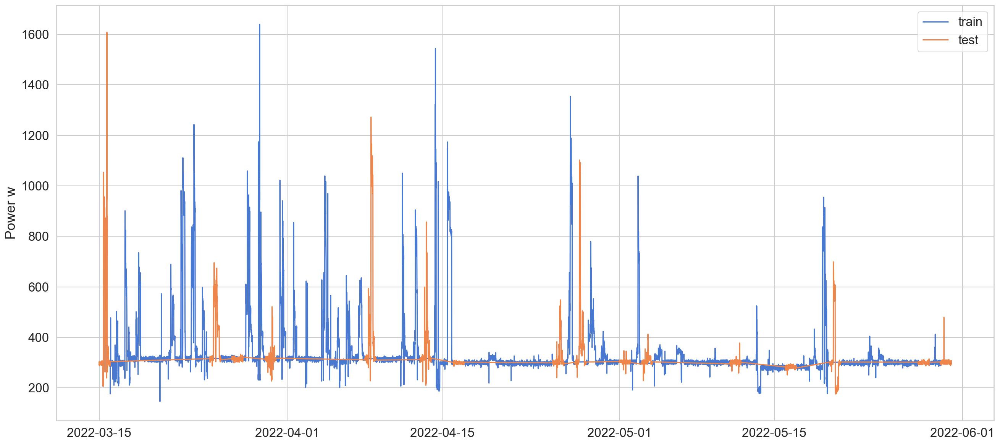

...

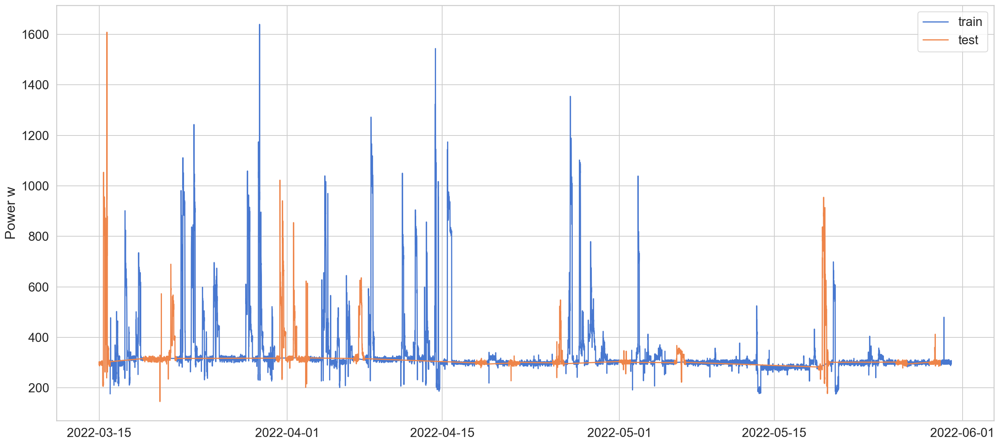

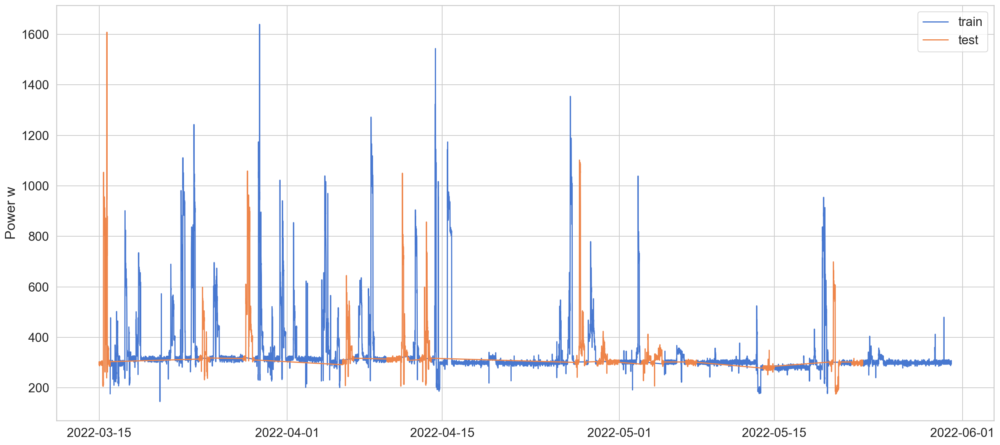

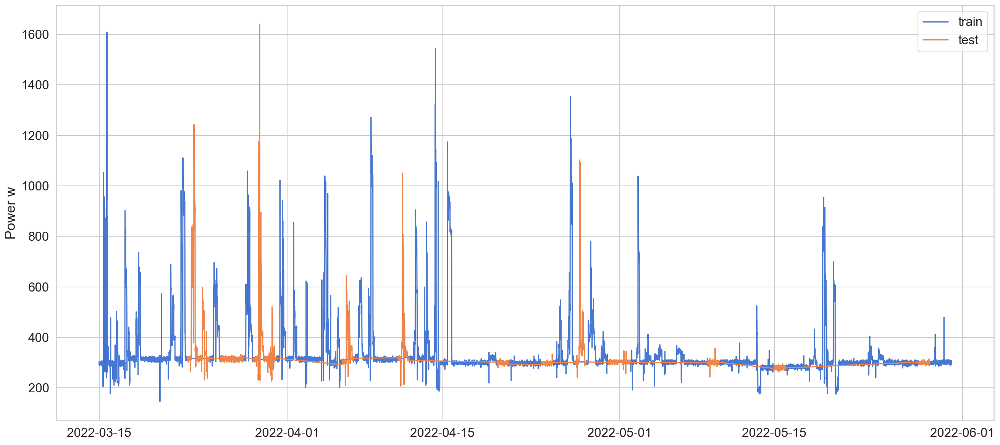

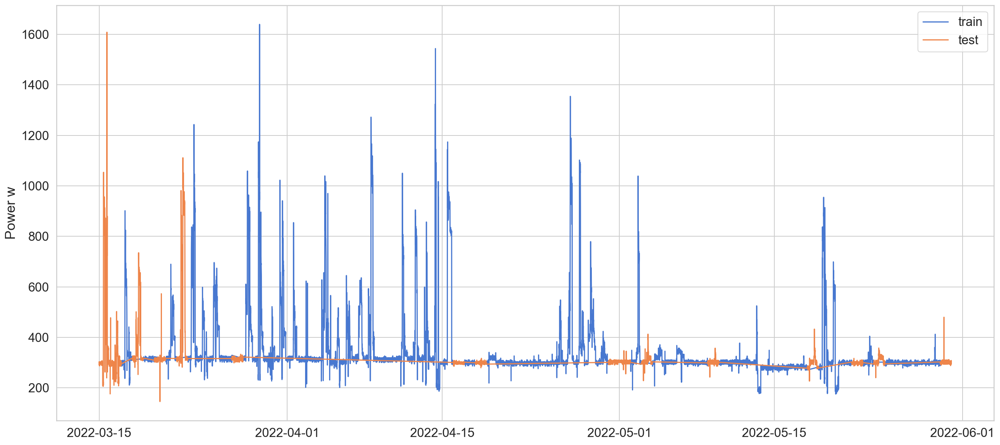

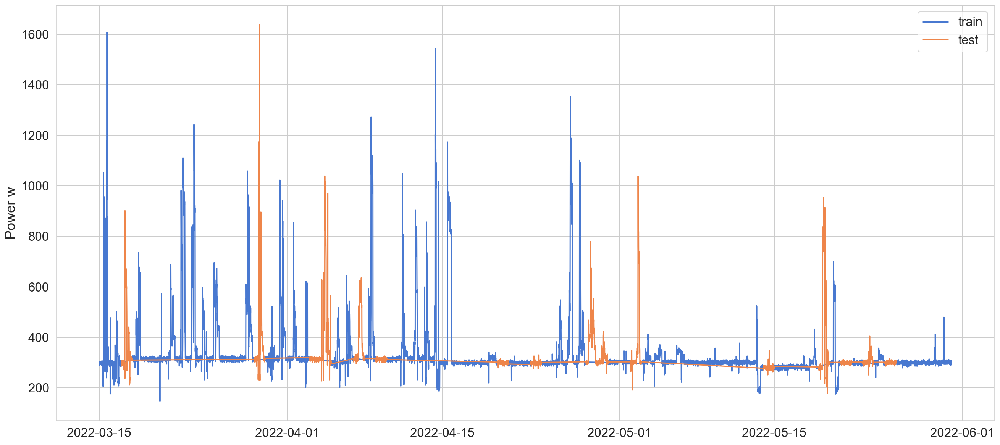

Back_fillMAR40 ;mean; 0.6488981091303885 ; 76.43503979900288 ; 84.16108718656625 ; 72.44128574707968 ; 77.20338592832702
Back_fillMAR40 ;std; 0.012246518920409396 ; 1.137121279413017 ; 3.7411559848811673 ; 0.7717258779187723 ; 4.092397422888774


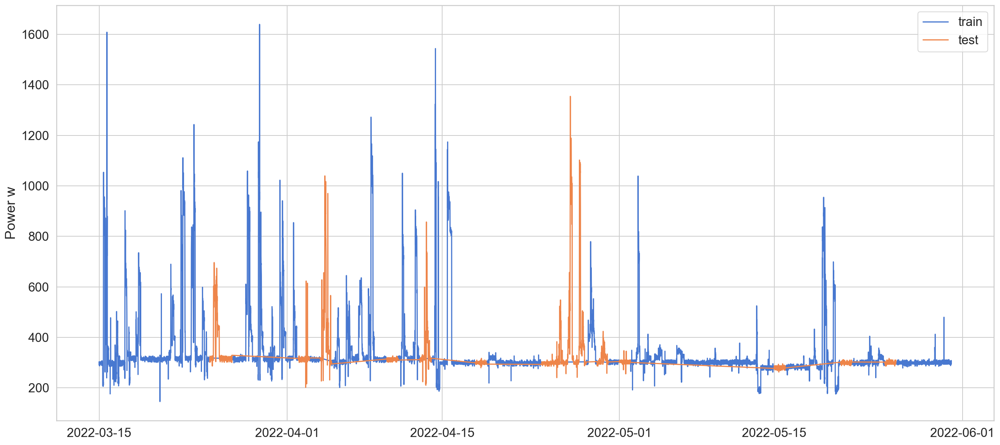

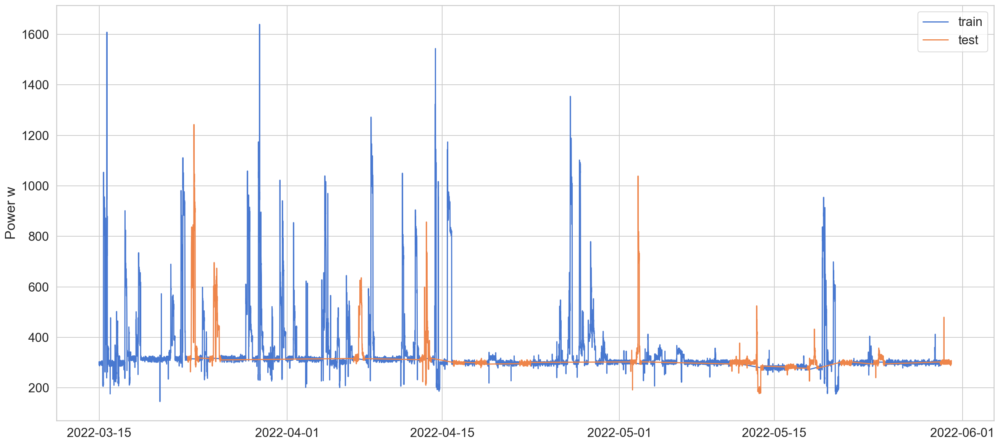

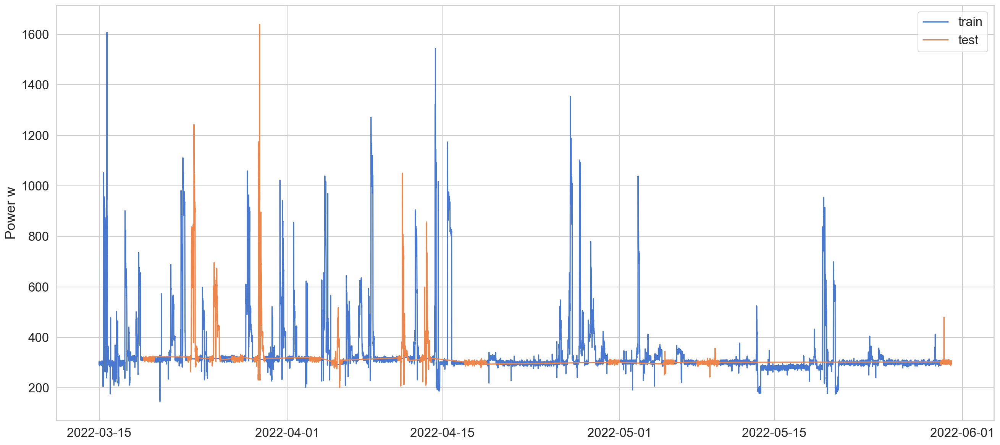

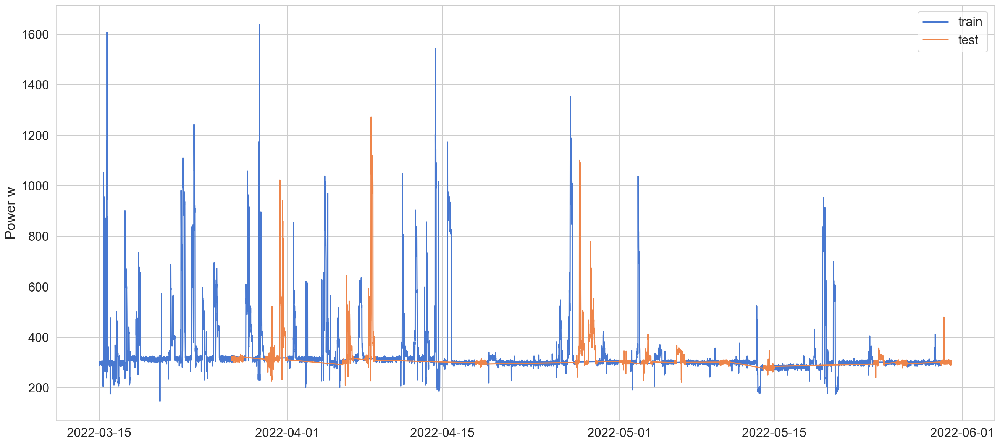

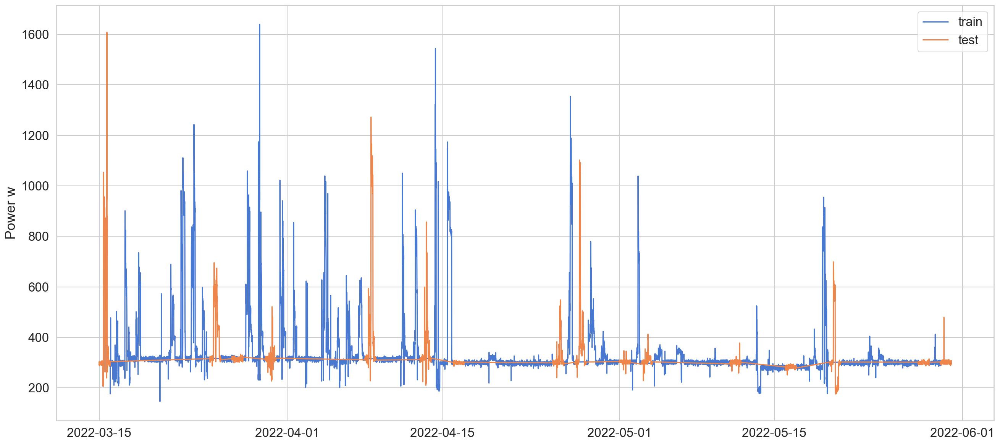

...

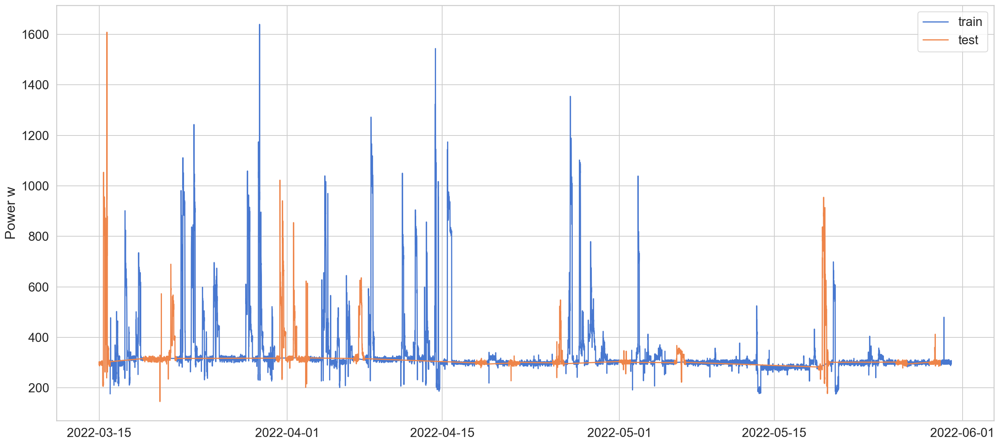

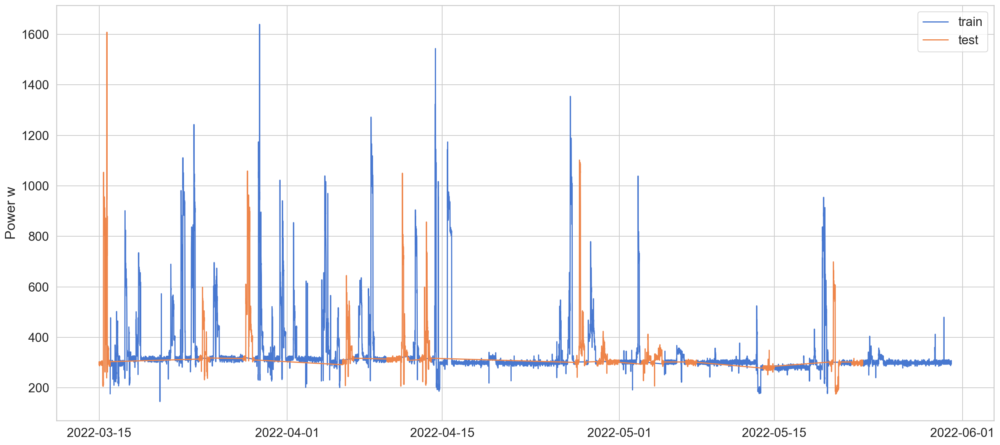

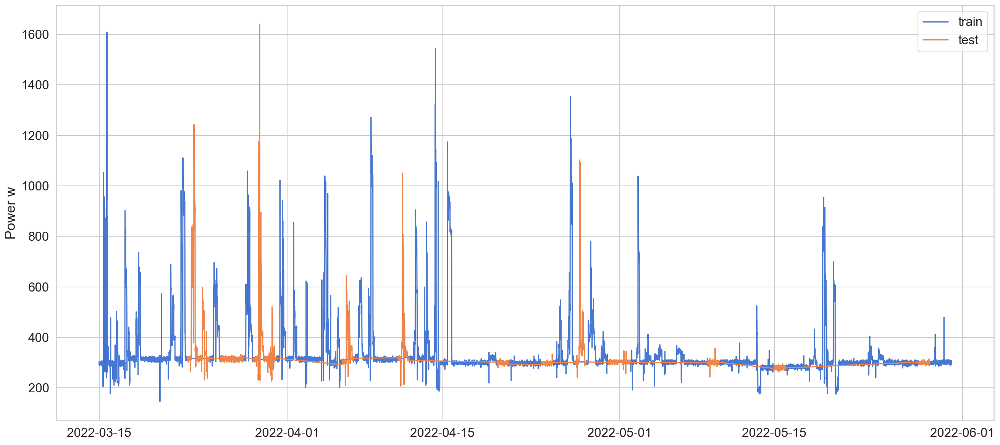

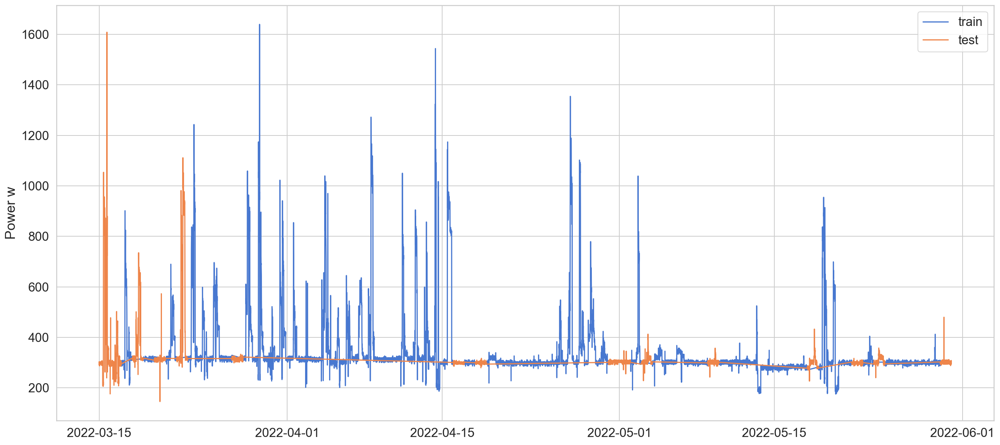

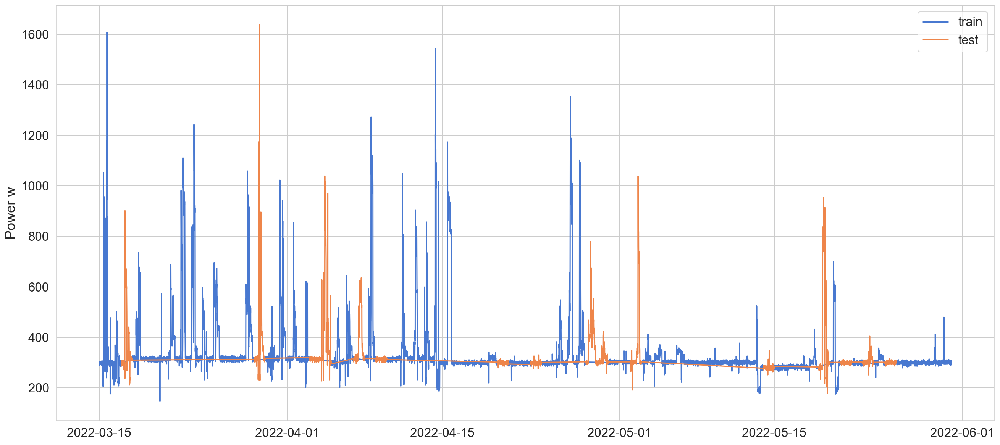

Back_fillMAR60 ;mean; 0.6647456484618004 ; 74.68998321449959 ; 87.64389837756718 ; 71.98487672156428 ; 78.70316207136423
Back_fillMAR60 ;std; 0.011737502410944097 ; 1.1128156637799569 ; 4.399916501721804 ; 0.9369888919857674 ; 4.75512771666076


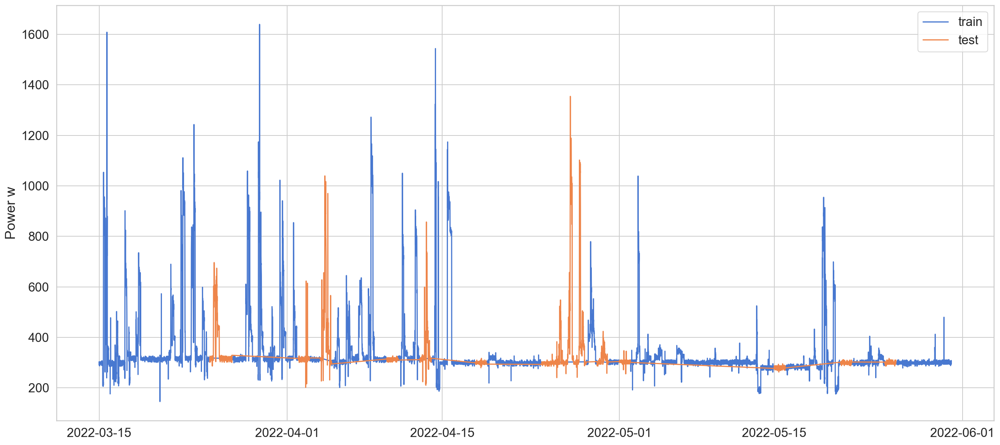

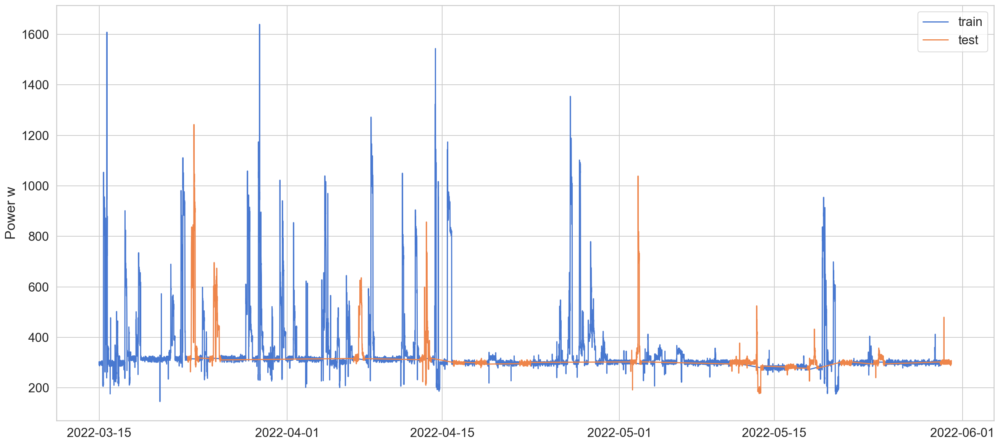

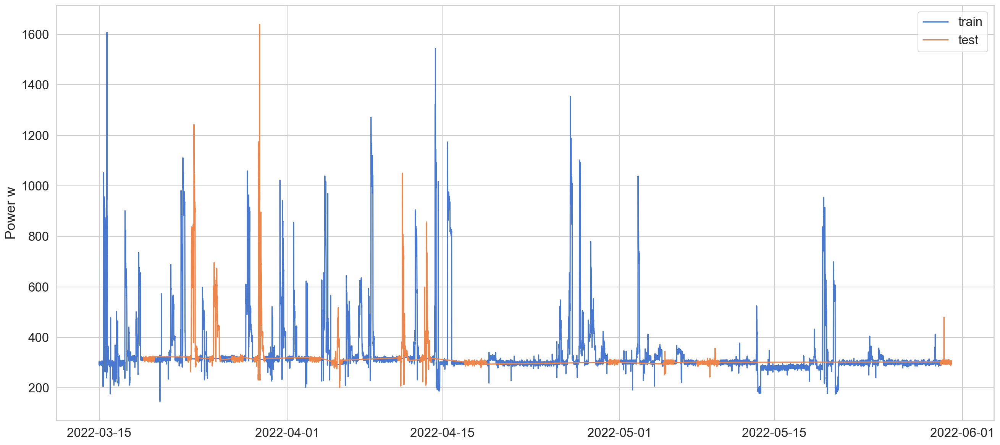

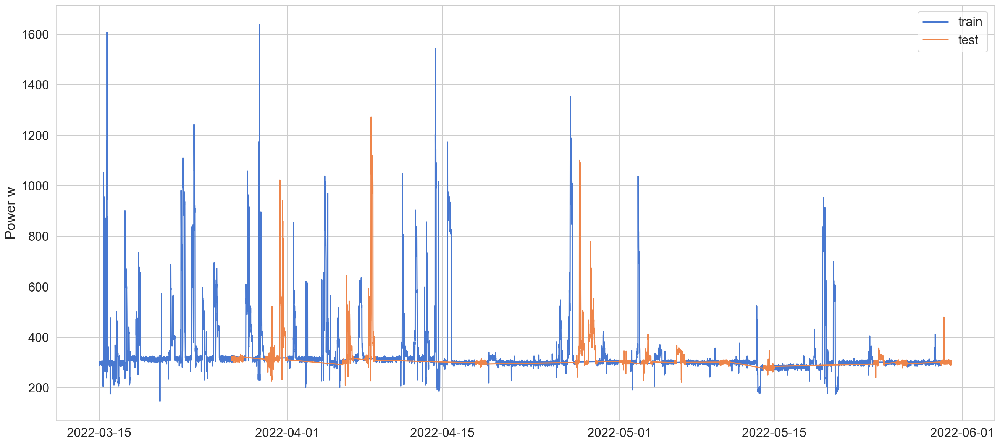

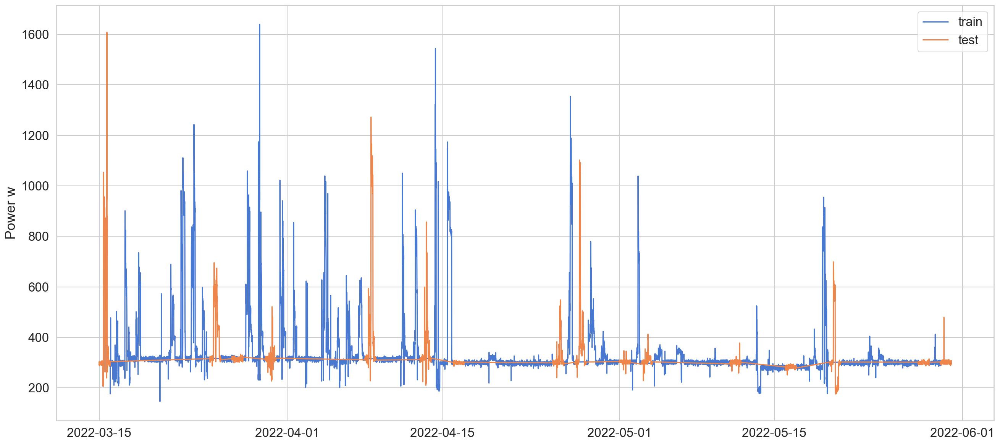

...

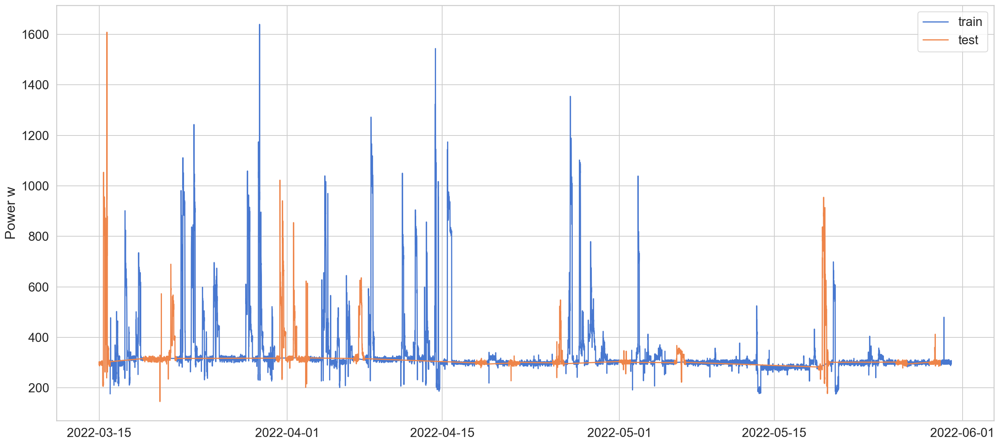

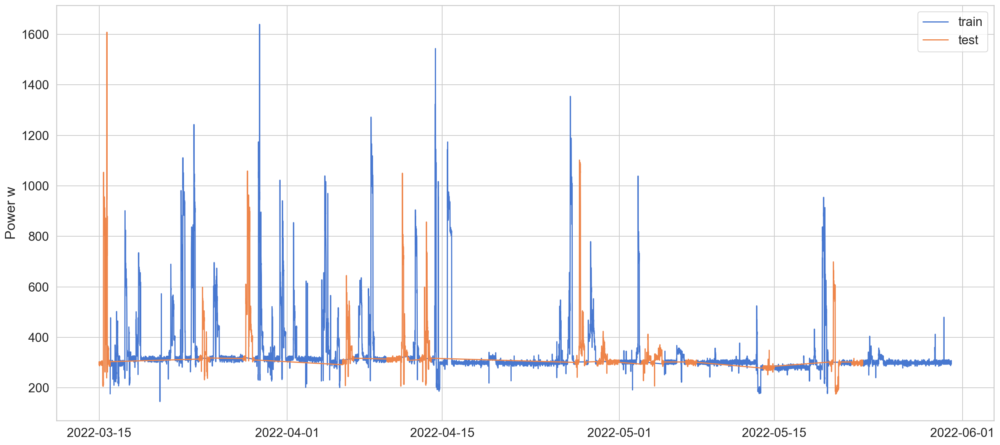

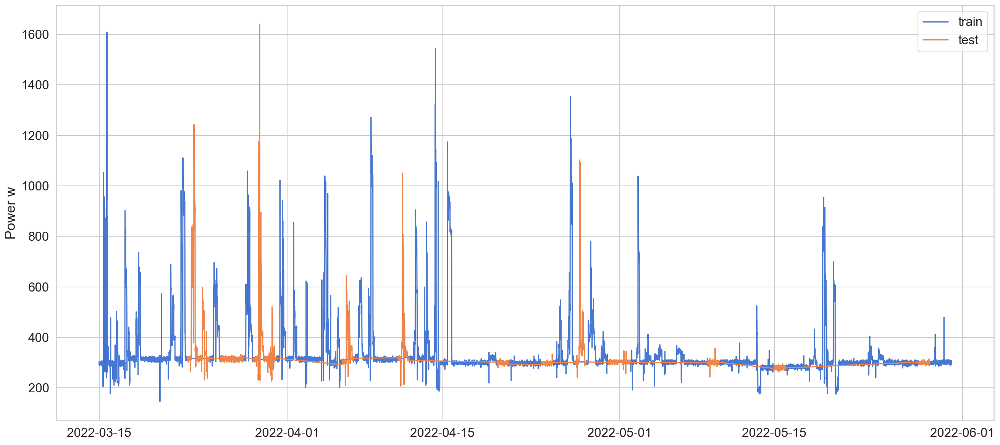

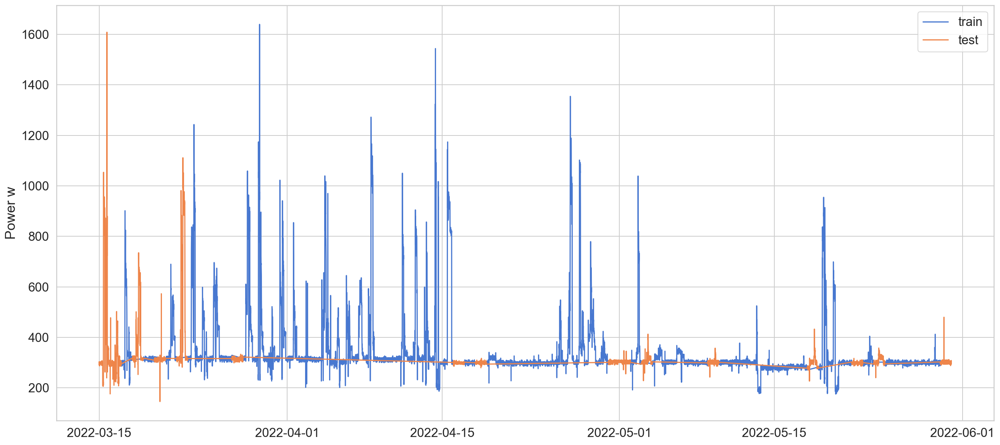

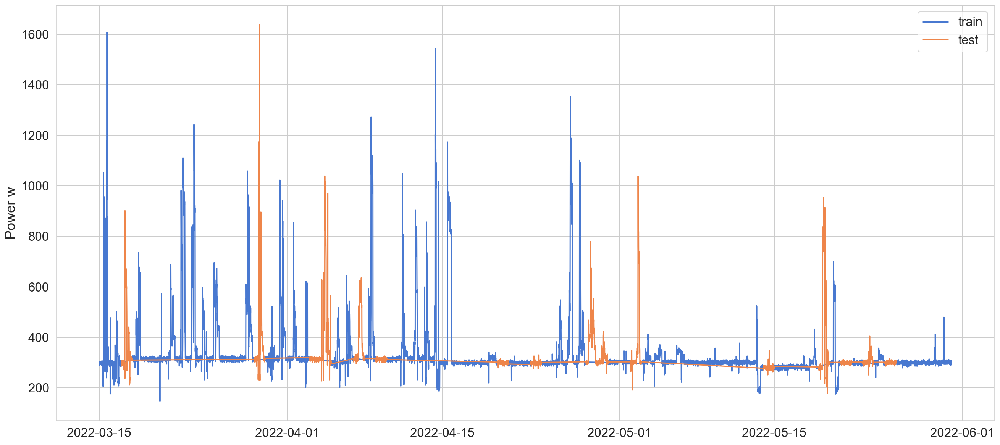

Back_fillMAR70 ;mean; 0.7024684762991834 ; 70.35436980050397 ; 84.91158956186018 ; 71.54358855463748 ; 78.65467792613022
Back_fillMAR70 ;std; 0.01281506382724499 ; 1.198676891564721 ; 4.6461242177150375 ; 1.1902462162675307 ; 5.015361573842312


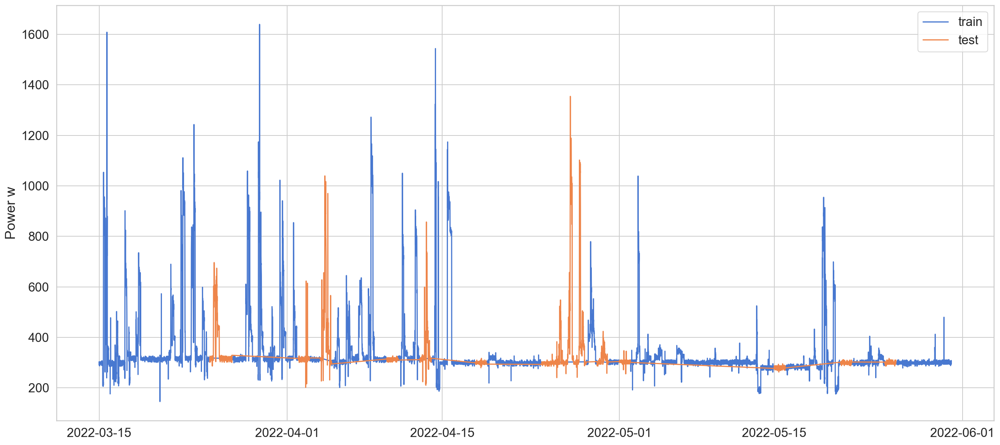

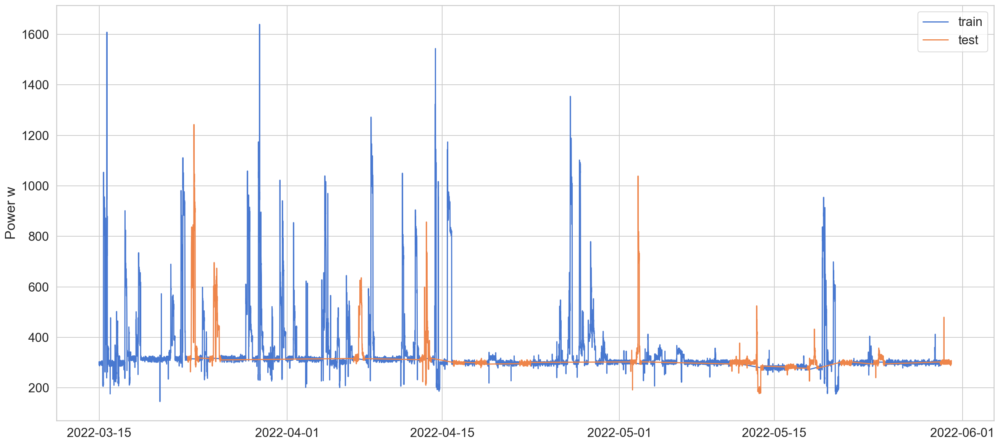

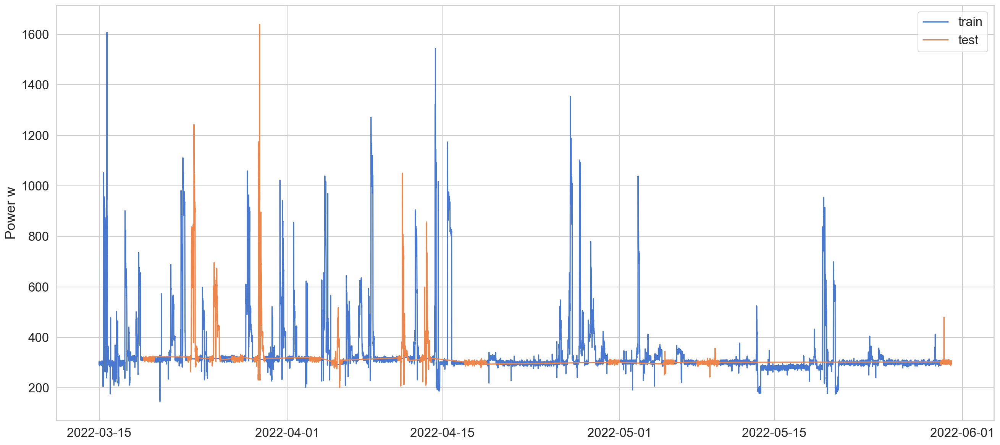

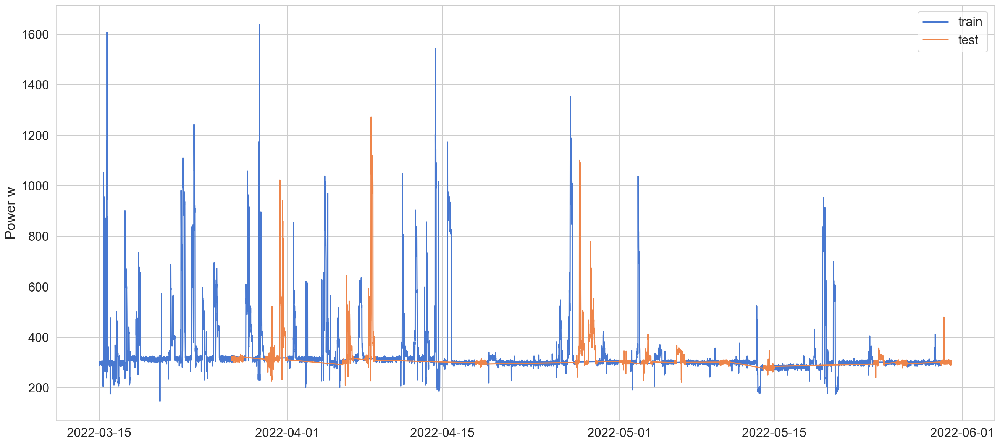

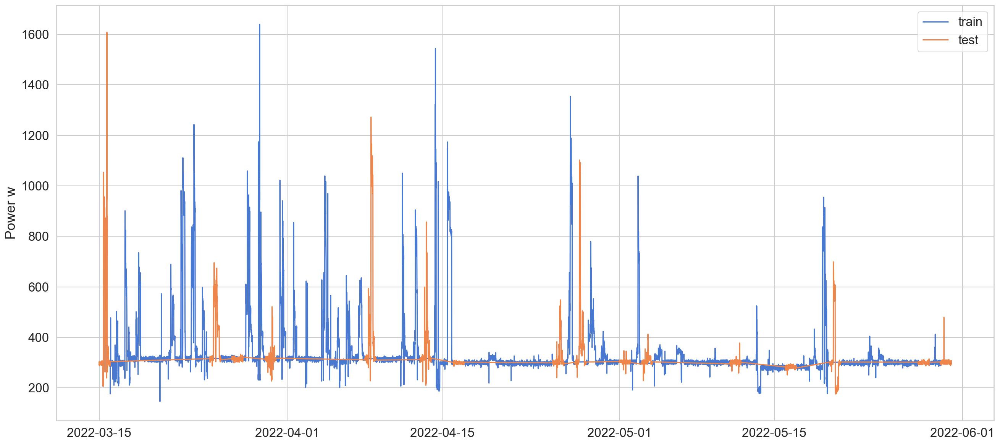

...

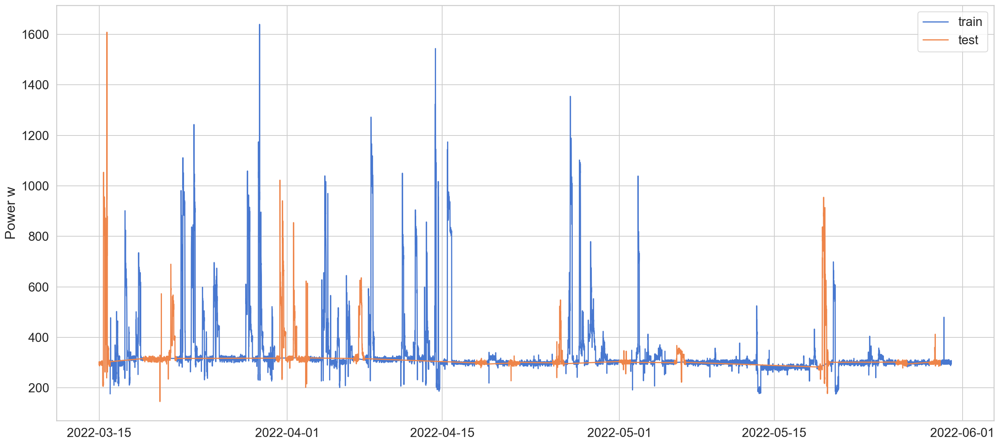

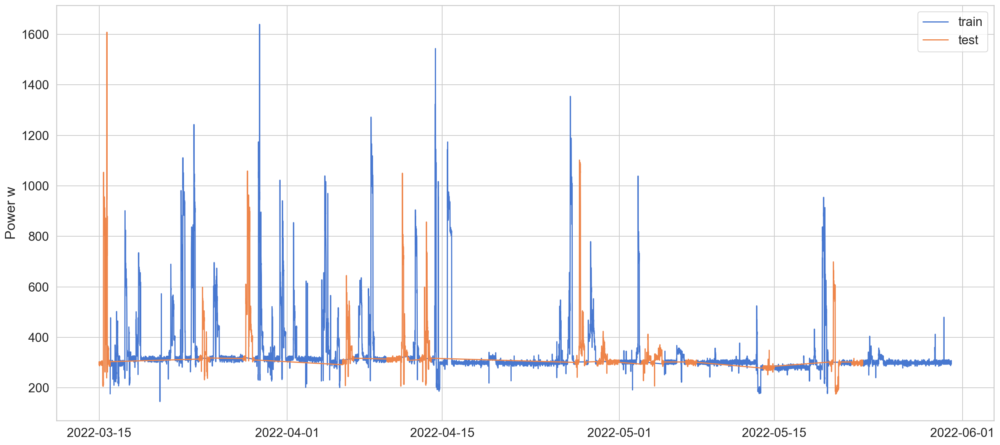

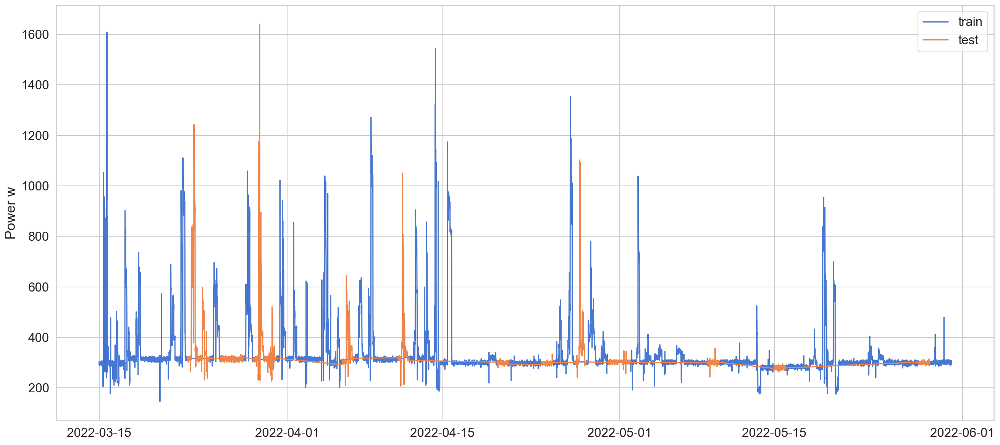

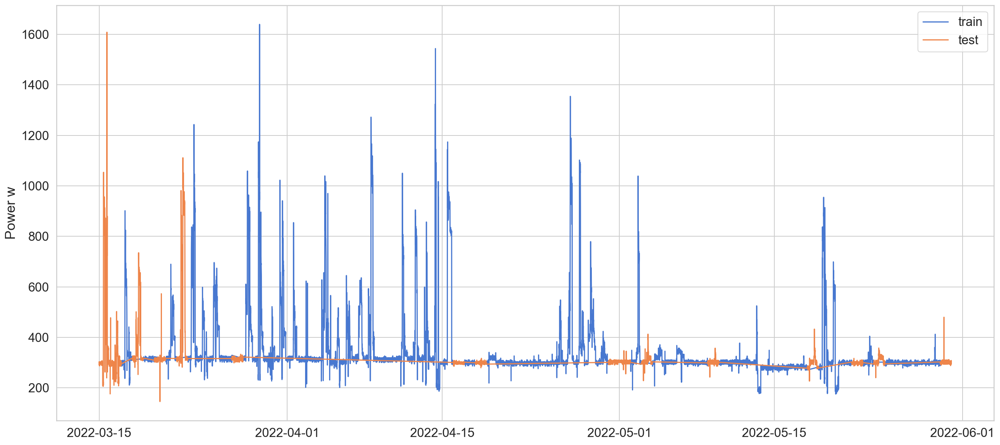

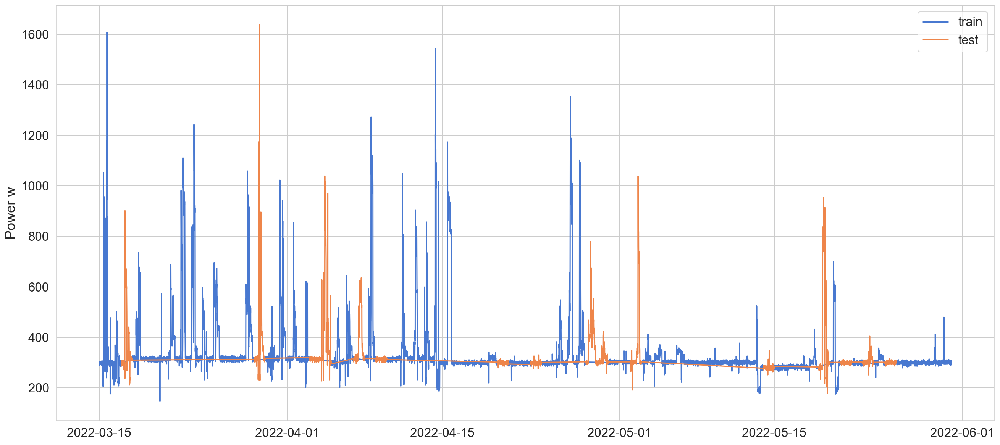

Back_fillMCAR05 ;mean; 0.6281515916805753 ; 78.65693758181989 ; 84.64421934845242 ; 71.31962629508284 ; 75.44134571383758
Back_fillMCAR05 ;std; 0.013897065849990365 ; 1.1325786430203302 ; 3.5661571053380183 ; 0.988281599339077 ; 5.297891022148914


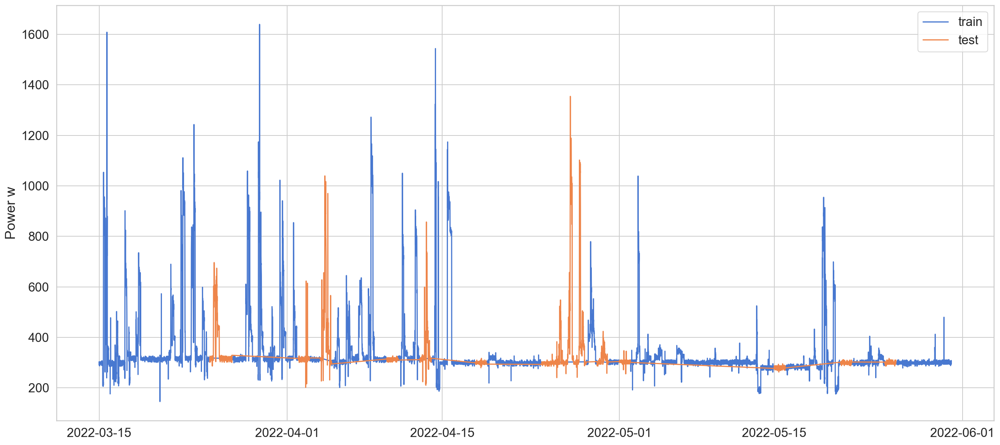

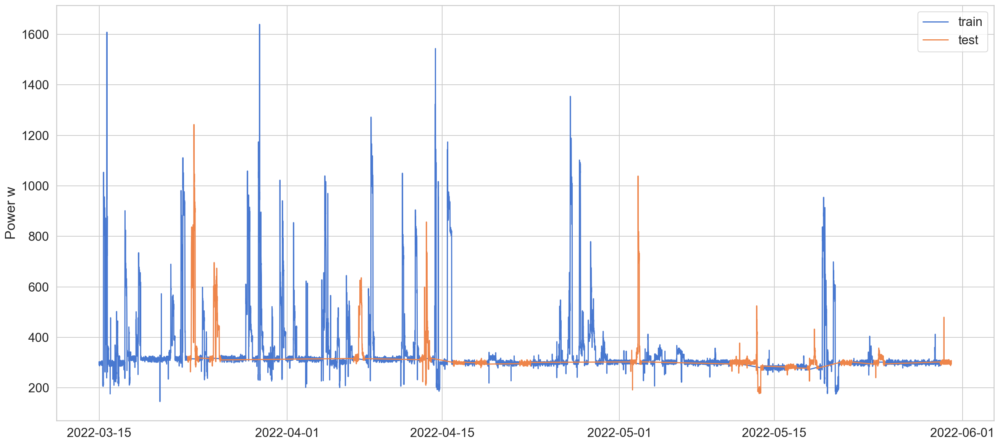

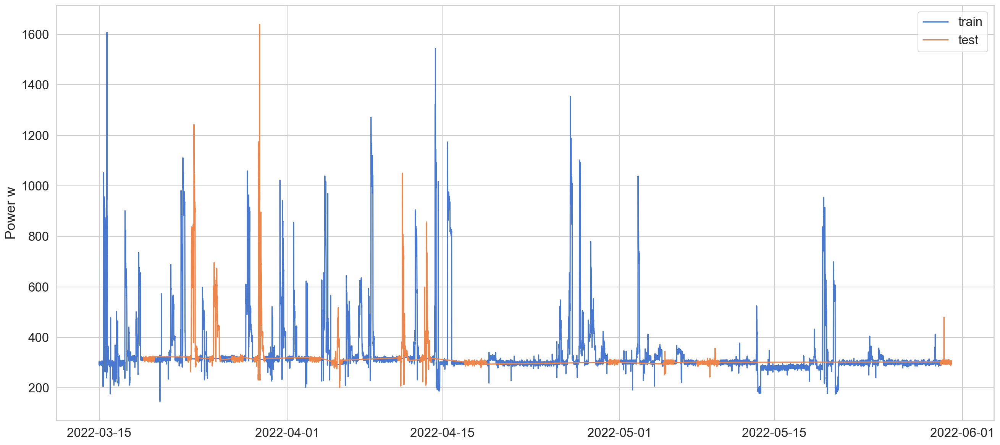

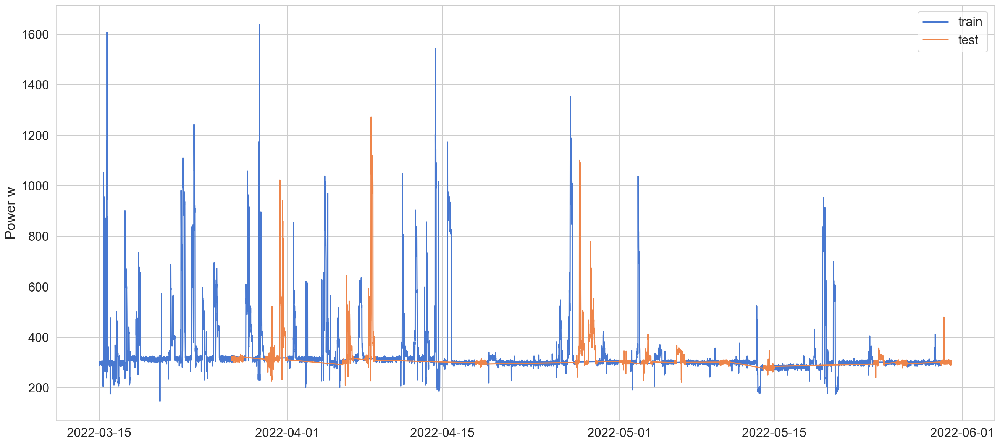

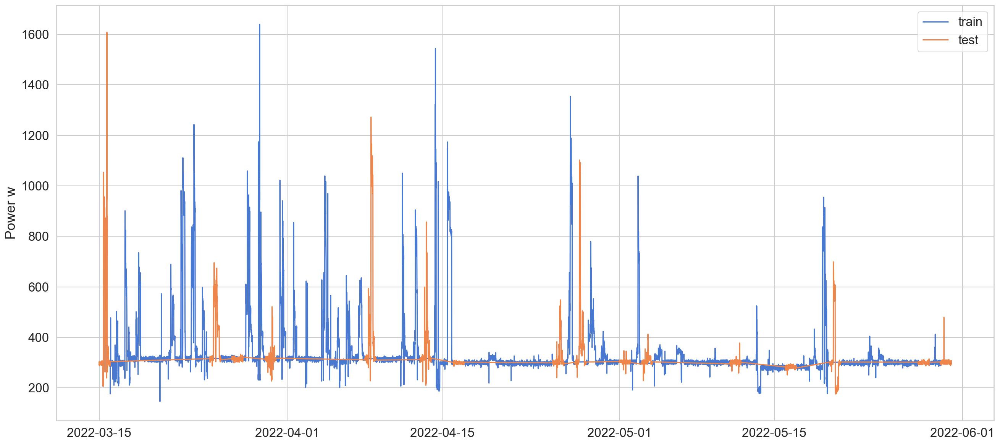

...

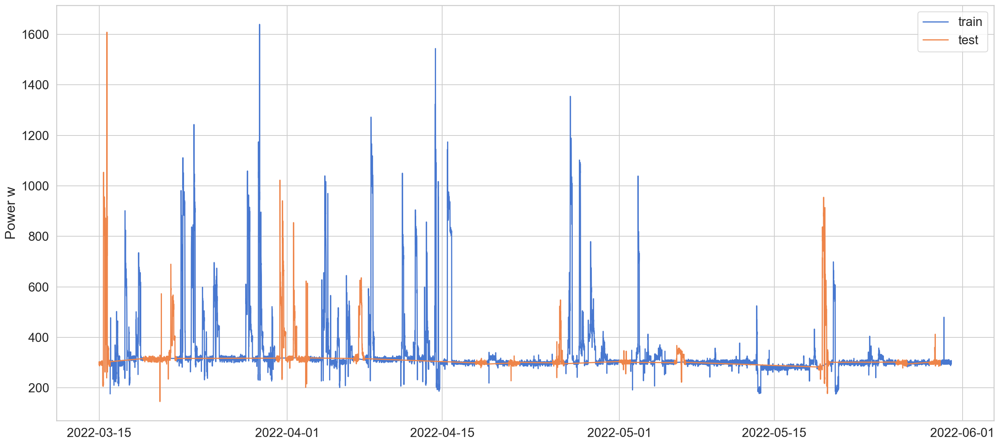

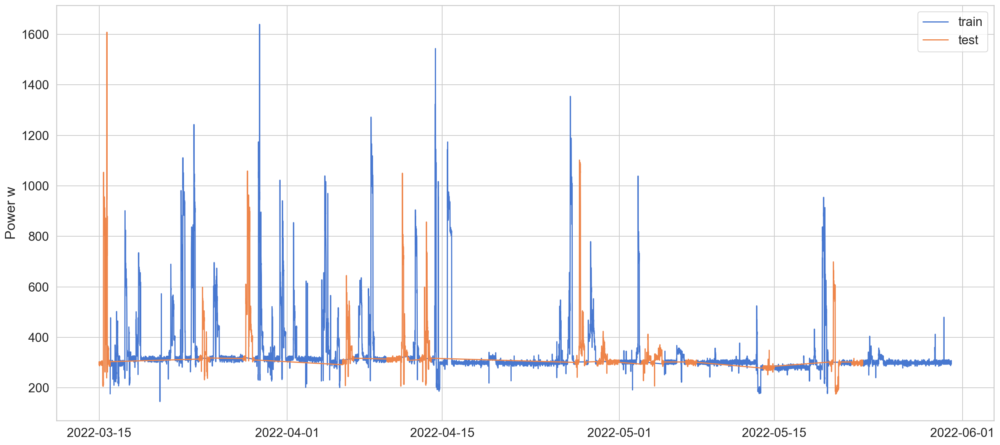

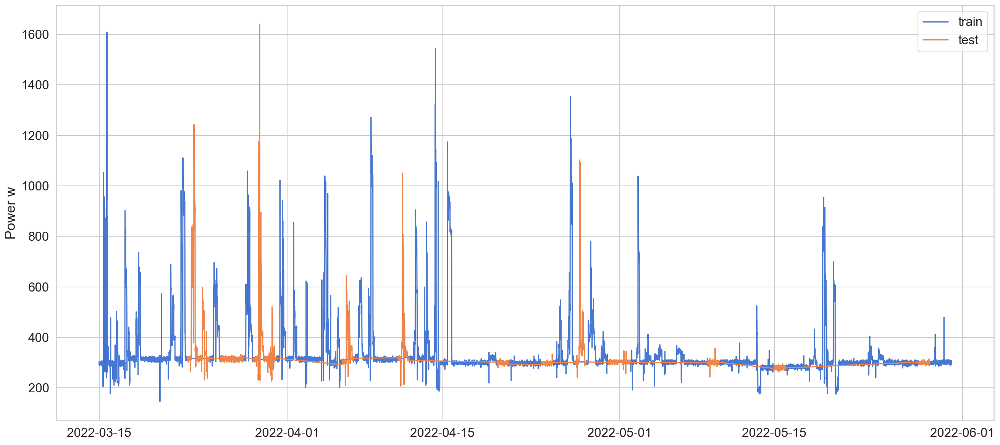

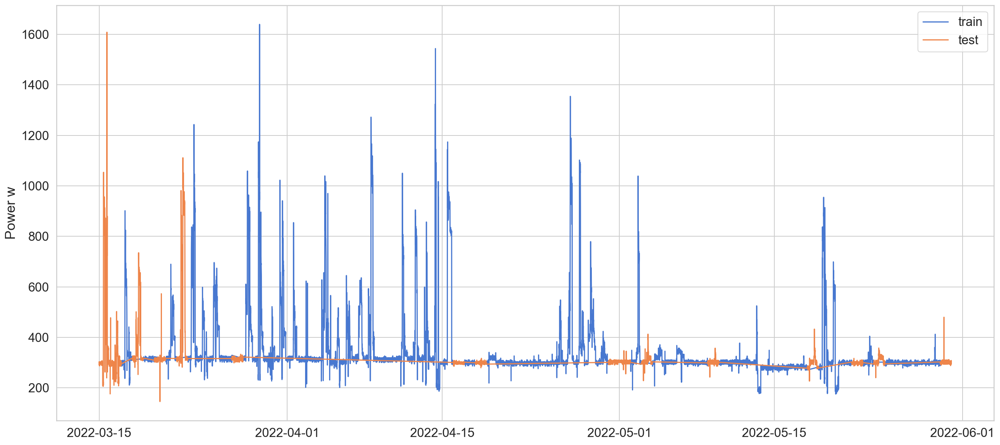

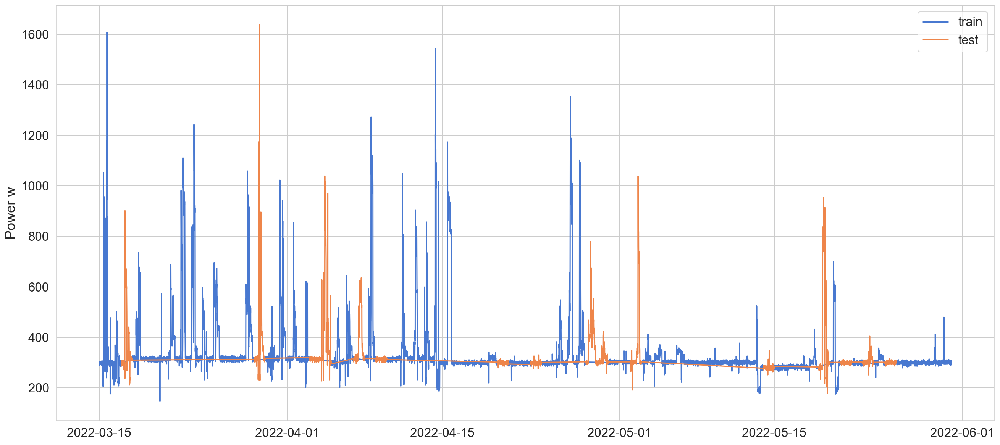

Back_fillMCAR10 ;mean; 0.6288405105777936 ; 78.590221978688 ; 84.35195669219932 ; 71.5145536741781 ; 75.52767554135393
Back_fillMCAR10 ;std; 0.011923550736126514 ; 1.0793033310949927 ; 3.627395189903249 ; 1.0683029488840141 ; 5.430604520093412


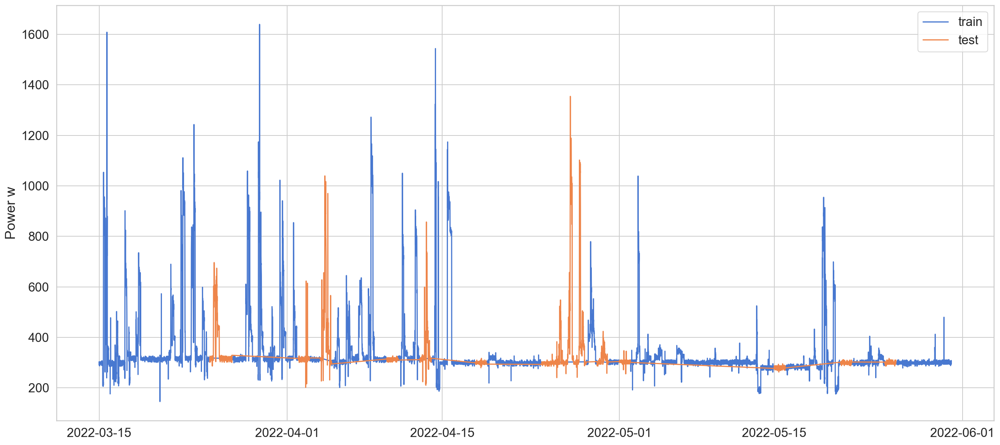

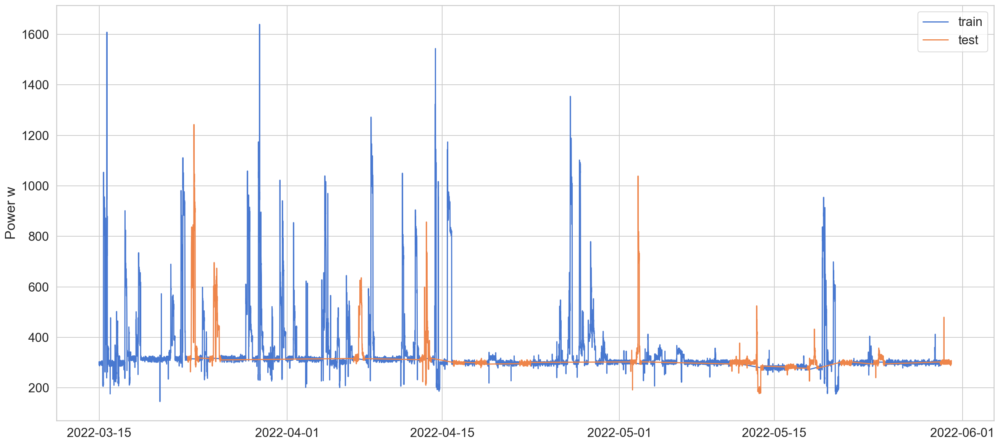

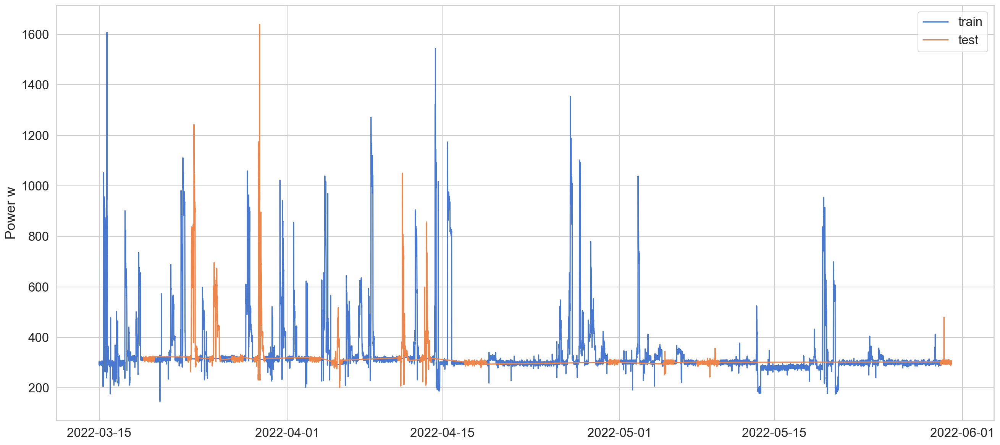

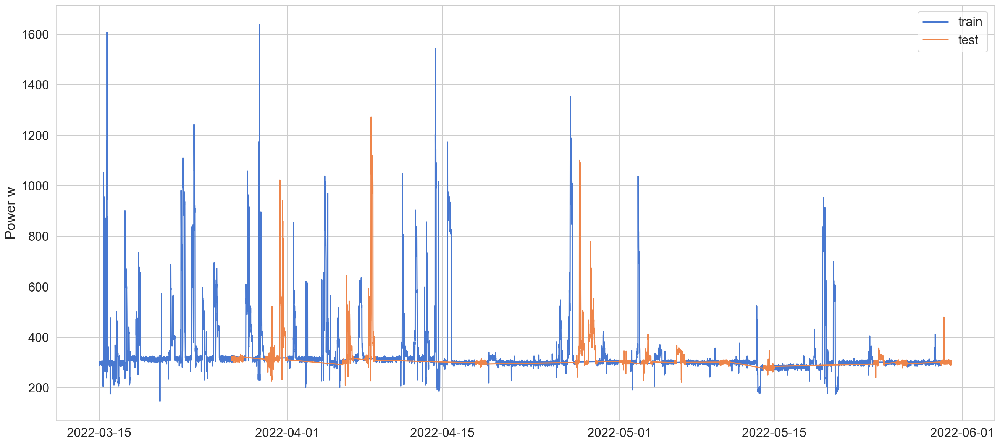

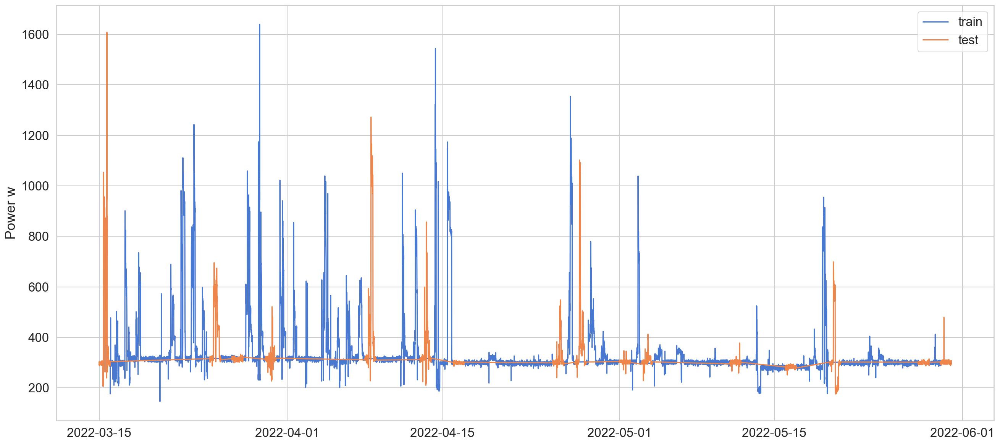

...

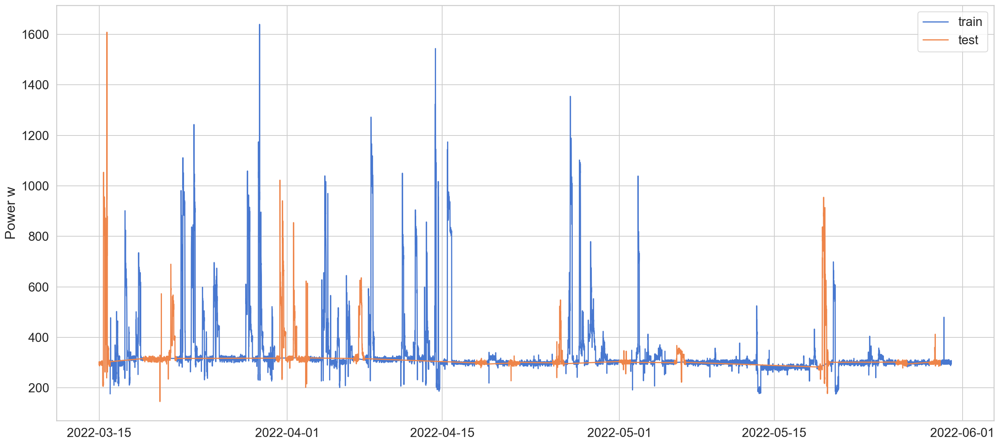

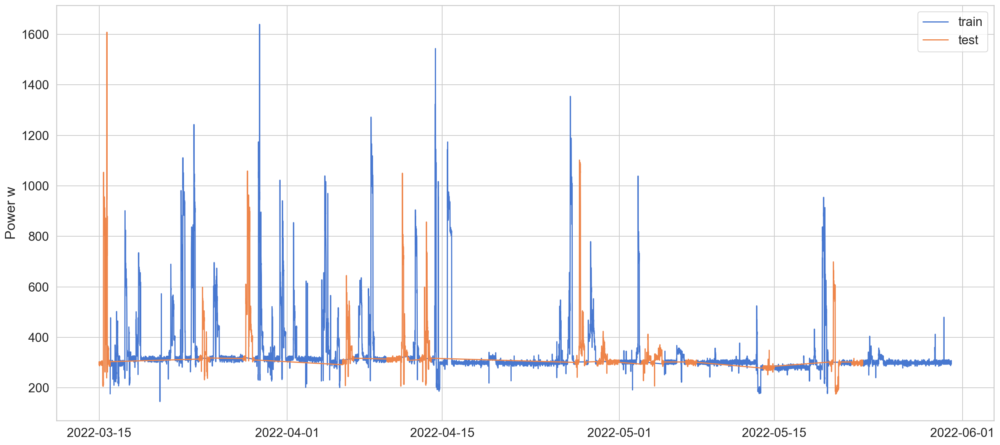

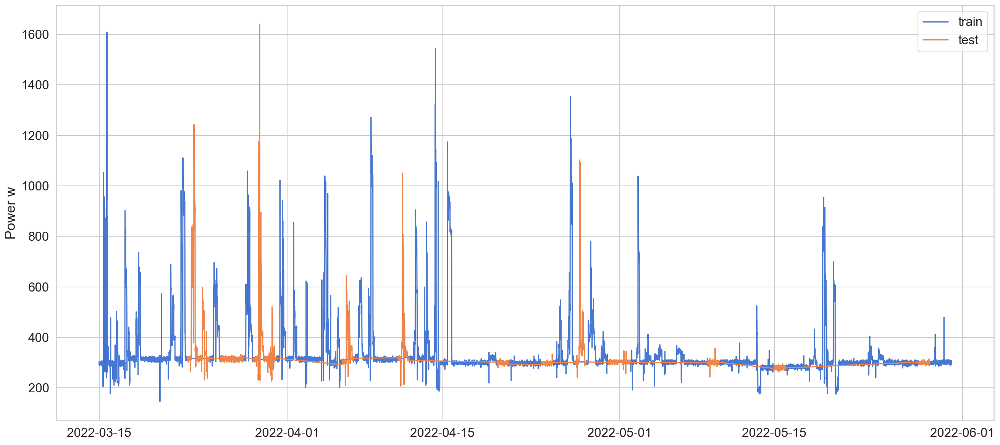

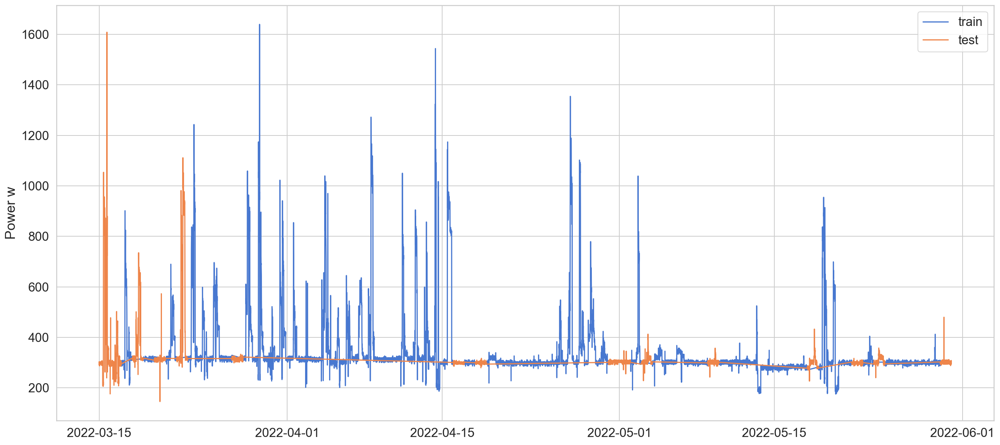

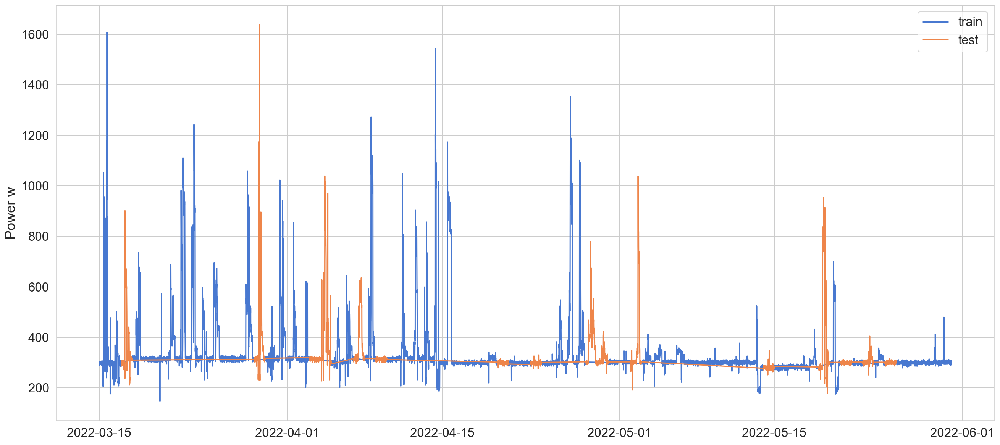

Back_fillMCAR25 ;mean; 0.6318621254330313 ; 78.26614612159489 ; 84.66386186062503 ; 71.56652204089579 ; 75.65952915717965
Back_fillMCAR25 ;std; 0.012936760647288157 ; 1.0936699177510532 ; 3.4605734129649255 ; 1.1573062963146425 ; 5.315645400898114


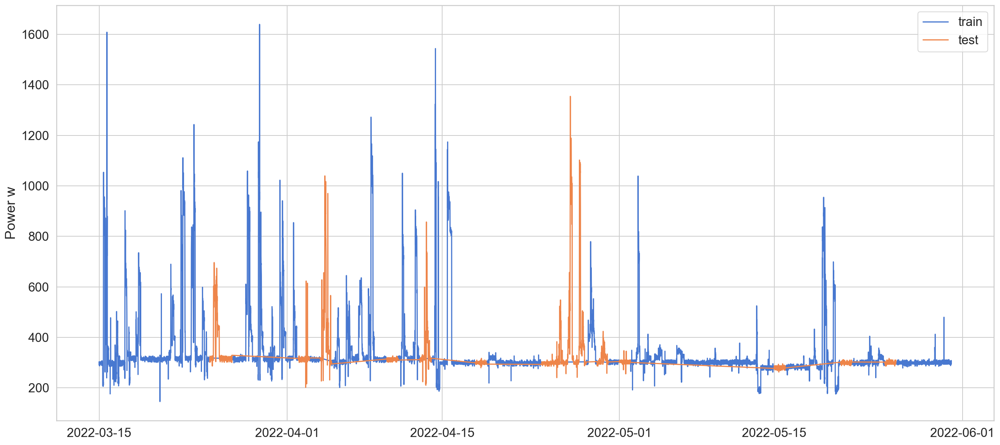

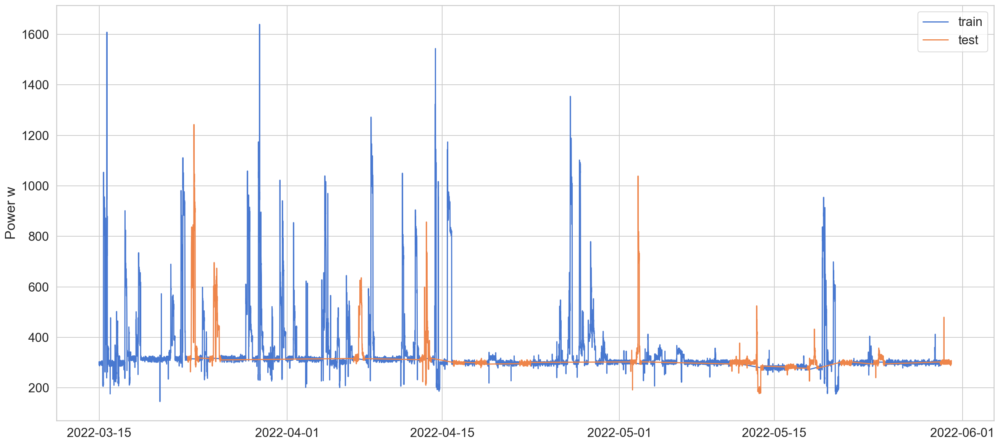

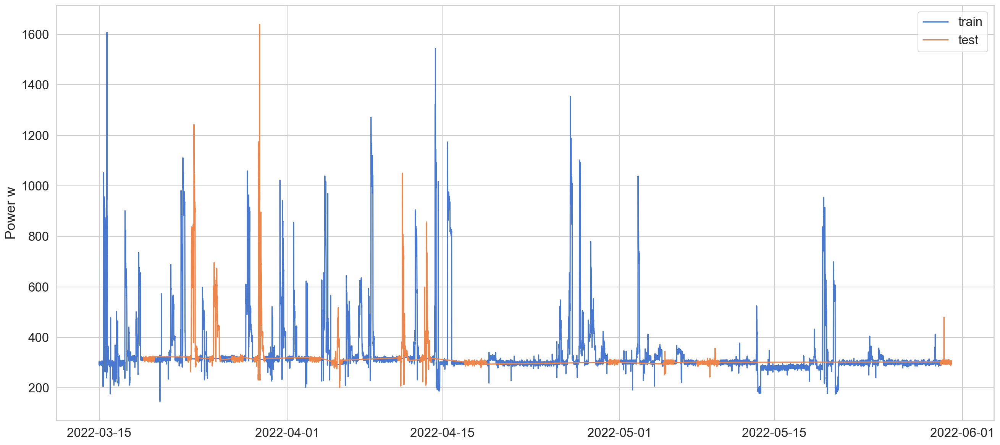

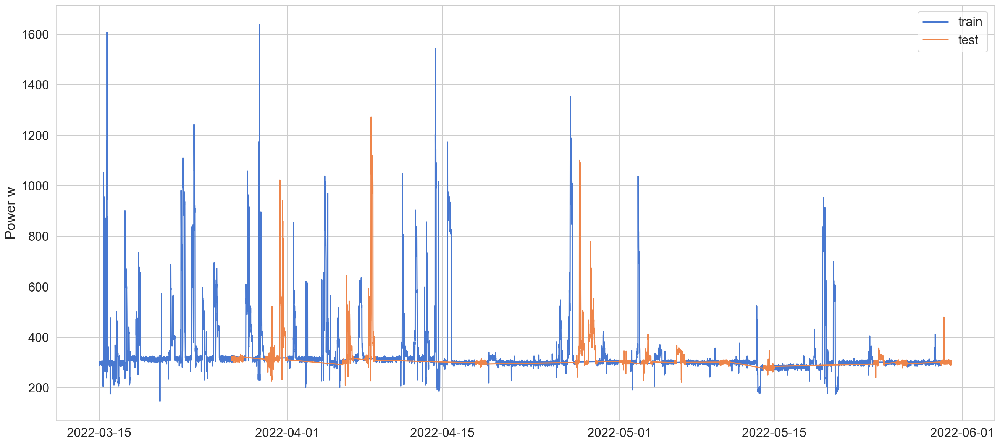

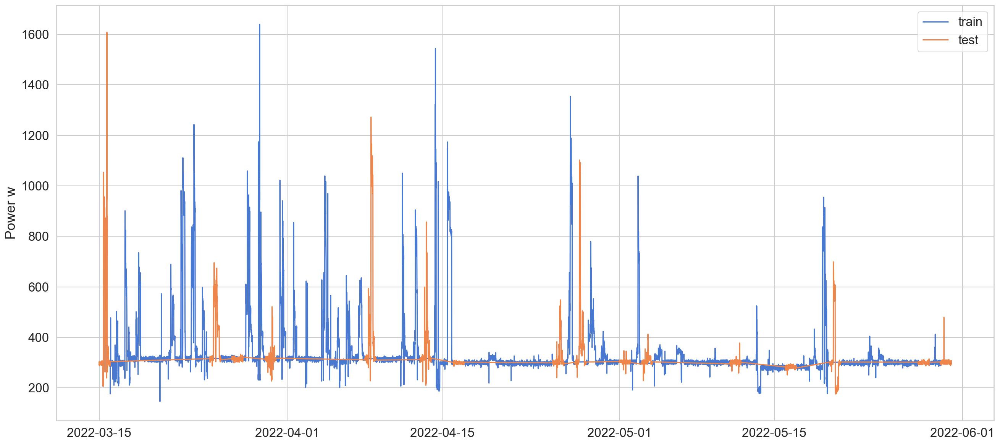

...

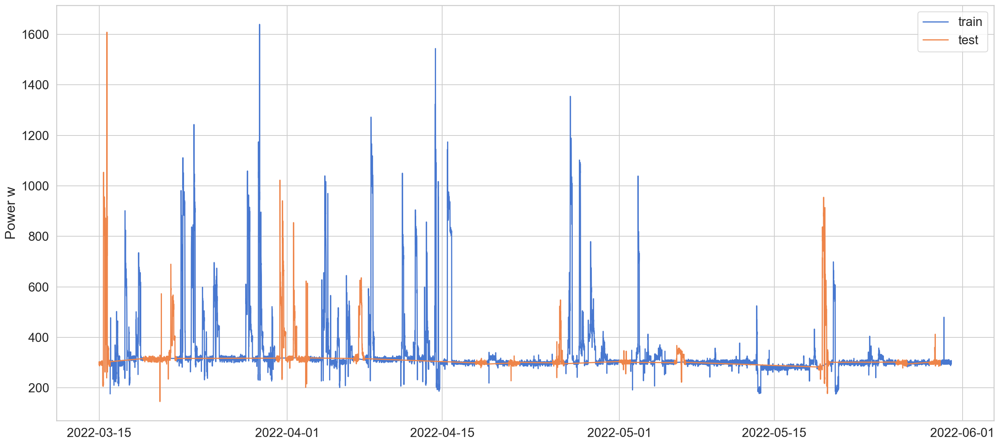

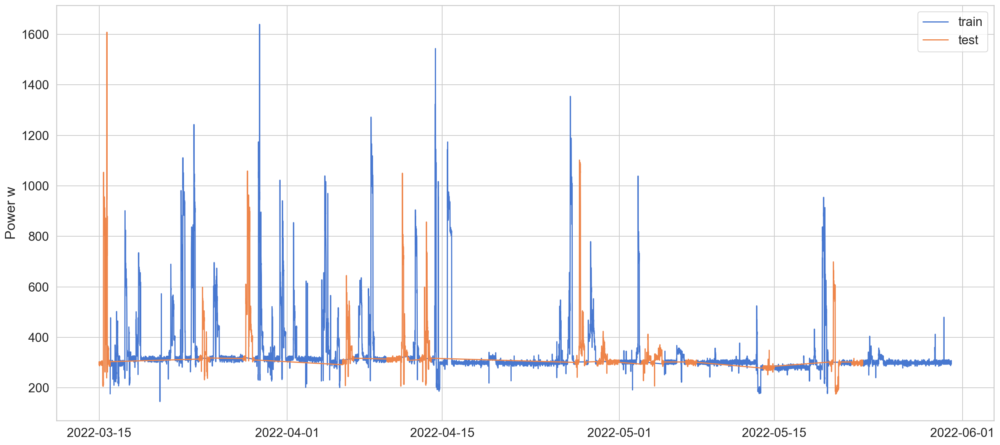

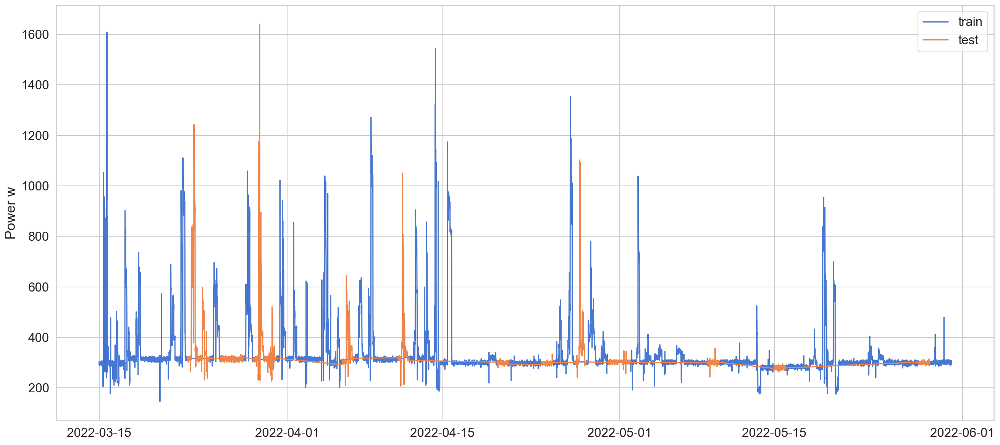

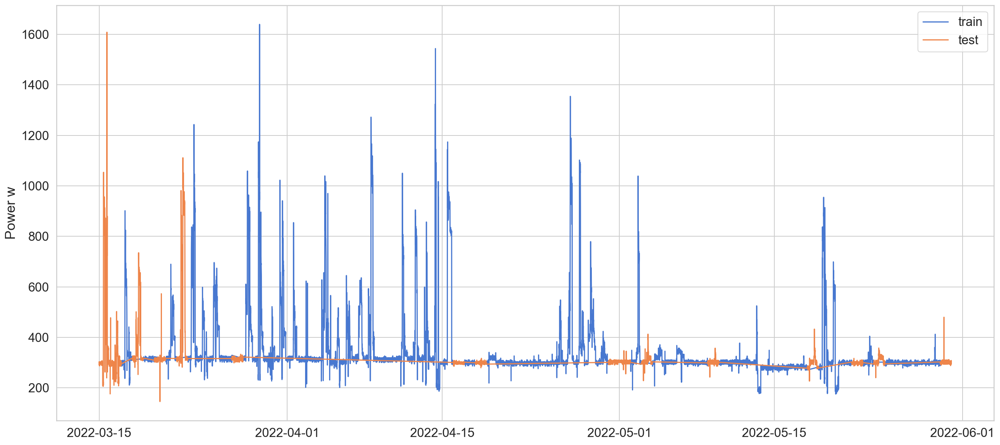

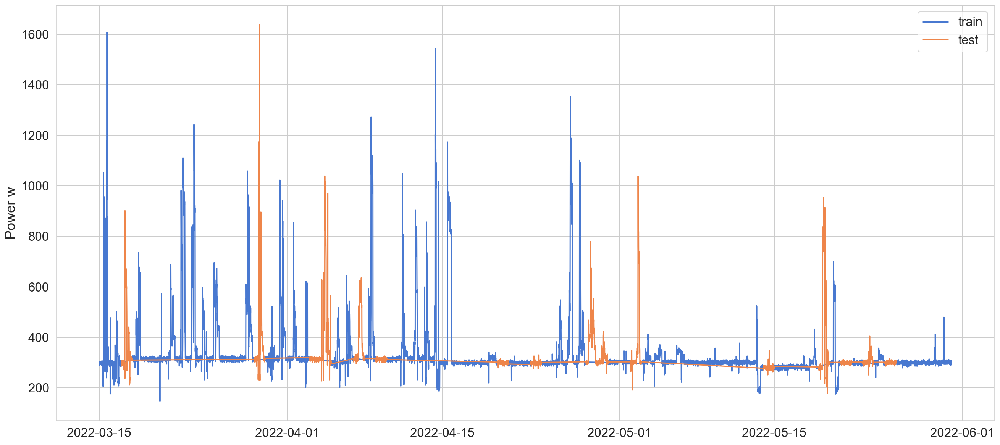

Back_fillMCAR40 ;mean; 0.639237904454049 ; 77.47025178163383 ; 84.19906275723456 ; 71.15470529754025 ; 74.74047281821895
Back_fillMCAR40 ;std; 0.014797430396432075 ; 1.108186308428107 ; 3.351694419275748 ; 0.8268017049628137 ; 5.047047037376001


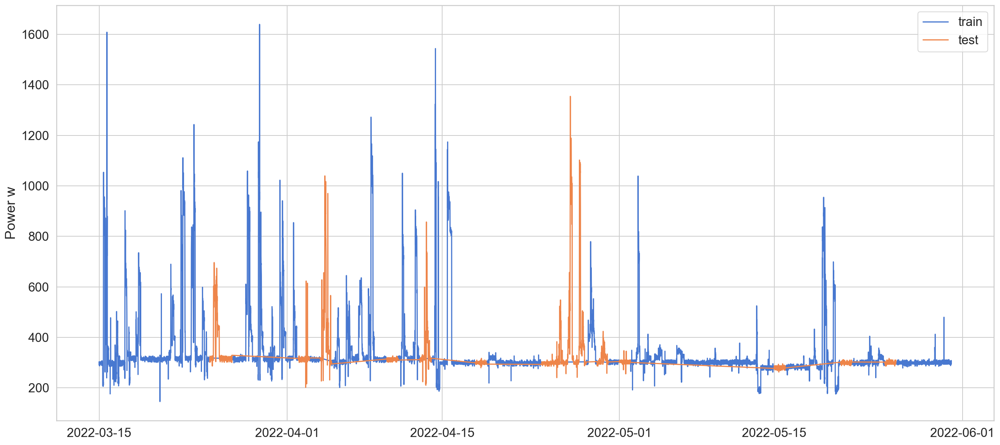

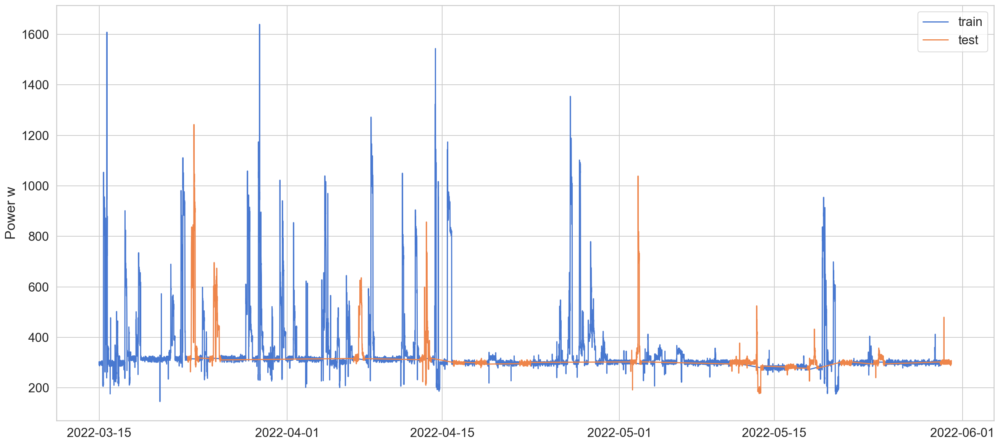

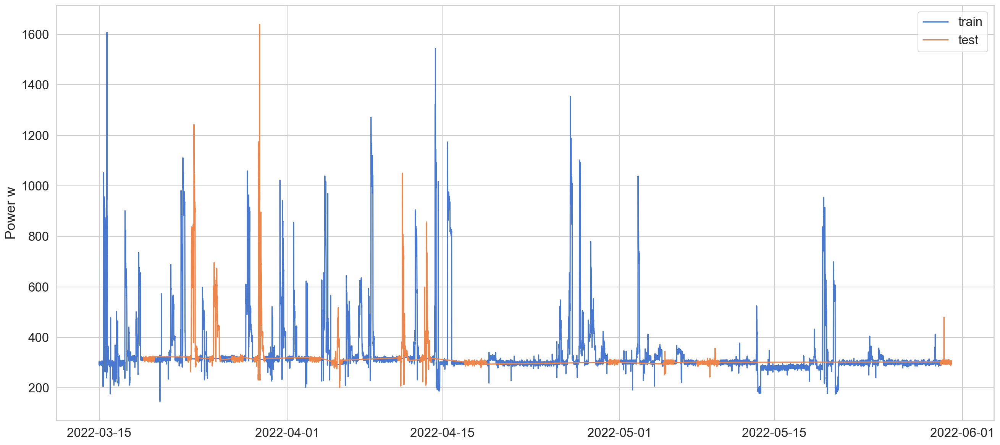

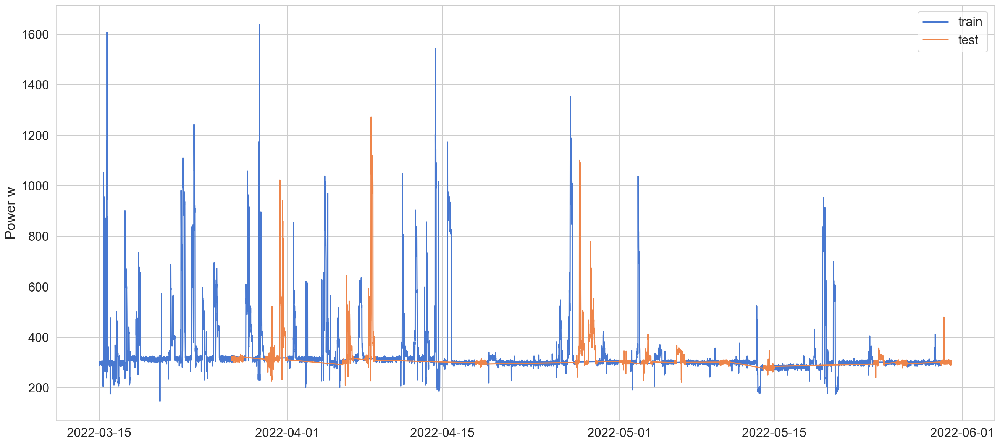

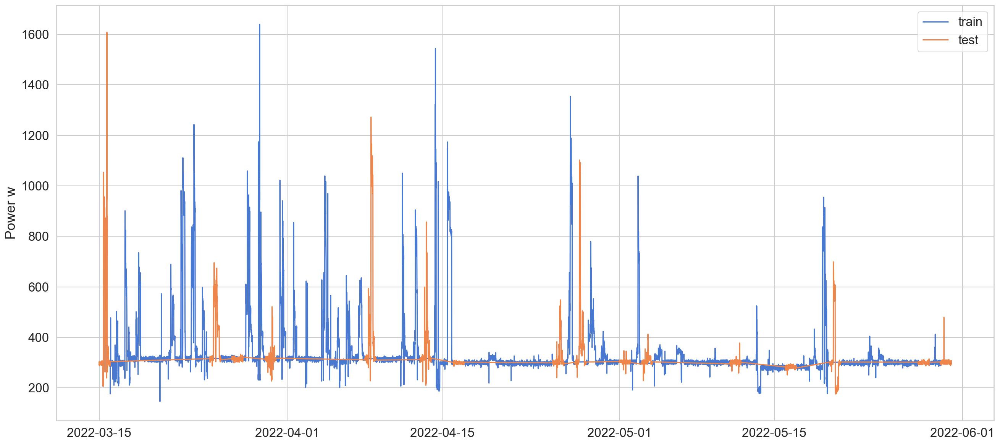

...

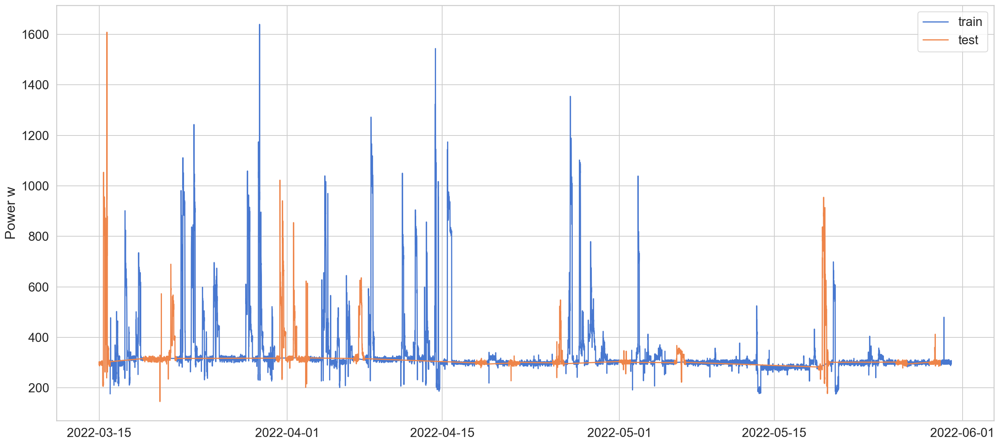

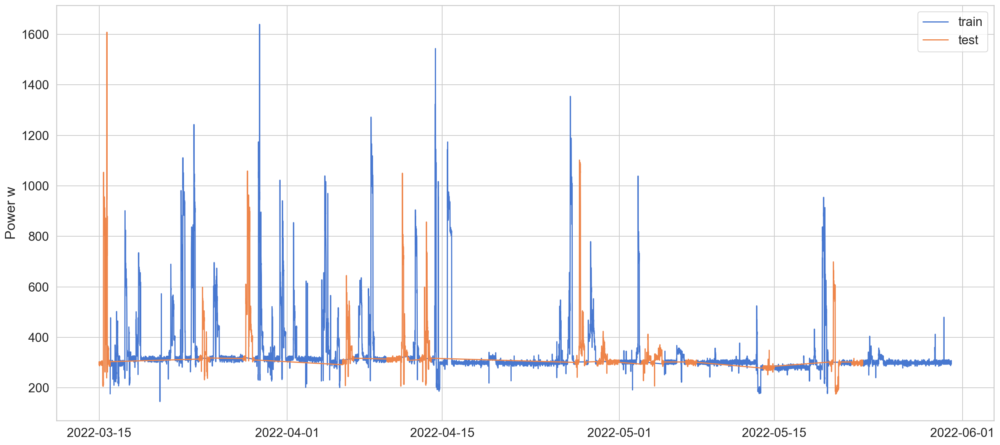

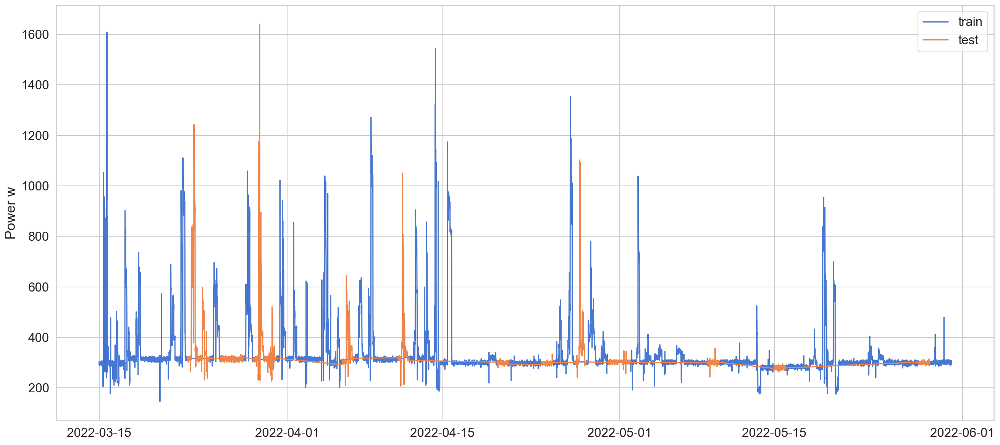

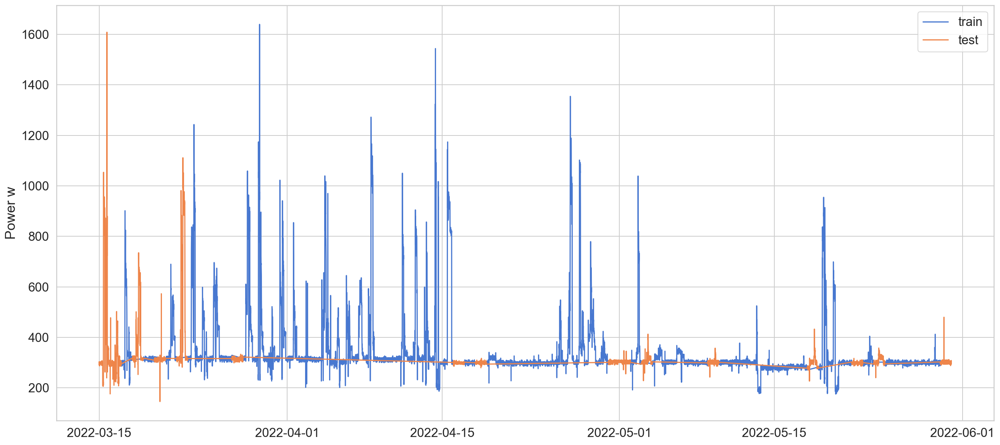

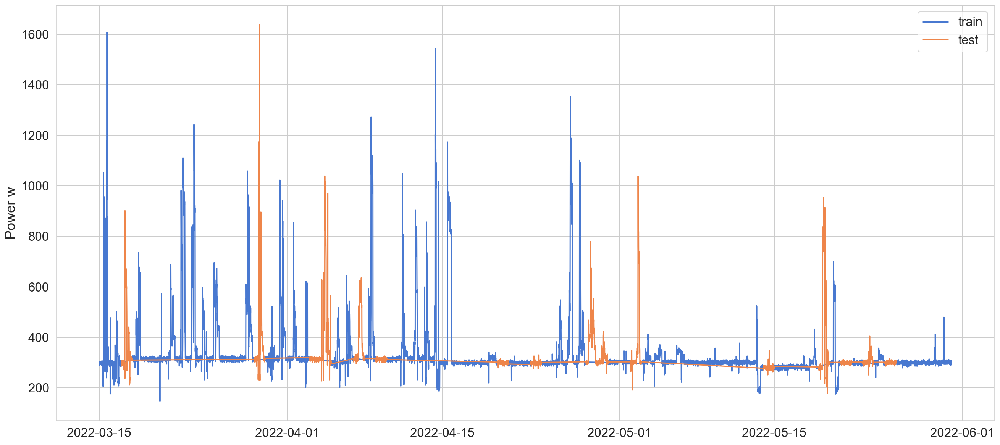

Back_fillMCAR60 ;mean; 0.6565142259649269 ; 75.6054284106002 ; 84.09607103744206 ; 72.06211161709136 ; 76.46829347486567
Back_fillMCAR60 ;std; 0.011292172219714975 ; 1.2300524291813308 ; 3.4535033958798396 ; 0.9068675270402625 ; 3.851183852476408


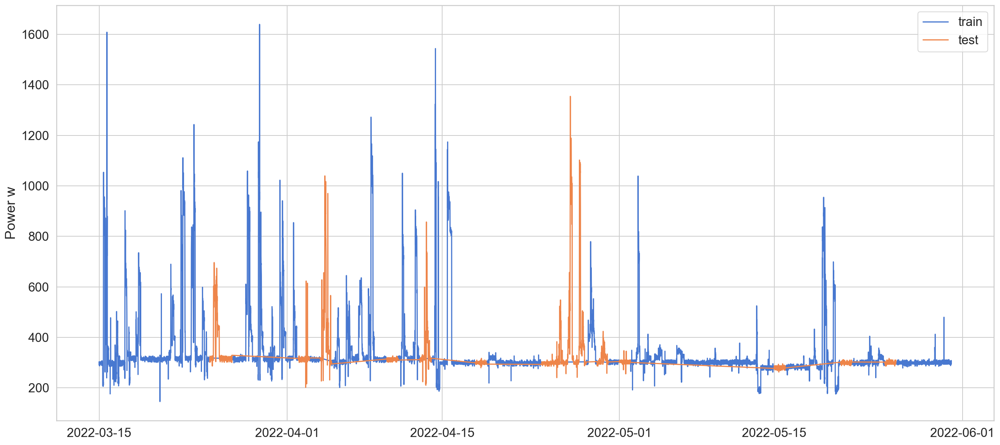

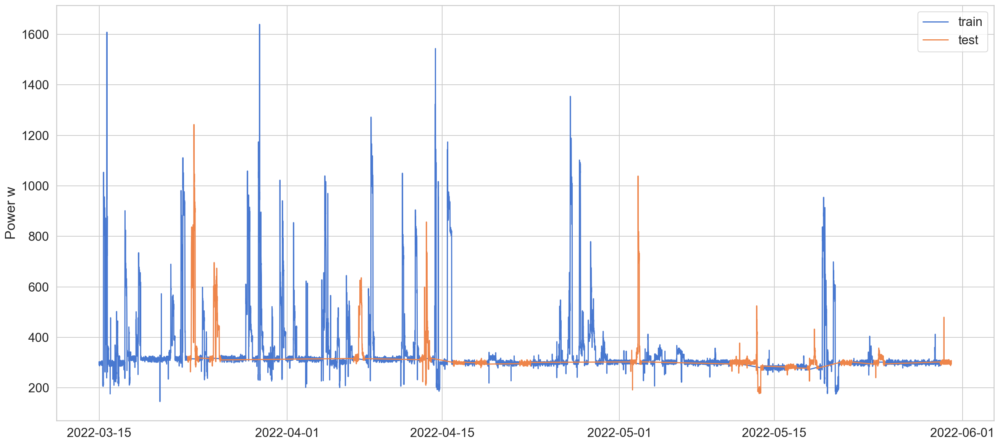

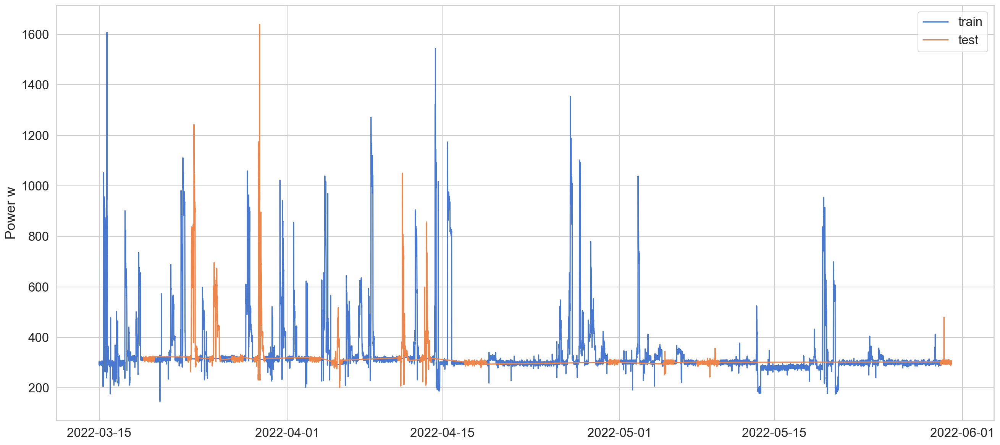

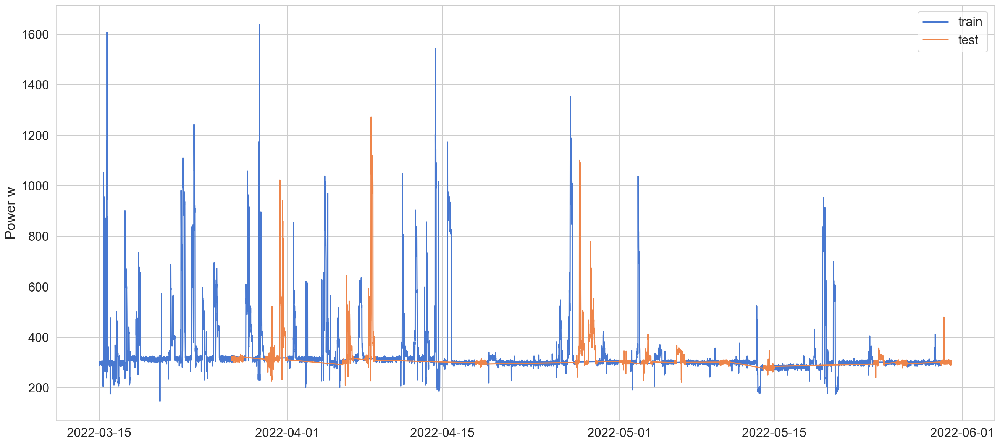

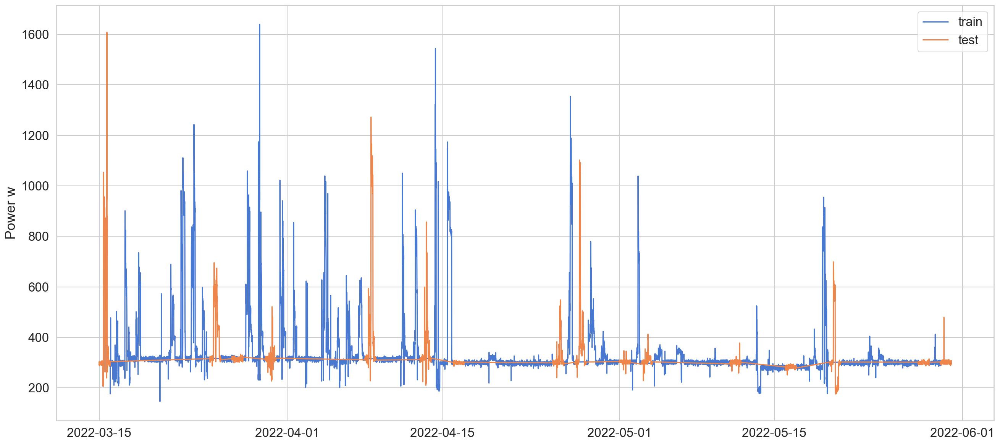

...

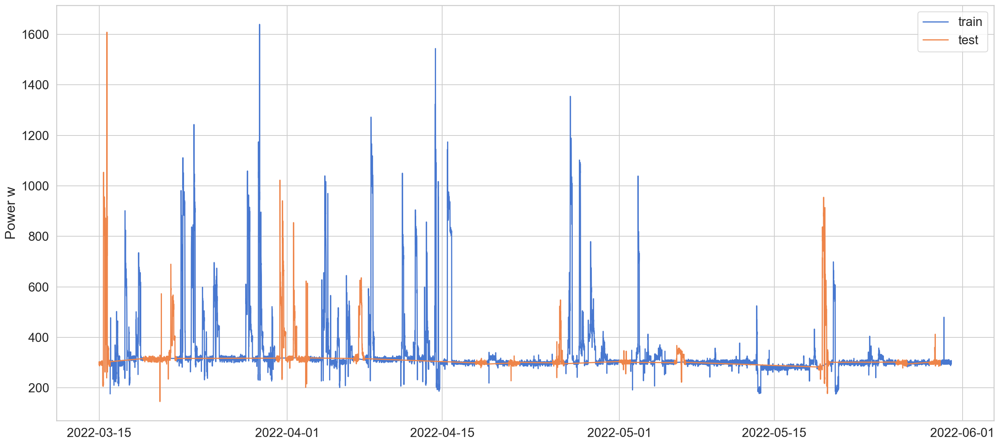

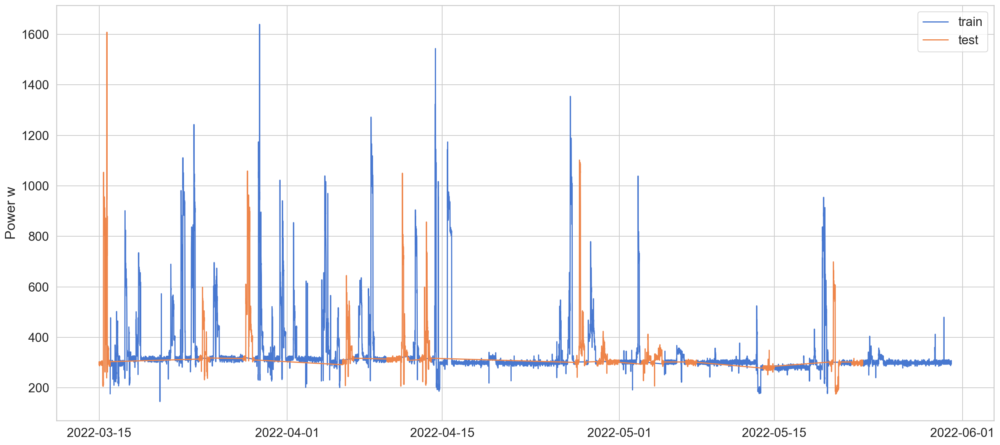

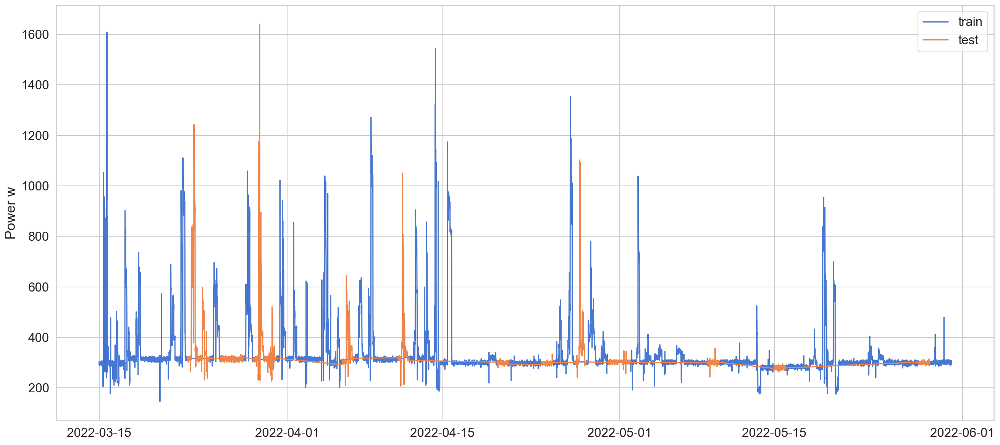

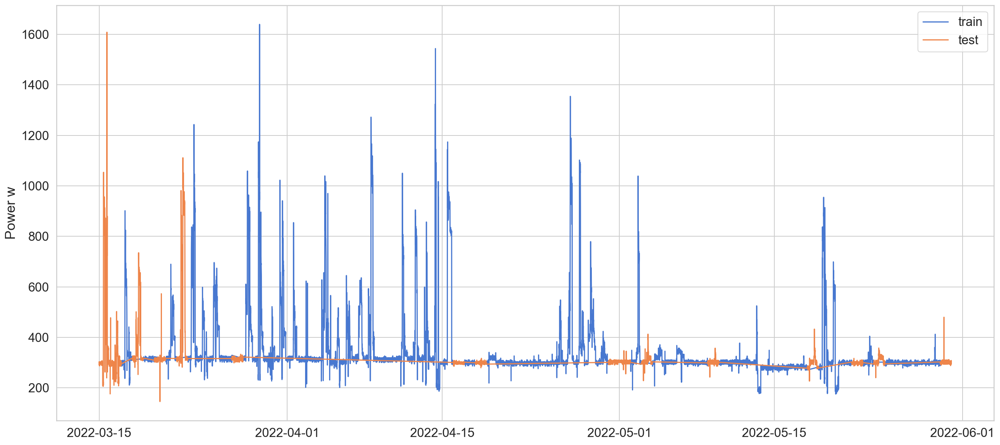

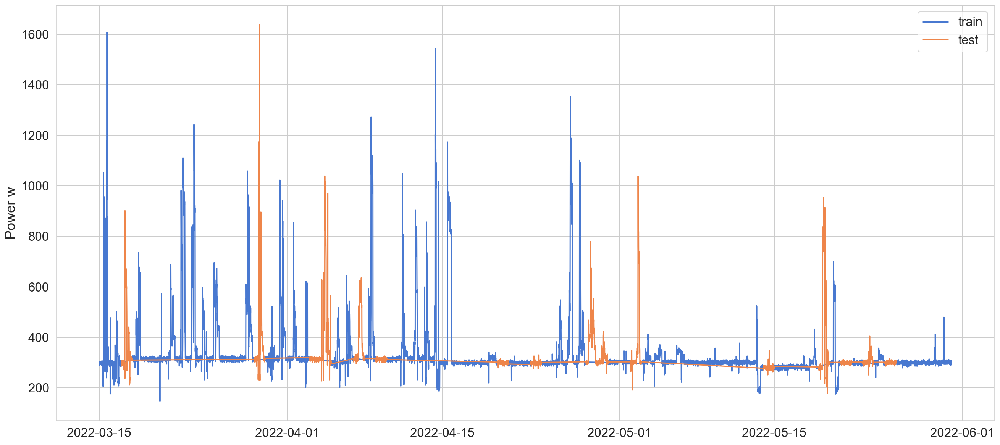

Back_fillMCAR70 ;mean; 0.671062416239229 ; 73.97251919009254 ; 82.3602157475281 ; 73.57138158116912 ; 77.22717228187527
Back_fillMCAR70 ;std; 0.014224897794200502 ; 1.1696621816286712 ; 4.099632703528776 ; 0.7638070308747457 ; 4.3383869266362955


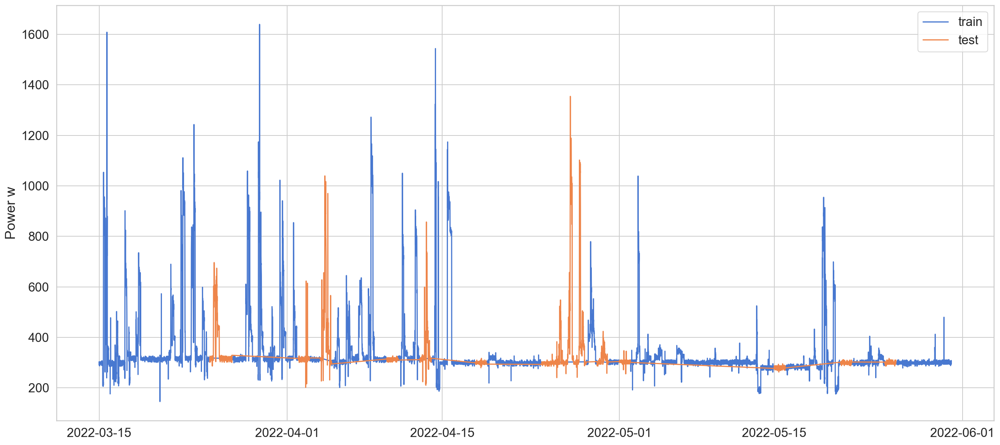

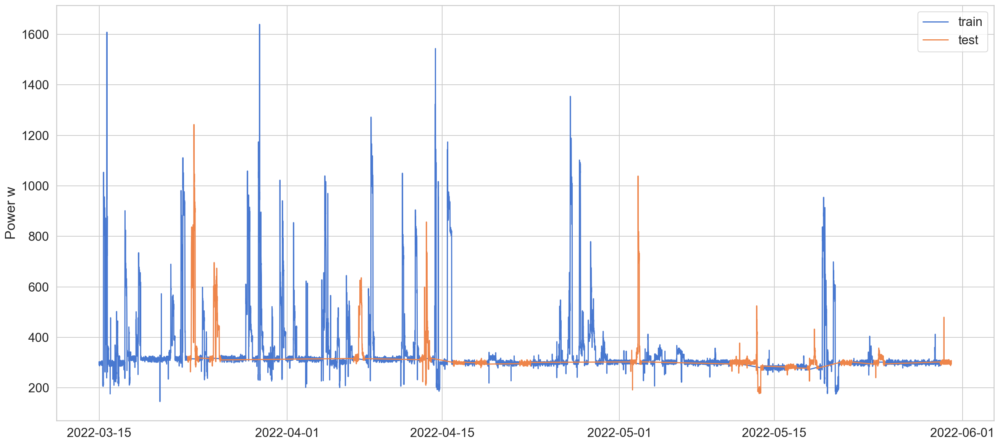

KeyboardInterrupt: 

In [8]:
## last 01 seed10time
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn import svm
from sklearn.svm import SVR
import random
import time
from matplotlib.pyplot import figure

# figure(figsize=(12, 8), dpi=80)


#Timedelta('76 days 23:55:00')
def ts_train_test_split(X,y,test_size=0.35,random_state=42, shuffle=True, filtre = False, limite = 0):
    
    Xtemp, ytemp = X.copy(), y.copy()
    a= X.index - X.index[0]
    a= a.days
    Xtemp['id']=a
    ytemp['id']=a
    from sklearn.model_selection import train_test_split
    indices_train, indices_test=train_test_split(a.unique(), test_size=test_size,random_state=random_state, shuffle=shuffle)
    # print(indices_test)
    X_train = Xtemp[Xtemp['id'].isin(indices_train.values)]
    X_test = Xtemp[Xtemp['id'].isin(indices_test.values)]
    y_train = ytemp[ytemp['id'].isin(indices_train.values)]
    y_test = ytemp[ytemp['id'].isin(indices_test.values)]
   
    ####
    if filtre:
        c=y_test.groupby('id').max()>limite
        X_test = X_test.loc[y_test['id'].isin(c.index[c["elecWithoutEclairage"]])]
        y_test = y_test.loc[y_test['id'].isin(c.index[c["elecWithoutEclairage"]])]


    X_train = X_train.drop(["id"], axis=1)
    X_test = X_test.drop(["id"], axis=1)
    y_train = y_train.drop(["id"], axis=1)
    y_test = y_test.drop(["id"], axis=1)
    # print(y_test)
    
    
    return X_train, X_test, y_train, y_test



import pandas as pd

#X=pd.read_csv("X_selected.csv", parse_dates=["date"], index_col="date")
y=pd.read_csv("y_selected.csv", parse_dates=["date"], index_col="date")
seeds=[183,627,152,442,891,766,891,279,362,110,116,513,405,87,717]
start = time.time()

import os
directory = "ImputedData"
print("BDD",";mean_std;","score",";","rmseTrain",";"," rmseTest",";","rmseTrainFE",";","rmseTestFE")
# seed = 30
test_size = 0.20

for filename in os.listdir(directory):   
    f = os.path.join(directory, filename)
    # checking if it is a file
    if os.path.isfile(f):
        x = filename
        x = '.'.join(x.split('.')[:-1])
        X=pd.read_csv(f, parse_dates=["date"], index_col="date")
        ###########
        # X["hour"]=X.index.hour+X.index.minute/60
        # X["weekday"]=X.index.weekday
        ###########
        # X=pd.read_csv("./ImputedData/A_dataComplet.csv", parse_dates=["date"], index_col="date")
        score_,rmseTrain_,rmseTest_,rmseTrainFE_,rmseTestFE_ = [],[],[],[],[]
        for seed in seeds:
             
            # seed = random.randint(0, 1000)
           
            X_train, X_test, y_train, y_test = ts_train_test_split(X,y,test_size=test_size,random_state=seed, shuffle=True)
            rfr = RandomForestRegressor(n_estimators = 100,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=30)
           
            plt.plot(y_train,label ="train")
            plt.plot(y_test,label ="test")
            plt.ylabel("Power w")
            plt.legend()
            plt.show()

            

            #y_train=y_train.values.ravel()
            rfr.fit(X_train, y_train.values.ravel())
            score = rfr.score(X_train, y_train.values.ravel())
            # print("R-squared:", score) 
            y_predTest = rfr.predict(X_test)
            y_predTrain = rfr.predict(X_train)
            rmseTest = mean_squared_error(y_test, y_predTest,squared=False)
            rmseTrain = mean_squared_error(y_train, y_predTrain,squared=False)
            # print(seed,";",rmseTest,";",rmseTrain )


            X_selectedFeatured, y_selectedFeatured =utilsLaris.FeatureExtraction(X,y, period = '30T')
            X_train, X_test, y_train, y_test = ts_train_test_split(X_selectedFeatured,y_selectedFeatured,test_size=test_size,random_state=seed, shuffle=True)
            rfr = RandomForestRegressor(n_estimators = 100,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=20)  
            # rfr = make_pipeline(StandardScaler(), SVR(C=1.0, epsilon=0.2))
            #y_train=y_train.values.ravel()
            rfr.fit(X_train, y_train.values.ravel())
            scoreFE = rfr.score(X_train, y_train.values.ravel())
            # print("R-squared:", score) 
            y_predTest= rfr.predict(X_test)
            y_predTrain= rfr.predict(X_train)
            rmseTestFE = mean_squared_error(y_test, y_predTest,squared=False)
            rmseTrainFE = mean_squared_error(y_train, y_predTrain,squared=False)
            score_.append(score)
            rmseTrain_.append(rmseTrain)
            rmseTest_.append(rmseTest)
            rmseTrainFE_.append(rmseTrainFE)
            rmseTestFE_.append(rmseTestFE)


        print(x,";mean;",np.mean(score_),";",np.mean(rmseTrain_),";", np.mean(rmseTest_),";",np.mean(rmseTrainFE_),";",np.mean(rmseTestFE_))
        print(x,";std;",np.std(score_),";",np.std(rmseTrain_),";", np.std(rmseTest_),";",np.std(rmseTrainFE_),";",np.std(rmseTestFE_))

end = time.time()
print(end - start)


In [ ]:
def tauxco2(X)
co2 = 300
taux = (X["co2_106"]>co2).sum()/y.shape[0]*100
print(co2,";", taux)
    
## last 01 seed10time
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
from sklearn import svm
from sklearn.svm import SVR
import random
import time
from matplotlib.pyplot import figure

# figure(figsize=(12, 8), dpi=80)


#Timedelta('76 days 23:55:00')
def ts_train_test_split(X,y,test_size=0.35,random_state=42, shuffle=True, filtre = False, limite = 0):
    
    Xtemp, ytemp = X.copy(), y.copy()
    a= X.index - X.index[0]
    a= a.days
    Xtemp['id']=a
    ytemp['id']=a
    from sklearn.model_selection import train_test_split
    indices_train, indices_test=train_test_split(a.unique(), test_size=test_size,random_state=random_state, shuffle=shuffle)
    # print(indices_test)
    X_train = Xtemp[Xtemp['id'].isin(indices_train.values)]
    X_test = Xtemp[Xtemp['id'].isin(indices_test.values)]
    y_train = ytemp[ytemp['id'].isin(indices_train.values)]
    y_test = ytemp[ytemp['id'].isin(indices_test.values)]
   
    ####
    if filtre:
        c=y_test.groupby('id').max()>limite
        X_test = X_test.loc[y_test['id'].isin(c.index[c["elecWithoutEclairage"]])]
        y_test = y_test.loc[y_test['id'].isin(c.index[c["elecWithoutEclairage"]])]


    X_train = X_train.drop(["id"], axis=1)
    X_test = X_test.drop(["id"], axis=1)
    y_train = y_train.drop(["id"], axis=1)
    y_test = y_test.drop(["id"], axis=1)
    # print(y_test)
    
    
    return X_train, X_test, y_train, y_test



import pandas as pd

#X=pd.read_csv("X_selected.csv", parse_dates=["date"], index_col="date")
y=pd.read_csv("y_selected.csv", parse_dates=["date"], index_col="date")
seeds=[183,627,152,442,891,766,891,279,362,110,116,513,405,87,717]
start = time.time()

import os
directory = "ImputedData"
print("BDD",";mean_std;","score",";","rmseTrain",";"," rmseTest",";","rmseTrainFE",";","rmseTestFE")
# seed = 30
test_size = 0.20

for filename in os.listdir(directory):   
    f = os.path.join(directory, filename)
    # checking if it is a file
    if os.path.isfile(f):
        x = filename
        x = '.'.join(x.split('.')[:-1])
        X=pd.read_csv(f, parse_dates=["date"], index_col="date")
        ###########
        # X["hour"]=X.index.hour+X.index.minute/60
        # X["weekday"]=X.index.weekday
        ###########
        # X=pd.read_csv("./ImputedData/A_dataComplet.csv", parse_dates=["date"], index_col="date")
        score_,rmseTrain_,rmseTest_,rmseTrainFE_,rmseTestFE_ = [],[],[],[],[]
        for seed in seeds:
             
            # seed = random.randint(0, 1000)
           
            X_train, X_test, y_train, y_test = ts_train_test_split(X,y,test_size=test_size,random_state=seed, shuffle=True)
            rfr = RandomForestRegressor(n_estimators = 100,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=30)
           
            plt.plot(y_train,label ="train")
            plt.plot(y_test,label ="test")
            plt.ylabel("Power w")
            plt.legend()
            plt.show()

            

            #y_train=y_train.values.ravel()
            rfr.fit(X_train, y_train.values.ravel())
            score = rfr.score(X_train, y_train.values.ravel())
            # print("R-squared:", score) 
            y_predTest = rfr.predict(X_test)
            y_predTrain = rfr.predict(X_train)
            rmseTest = mean_squared_error(y_test, y_predTest,squared=False)
            rmseTrain = mean_squared_error(y_train, y_predTrain,squared=False)
            # print(seed,";",rmseTest,";",rmseTrain )


            X_selectedFeatured, y_selectedFeatured =utilsLaris.FeatureExtraction(X,y, period = '30T')
            X_train, X_test, y_train, y_test = ts_train_test_split(X_selectedFeatured,y_selectedFeatured,test_size=test_size,random_state=seed, shuffle=True)
            rfr = RandomForestRegressor(n_estimators = 100,oob_score = True,n_jobs = -1, max_depth=5,max_features=0.33,min_samples_leaf=20)  
            # rfr = make_pipeline(StandardScaler(), SVR(C=1.0, epsilon=0.2))
            #y_train=y_train.values.ravel()
            rfr.fit(X_train, y_train.values.ravel())
            scoreFE = rfr.score(X_train, y_train.values.ravel())
            # print("R-squared:", score) 
            y_predTest= rfr.predict(X_test)
            y_predTrain= rfr.predict(X_train)
            rmseTestFE = mean_squared_error(y_test, y_predTest,squared=False)
            rmseTrainFE = mean_squared_error(y_train, y_predTrain,squared=False)
            score_.append(score)
            rmseTrain_.append(rmseTrain)
            rmseTest_.append(rmseTest)
            rmseTrainFE_.append(rmseTrainFE)
            rmseTestFE_.append(rmseTestFE)


        print(x,";mean;",np.mean(score_),";",np.mean(rmseTrain_),";", np.mean(rmseTest_),";",np.mean(rmseTrainFE_),";",np.mean(rmseTestFE_))
        print(x,";std;",np.std(score_),";",np.std(rmseTrain_),";", np.std(rmseTest_),";",np.std(rmseTrainFE_),";",np.std(rmseTestFE_))

end = time.time()
print(end - start)
    
    

In [ ]:
## first days as test data